# Insights for Stakeholders

- Introduce the stakeholder and their business problem that will be the guiding framework for this week's lessons.
- Identify the target and features for a machine learning model to use for insights
- Understand how different feature/target choices can provide a different spin/perspective on the problem.

## The Stakeholder

- We've been hired by a school district that wants to use data science to identify and support high school students at risk of poor performance.
- They have provided us with data on several hundred of their former students and want to identify students who are at risk of poor grades/performance by period 3.
    - The school included 3 periods of grades which are labeled as (G1-G3).
    - They sent us an excel file with 3 sheets:
        - student-mat: grades for Math (the student-mat sheet)
        - student-por: grades for Portuguese
        - README: data dictionary
- The goal is to identify at-risk students and provide additional support/tutoring to improve their academic performance.

### Our Task

- Develop machine-learning models to predict student performance in their final period (period 3).
- We will then use our model(s) to extract insights into which students are most at-risk for poor performance.
- We will provide a summary of our findings and 3 recommendations to the school on how to best identify these at-risk students.

We will be focusing on the Portuguese grades to start.


### Stakeholder Considerations

- Before diving into modeling, let's examine the data the school district has provided us, and let's brainstorm/discuss our approach for our models.

In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

## Using pd.set_option to display more columns
pd.set_option('display.max_columns',50)


The original files are from the UCI Machine Learning Archive and were split into several CSV's. For convenience, we have repackaged the data as multiple sheets in one Excel file. Since our Excel workbook has multiple worksheets, we can specify that we are interested in the student info related to their grades in Portuguese. Notice that we specify the worksheet name ('student-por') when we read in the data. 

https://archive.ics.uci.edu/dataset/320/student+performance

In [2]:
url = "https://docs.google.com/spreadsheets/d/e/2PACX-1vS6xDKNpWkBBdhZSqepy48bXo55QnRv1Xy6tXTKYzZLMPjZozMfYhHQjAcC8uj9hQ/pub?output=xlsx"
df = pd.read_excel(url,sheet_name='student-por')
df.info()
df.head()



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 649 entries, 0 to 648
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   school      649 non-null    object
 1   sex         649 non-null    object
 2   age         649 non-null    int64 
 3   address     649 non-null    object
 4   famsize     649 non-null    object
 5   Pstatus     649 non-null    object
 6   Medu        649 non-null    int64 
 7   Fedu        649 non-null    int64 
 8   Mjob        649 non-null    object
 9   Fjob        649 non-null    object
 10  reason      649 non-null    object
 11  guardian    649 non-null    object
 12  traveltime  649 non-null    int64 
 13  studytime   649 non-null    int64 
 14  failures    649 non-null    int64 
 15  schoolsup   649 non-null    object
 16  famsup      649 non-null    object
 17  paid        649 non-null    object
 18  activities  649 non-null    object
 19  nursery     649 non-null    object
 20  higher    

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,4,0,11,11
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,2,9,11,11
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,0,yes,no,no,no,yes,yes,yes,no,4,3,2,2,3,3,6,12,13,12
3,GP,F,15,U,GT3,T,4,2,health,services,home,mother,1,3,0,no,yes,no,yes,yes,yes,yes,yes,3,2,2,1,1,5,0,14,14,14
4,GP,F,16,U,GT3,T,3,3,other,other,home,father,1,2,0,no,yes,no,no,yes,yes,no,no,4,3,2,1,2,5,0,11,13,13


PANDAS OPTIONS AND SETTINGS:  https://pandas.pydata.org/docs/user_guide/options.html

**Attributes for both student-mat.csv (Math course) and student-por.csv (Portuguese language course) datasets:**

1 school - student's school (binary: 'GP' - Gabriel Pereira or 'MS' - Mousinho da Silveira)

2 sex - student's sex (binary: 'F' - female or 'M' - male)

3 age - student's age (numeric: from 15 to 22)

4 address - student's home address type (binary: 'U' - urban or 'R' - rural)

5 famsize - family size (binary: 'LE3' - less or equal to 3 or 'GT3' - greater than 3)

6 Pstatus - parent's cohabitation status (binary: 'T' - living together or 'A' - apart)

7 Medu - mother's education (numeric: 0 - none,  1 - primary education (4th grade), 2 â€“ 5th to 9th grade, 3 â€“ secondary education or 4 â€“ higher education)

8 Fedu - father's education (numeric: 0 - none,  1 - primary education (4th grade), 2 â€“ 5th to 9th grade, 3 â€“ secondary education or 4 â€“ higher education)

9 Mjob - mother's job (nominal: 'teacher', 'health' care related, civil 'services' (e.g. administrative or police), 'at_home' or 'other')

10 Fjob - father's job (nominal: 'teacher', 'health' care related, civil 'services' (e.g. administrative or police), 'at_home' or 'other')

11 reason - reason to choose this school (nominal: close to 'home', school 'reputation', 'course' preference or 'other')

12 guardian - student's guardian (nominal: 'mother', 'father' or 'other')

13 traveltime - home to school travel time (numeric: 1 - <15 min., 2 - 15 to 30 min., 3 - 30 min. to 1 hour, or 4 - >1 hour)

14 studytime - weekly study time (numeric: 1 - <2 hours, 2 - 2 to 5 hours, 3 - 5 to 10 hours, or 4 - >10 hours)

15 failures - number of past class failures (numeric: n if 1<=n<3, else 4)

16 schoolsup - extra educational support (binary: yes or no)

17 famsup - family educational support (binary: yes or no)

18 paid - extra paid classes within the course subject (Math or Portuguese) (binary: yes or no)

19 activities - extra-curricular activities (binary: yes or no)

20 nursery - attended nursery school (binary: yes or no)

21 higher - wants to take higher education (binary: yes or no)

22 internet - Internet access at home (binary: yes or no)

23 romantic - with a romantic relationship (binary: yes or no)

24 famrel - quality of family relationships (numeric: from 1 - very bad to 5 - excellent)

25 freetime - free time after school (numeric: from 1 - very low to 5 - very high)

26 goout - going out with friends (numeric: from 1 - very low to 5 - very high)

27 Dalc - workday alcohol consumption (numeric: from 1 - very low to 5 - very high)

28 Walc - weekend alcohol consumption (numeric: from 1 - very low to 5 - very high)

29 health - current health status (numeric: from 1 - very bad to 5 - very good)

30 absences - number of school absences (numeric: from 0 to 93)



-  these grades are related with the course subject, Math or Portuguese:

31 G1 - first period grade (numeric: from 0 to 20)

31 G2 - second period grade (numeric: from 0 to 20)

32 G3 - final grade (numeric: from 0 to 20, output target)

### Data Overview

- We need to get an overview of this dataset, and we'd like to get it quickly. While it is good practice to manually perform the EDA steps, we can also leverage additional tools/packages for quick dataset inspection. This custom function provides a quick summary of the data.

In [3]:
def summarize_df(df_):
    df = df_.copy()
    report = pd.DataFrame({
                        'dtype':df.dtypes,
                        '# null': df.isna().sum(),
                        'null (%)': df.isna().sum()/len(df)*100,
                        'nunique':df.nunique(),
                        "min":df.min(),
                        'max':df.max()
             })
    report.index.name='Column'
    return report.reset_index()
summarize_df(df)



,Column,dtype,# null,null (%),nunique,min,max
0,school,object,0,0.0,2,GP,MS
1,sex,object,0,0.0,2,F,M
2,age,int64,0,0.0,8,15,22
3,address,object,0,0.0,2,R,U
4,famsize,object,0,0.0,2,GT3,LE3
5,Pstatus,object,0,0.0,2,A,T
6,Medu,int64,0,0.0,5,0,4
7,Fedu,int64,0,0.0,5,0,4
8,Mjob,object,0,0.0,5,at_home,teacher
9,Fjob,object,0,0.0,5,at_home,teacher


### Exploring Our Target

- The stakeholder wants to identify students who are at risk of failing G3.
- "G1","G2","G3" are the students' final scores at the end of periods 1-3.
- The first approach we will take is to treat this as a regression task, with the numerical score of G3 as our target.
    - This would allow us to predict the exact final grade of each student.
- Later this week we will modify our target to a classification task by creating an "at-risk" classification column based on grades. We can then leverage additional model explanation tools to understand which features make a student more likely to underperform.


### Considerations of G1 and G2

Another consideration is whether or not to include G1 and G2 as features. Let's consider our stakeholder's needs:

- If we include G1 and G2, we will likely have better predictions for G3, however
- Our stakeholders would like to be able to make predictions before it is too late to provide appropriate interventions to those who will need them. To make these predictions earlier, our model would need to make predictions BEFORE G1 and G2 grades are known.

Throughout the week, we will develop models both with and without G1 and G2 scores included as features.


### Overview of the week:

There are several approaches available to us for modeling-based insights.

**An overview of our tasks this week includes the following:**

- Use tree-based regression models for Feature Importance.
    - Which features are the most helpful for predicting grades? (built-in importance)
    - Which features damage the model's performance the most when shuffled? (permutation importance).
- Use a Linear Regression to extract coefficients.
    - Unscaled: exact effect on the final grade of each feature.
    - Scaled: features that are the most important for the final grade.
- We will also demonstrate the conversion of this regression problem to a classification problem
- Use tree-based classification models for feature importance
- Use a logistic regression model to extract coefficients
    - Convert logistic regression coefficients from log odds to odds and interpret them
- Introduce advanced model explainers (SHAP and LIME)
    - Global explanations (entire data set)
    - Local explanations (individual observations)
- Throughout the week will be creating and interpreting many plots.
    - We will explore some advanced techniques for customizing these visuals. 


### Customizing Our Plots

Throughout the week, we will be creating many visuals, and we have customized our options. To achieve the same style as you will see on the learn platform, you can use the code below. Alternatively, we suggest you experiment with changing the options and making your own stylistic choices.

You can use this repository to test out your own options and select your personal visualization aesthetic. https://github.com/coding-dojo-data-science/data-viz-choosing-your-own-style

In [4]:
## Customization Options
plt.style.use(('ggplot','tableau-colorblind10'))
sns.set_context(context='notebook', font_scale= 1.2)
plt.rcParams['savefig.transparent'] = False
plt.rcParams['savefig.bbox'] = 'tight'
plt.rcParams['figure.facecolor']='white'



### EDA

- Before we dive into modeling, let's take a moment for some EDA visualizations to help us get a sense of our target.

#### Visualizing Grades

In [5]:
import warnings
warnings.filterwarnings("ignore")

Text(0.5, 1.0, 'Distribution of Final Grades')

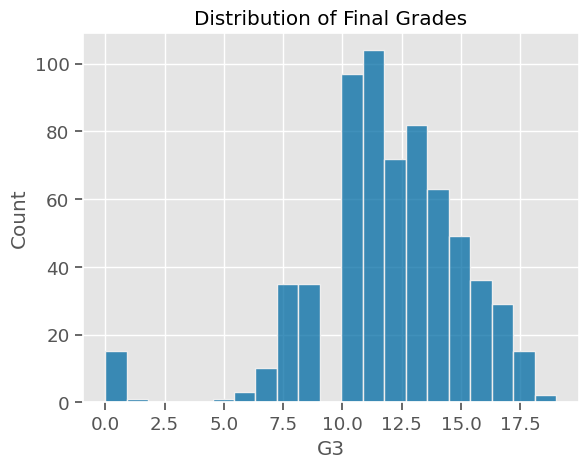

In [6]:
ax = sns.histplot(data=df,x='G3');
ax.set_title("Distribution of Final Grades")


### Summary

This lesson introduced the stakeholder problem that we will be exploring throughout this week and provided an overview of the processes we will learn this week to gain insights into our model. We did some light EDA to get acquainted with our target values. We are ready to get started!


## Scikit-Learn v1.1+

Learning Objectives:

- Recognize differences in the new version of sklearn
- Use Scikit-Learn v1.1's simplified toolkit.

### Improved Scikit-Learn Version

- In this stack, we will be focusing on extracting insights from our models: both by examining parameters/aspects of the model itself, like the coefficients it calculated, but also by applying some additional tools and packages specifically designed to explain models.
- Scikit-learn recently released version 1.1, adding several helpful tools to simplify our workflow. Specifically, it will make it much easier to extract all of our feature names after processing. This will make it easier to visualize and interpret the insights our models can provide.
- Let's review some of the key differences using sklearn v1.1!

#### Confirming Package Versions

- All packages have a version number that indicates which iteration of the package is currently being used.
    - If you import an entire package, you can use the special method package.__version__ (replace package with the name of the package you want to check).
- The reason this is important is that as of the writing of this stack, Google Colab is still using a version of Python that is too old to support the newest version of scikit-learn.
    - You can check which version of python you are using by running the following command in a Jupyter Notebook:
        - !python --version
        - Note: if you remove the !, you can run this command in your terminal.
- If you run the following code on Google Colab and your local computer, you can compare the version numbers.

**Now, run the following block of code in a Jupyter Notebook on your local machine to confirm that you have Python 3.8.13 and sklearn v1.1.3.**

In [7]:
# Run the following command on your local computer to check the version of sklearn
import sklearn
!python --version
print(f"sklearn version: {sklearn.__version__}")



Python 3.9.15
sklearn version: 1.2.2


### Highlighted Changes - scikit-learn v1.1

- The single biggest change in the updated sklearn is a fully-functional .get_feature_names_out() method in the ColumnTransformer.
    - This will make it MUCH easier for us to extract our transformed data as DataFrames and to match up the feature names to our models' coefficients.
- A sklearn-wide change that you may notice is that our models and preprocessing tools look much nicer than they used to! Sklearn used to use text-based representations for its objects, but it has switched to "diagram" based representations by default.

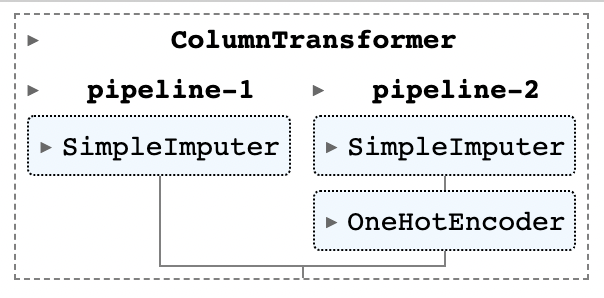

- Note: if you'd like to see diagram representations on Google Colab, you can use the same function to activate them, just change `display="text"` to `display="diagram"`
- There are some additional updates that are not pertinent to this stack, but if you are curious, you can find the details on the new release here.

### Preprocessing with Sklearn V1.1

- Thankfully, none of our sklearn imports have changed, just some of the features of the tools we use.

In [8]:
## Our standard imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns



In [9]:
## Preprocessing tools
from sklearn.model_selection import train_test_split
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
## Models & evaluation metrics
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
import joblib
## setting random state for reproducibility
SEED = 321
np.random.seed(SEED)
## set pandas to display more columns
pd.set_option('display.max_columns',50)



The original files are from the UCI Machine Learning Archive and were split into several CSV's. For convenience, we have repackaged the data as multiple sheets in one Excel file. Since our excel sheet has multiple worksheets, we can specify that we are interested in the student info related to their grades in Portuguese. Notice that we specify the worksheet name ('student-por') when we read in the data. 

In [10]:
## Load in the student performance - portuguese dataset & display the head and info
url = "https://docs.google.com/spreadsheets/d/e/2PACX-1vS6xDKNpWkBBdhZSqepy48bXo55QnRv1Xy6tXTKYzZLMPjZozMfYhHQjAcC8uj9hQ/pub?output=xlsx"
df = pd.read_excel(url,sheet_name='student-por')
df.info()
df.head(3)



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 649 entries, 0 to 648
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   school      649 non-null    object
 1   sex         649 non-null    object
 2   age         649 non-null    int64 
 3   address     649 non-null    object
 4   famsize     649 non-null    object
 5   Pstatus     649 non-null    object
 6   Medu        649 non-null    int64 
 7   Fedu        649 non-null    int64 
 8   Mjob        649 non-null    object
 9   Fjob        649 non-null    object
 10  reason      649 non-null    object
 11  guardian    649 non-null    object
 12  traveltime  649 non-null    int64 
 13  studytime   649 non-null    int64 
 14  failures    649 non-null    int64 
 15  schoolsup   649 non-null    object
 16  famsup      649 non-null    object
 17  paid        649 non-null    object
 18  activities  649 non-null    object
 19  nursery     649 non-null    object
 20  higher    

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,4,0,11,11
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,2,9,11,11
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,0,yes,no,no,no,yes,yes,yes,no,4,3,2,2,3,3,6,12,13,12


### Selecting Our Features

- If we wanted to make recommendations to the school district on how to identify and help students that will perform poorly by period 3, we should think about what features make the most sense to include.
- There are 2 main approaches we could use, depending on what use case we are addressing for our stakeholders.

1) For example, if our primary goal is to just identify 3rd period students that will perform poorly, then including G1 and G2 would make sense.

2) However, if our primary goal is to identify which INCOMING students will perform poorly by their 3rd period, then we would NOT include G1 or G2, since the school will not have those grades for brand new incoming students.

- We will start our analysis by addressing the first use case, identifying 3rd period students that will perform poorly, so we will include G1 and G2.

### Train Test Split

In [11]:
## Make x and y variables
y = df['G3'].copy()
X = df.drop(columns=['G3']).copy()
## train-test-split with random state for reproducibility
X_train, X_test, y_train, y_test = train_test_split(X,y, random_state=SEED)
X_train.head()



,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2
54,GP,F,15,U,LE3,A,3,3,other,other,other,mother,1,1,0,no,no,no,no,yes,yes,yes,no,5,3,4,4,4,1,0,13,12
208,GP,M,16,U,GT3,T,2,3,other,other,home,father,2,1,0,no,no,no,no,yes,yes,yes,no,5,3,3,1,1,3,0,13,12
23,GP,M,16,U,LE3,T,2,2,other,other,reputation,mother,2,2,0,no,yes,no,yes,yes,yes,yes,no,5,4,4,2,4,5,2,10,10
547,MS,M,16,R,LE3,T,4,1,other,at_home,other,father,1,1,0,no,no,no,no,yes,yes,yes,no,4,1,2,2,1,2,0,10,11
604,MS,F,18,U,GT3,T,1,1,at_home,services,course,mother,3,2,1,no,no,no,no,yes,no,no,no,4,4,2,1,2,2,2,9,10


### Preprocessing + ColumnTransformer

In [12]:
## make categorical selector and verify it works 
cat_sel = make_column_selector(dtype_include='object')
cat_sel(X_train)



['school',
 'sex',
 'address',
 'famsize',
 'Pstatus',
 'Mjob',
 'Fjob',
 'reason',
 'guardian',
 'schoolsup',
 'famsup',
 'paid',
 'activities',
 'nursery',
 'higher',
 'internet',
 'romantic']

In [13]:
## make numeric selector and verify it works 
num_sel = make_column_selector(dtype_include='number')
num_sel(X_train)



['age',
 'Medu',
 'Fedu',
 'traveltime',
 'studytime',
 'failures',
 'famrel',
 'freetime',
 'goout',
 'Dalc',
 'Walc',
 'health',
 'absences',
 'G1',
 'G2']

In [14]:
## make pipelines for categorical vs numeric data
cat_pipe = make_pipeline(SimpleImputer(strategy='constant', fill_value='MISSING'),
                         OneHotEncoder(handle_unknown='ignore', sparse=False))
num_pipe = make_pipeline(SimpleImputer(strategy='mean'))



**Note: So far, all of the code should be familiar to you. The changes we will make due to our new version of sklearn will be when we create our ColumnTransformer with make_column_transformer.**

- From now on, you should add verbose_feature_names_out=False to make_column_transformer. (If you want to see what the verbose version looks like feel free to give it a try!) 

In [15]:
## make the preprocessing column transformer
preprocessor = make_column_transformer((num_pipe, num_sel),
                                       (cat_pipe,cat_sel),                                      
                                       verbose_feature_names_out=False)
preprocessor



ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer())]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x00000199D6FE5A60>),
                                ('pipeline-2',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(fill_value='MISSING',
                                                                strategy='constant')),
                                                 ('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x00000199D6EC2F40>)],
                  verbose_feature_names_out=False)

 To extract the feature names from the preprocessor,

- We first have to fit it on the data.
- Next, we can use the new preprocessor.get_feature_names_out() method and save the output as something like "feature_names" or "final_features".

In [16]:
## fit column transformer and run get_feature_names_out
preprocessor.fit(X_train)
feature_names = preprocessor.get_feature_names_out()
feature_names



array(['age', 'Medu', 'Fedu', 'traveltime', 'studytime', 'failures',
       'famrel', 'freetime', 'goout', 'Dalc', 'Walc', 'health',
       'absences', 'G1', 'G2', 'school_GP', 'school_MS', 'sex_F', 'sex_M',
       'address_R', 'address_U', 'famsize_GT3', 'famsize_LE3',
       'Pstatus_A', 'Pstatus_T', 'Mjob_at_home', 'Mjob_health',
       'Mjob_other', 'Mjob_services', 'Mjob_teacher', 'Fjob_at_home',
       'Fjob_health', 'Fjob_other', 'Fjob_services', 'Fjob_teacher',
       'reason_course', 'reason_home', 'reason_other',
       'reason_reputation', 'guardian_father', 'guardian_mother',
       'guardian_other', 'schoolsup_no', 'schoolsup_yes', 'famsup_no',
       'famsup_yes', 'paid_no', 'paid_yes', 'activities_no',
       'activities_yes', 'nursery_no', 'nursery_yes', 'higher_no',
       'higher_yes', 'internet_no', 'internet_yes', 'romantic_no',
       'romantic_yes'], dtype=object)

- Notice how we were able to get the complete list of feature names, including the One Hot Encoded features with their proper suffixes. For example, the original feature 'internet' has been one hot encoded and the new columns are 'internet_no' and 'internet_yes'. 


### Remaking Our X_train and X_test as DataFrames with the New Feature Names

- Now that we have our list of feature names, we can very easily transform our X_train and X_test into preprocessed DataFrames.
- We can immediately turn the output of our preprocessor into a data frame and do not need to save it as a separate variable first.
    - Therefore, in our pd.DataFrame, we will provide the preprocessor.transform(X_train) as the first argument, followed by columns=feature_names (the list we extracted from our preprocessor)
    - Pro Tip: you can also use the same index as your X_train or X_test variable if you want to match up one of the transformed rows with the original DataFrame.

Here we create a preprocessed DataFrame for our training set.

In [17]:
X_train_df = pd.DataFrame(preprocessor.transform(X_train),
                           columns = feature_names, index = X_train.index)
X_train_df.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_no,schoolsup_yes,famsup_no,famsup_yes,paid_no,paid_yes,activities_no,activities_yes,nursery_no,nursery_yes,higher_no,higher_yes,internet_no,internet_yes,romantic_no,romantic_yes
54,15.0,3.0,3.0,1.0,1.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,0.0,13.0,12.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
208,16.0,2.0,3.0,2.0,1.0,0.0,5.0,3.0,3.0,1.0,1.0,3.0,0.0,13.0,12.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
23,16.0,2.0,2.0,2.0,2.0,0.0,5.0,4.0,4.0,2.0,4.0,5.0,2.0,10.0,10.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0


In [18]:
# Now we create a preprocessed DataFrame for our test set.

X_test_df = pd.DataFrame(preprocessor.transform(X_test),
                           columns = feature_names, index = X_test.index)
X_test_df.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_no,schoolsup_yes,famsup_no,famsup_yes,paid_no,paid_yes,activities_no,activities_yes,nursery_no,nursery_yes,higher_no,higher_yes,internet_no,internet_yes,romantic_no,romantic_yes
104,15.0,3.0,4.0,1.0,2.0,0.0,5.0,4.0,4.0,1.0,1.0,1.0,0.0,16.0,16.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
284,18.0,2.0,1.0,1.0,1.0,2.0,3.0,2.0,5.0,2.0,5.0,5.0,4.0,7.0,8.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
579,18.0,1.0,3.0,1.0,1.0,0.0,4.0,3.0,3.0,2.0,3.0,3.0,0.0,9.0,10.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0


In [19]:
# verify that our X and y values are still matched correctly. 

## confirm the first 3 rows index in y_test matches X_test_df
y_test.head(3)



104    16
284     6
579     9
Name: G3, dtype: int64

### Summary

This lesson showcased a new version of sklearn. One update was the default settings for viewing your pipelines as the diagram instead of the original text representation. The most significant change, however, is the ability to easily pull out the feature names after preprocessing! The lesson also completed the preprocessing for the dataset we will be using in the next lessons, so make sure you have completed these steps before moving on.

## Feature Importance

- Explain what feature importance is, which models use it, and what it means.
- Visualize and construct recommendations using feature importance.
- Save visuals as variables using two methods.
- Plot trees to gain insight into feature importance.

### Feature Importance

- Several different types of feature-specific values are calculated by sklearn models which are either used to predict the outcome (like Linear Regression coefficients) or to explain which features the model uses the most.
- Tree-Based models (decision trees, random forests, xgboost, etc) can calculate what is called "feature importance".
- According to the Scikit-Learn RandomForest Documentation on Feature Importance:
    - "The importance of a feature is computed as the (normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance."
        - In other words, it's how helpful each feature was in growing/sorting the tree-based model. The more helpful a feature was in separating the data, the more "important" it is.

#### Tree-Based Models - Feature Importance

RandomForestRegressor

- Let's fit a default random forest regressor and get the r-squared value for the training and test data.
- We have a helpful custom function for regression evaluation below that we will use throughout this lesson.
    - It takes the model and the training and test X and y data.
    - It will calculate R-squared and RMSE for both and print the scores.

In [20]:
def evaluate_regression(model, X_train,y_train, X_test, y_test): 
    """Evaluates a scikit learn regression model using r-squared and RMSE"""
    
    ## Training Data
    y_pred_train = model.predict(X_train)
    r2_train = metrics.r2_score(y_train, y_pred_train)
    rmse_train = metrics.mean_squared_error(y_train, y_pred_train, 
                                            squared=False)
    
    print(f"Training Data:\tR^2= {r2_train:.2f}\tRMSE= {rmse_train:.2f}")
        
    
    ## Test Data
    y_pred_test = model.predict(X_test)
    r2_test = metrics.r2_score(y_test, y_pred_test)
    rmse_test = metrics.mean_squared_error(y_test, y_pred_test, 
                                            squared=False)
    
    print(f"Test Data:\tR^2= {r2_test:.2f}\tRMSE= {rmse_test:.2f}")


In [21]:
reg = RandomForestRegressor(random_state=SEED)
reg.fit(X_train_df,y_train)
evaluate_regression(reg, X_train_df, y_train, X_test_df, y_test)



Training Data:	R^2= 0.98	RMSE= 0.52
Test Data:	R^2= 0.83	RMSE= 1.26


- Now let's see which features our model used the most for predicting our target.

#### Extracting Feature Importances

- For tree-based models in scikit-learn, we can find the feature importances under the .feature_importances_ attribute.
- The .feature_importances_ is a NumPy array that should have the same number of values as the number of columns in X_train_df. 

In [22]:
reg.feature_importances_



array([9.06096804e-03, 4.27750617e-03, 3.98699965e-03, 7.00472751e-03,
       2.25626018e-03, 3.51399028e-03, 2.49268280e-03, 7.28098375e-03,
       5.16832208e-03, 7.96493073e-03, 3.65255869e-03, 3.45093237e-03,
       2.12456262e-02, 1.43357641e-02, 8.49691456e-01, 1.50552537e-03,
       1.34049006e-03, 8.01336123e-04, 2.00642049e-03, 9.16339891e-04,
       1.07877854e-03, 7.07605663e-04, 9.56989326e-04, 5.25321529e-04,
       3.57271546e-04, 7.24549353e-04, 4.69078763e-04, 1.72276703e-03,
       7.87754005e-04, 4.04612977e-03, 4.95701770e-04, 6.32101752e-04,
       2.02437914e-03, 2.64153718e-03, 2.88623322e-04, 1.66038340e-03,
       1.49827250e-03, 7.13793226e-03, 1.32903677e-03, 2.40072554e-03,
       1.19251978e-03, 6.59015769e-04, 1.29186344e-03, 1.17453508e-03,
       2.87137667e-03, 2.08767090e-03, 4.90905227e-04, 2.05326973e-04,
       6.07999604e-04, 6.08562065e-04, 1.09193794e-03, 1.09819114e-03,
       3.43745866e-04, 3.14073124e-04, 3.66951986e-04, 5.29971880e-04,
      

In [23]:
## Checking the number of feature importances matches the # of columns
print(len(reg.feature_importances_))
print(len(X_train_df.columns))
len(reg.feature_importances_) == len(X_train_df.columns)



58
58


True

### Saving the importances as a Pandas Series

- We can immediately turn the model's .feature_importances_ into a pd.Series to make it easier to work with.
    - Therefore, in our pd.Series, we will provide the reg.feature_importances_ as the first argument, followed by index=feature_names (instead of columns=feature_names as we would do with a pandas DataFrame because Pandas Series are 1D and do not have columns).
        - We also could use our X_train_df.columns to make our index, since they are the same as the feature_names
- (Optional) Adding a name.
    - Pandas will use the name as the axis label when plotting with a Series.

In [24]:
## Saving the feature importances
importances = pd.Series(reg.feature_importances_, index= feature_names,
                       name='Feature Importance')
importances



age                  0.009061
Medu                 0.004278
Fedu                 0.003987
traveltime           0.007005
studytime            0.002256
failures             0.003514
famrel               0.002493
freetime             0.007281
goout                0.005168
Dalc                 0.007965
Walc                 0.003653
health               0.003451
absences             0.021246
G1                   0.014336
G2                   0.849691
school_GP            0.001506
school_MS            0.001340
sex_F                0.000801
sex_M                0.002006
address_R            0.000916
address_U            0.001079
famsize_GT3          0.000708
famsize_LE3          0.000957
Pstatus_A            0.000525
Pstatus_T            0.000357
Mjob_at_home         0.000725
Mjob_health          0.000469
Mjob_other           0.001723
Mjob_services        0.000788
Mjob_teacher         0.004046
Fjob_at_home         0.000496
Fjob_health          0.000632
Fjob_other           0.002024
Fjob_servi

- As you can see, we now have a value for each feature used by our model.

    - the importances are all small values (below 1).
    - the importances sum up to 1 overall.

In [25]:
importances.sum()



0.9999999999999999

- Let's visualize the feature importances and then interpret what they are telling us.

### Visualizing Feature Importance

- Feature importances are always a positive value.
- There will be a subset of features with very high importances and a subset of features with very low importance.
- Let's try visualizing the values using a horizontal bar plot with Pandas.

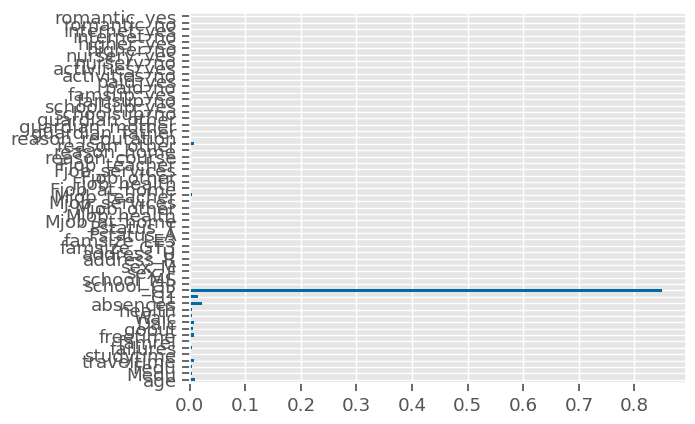

In [26]:
# plot importance
ax = importances.plot(kind='barh')


**Oh, no! As we can see above, visualizing all of our feature importances with the default visualization options generally does not work very well. Let's improve this plot by taking into account some of the issues. Remember that creating great visuals is often an iterative process. Take a look after each change to see how it improves!**

### Considerations for Plotting Importances

- Issues with our visualization:
    - Cannot read the feature names on the tick labels.
    - Only a handful of features have visible bars.
    - The bars that have similar importances are difficult to compare visually (which one is more important??)
    - The dimensions of the graph are not optimal.
    - And of course, we have no axis labels or title.

### Improving Our Visualization

- Let's visualize this again, but let's fix the issues we detailed above by:
    - Sorting our importances so that we plot them with the most important features on top.
    - Only plotting a subset of the most important features.
    Specifying a taller and narrower figsize.
    And of course: adding labels and title

**A Note on Plotting the Top N Sorted Values**

- We want to plot the 10 most important features
- Based on your experience with Pandas, you might start by trying sort_values with ascending=False to get the most important features on top, and then take the .head(10) and then use .plot().

In [27]:
## Saving the feature importances sorted from largest to smallest (ascending=False)
sorted_importance = importances.sort_values(ascending=False)
sorted_importance



G2                   0.849691
absences             0.021246
G1                   0.014336
age                  0.009061
Dalc                 0.007965
freetime             0.007281
reason_other         0.007138
traveltime           0.007005
goout                0.005168
Medu                 0.004278
Mjob_teacher         0.004046
Fedu                 0.003987
Walc                 0.003653
failures             0.003514
health               0.003451
famsup_no            0.002871
Fjob_services        0.002642
famrel               0.002493
guardian_father      0.002401
studytime            0.002256
famsup_yes           0.002088
Fjob_other           0.002024
sex_M                0.002006
Mjob_other           0.001723
reason_course        0.001660
school_GP            0.001506
reason_home          0.001498
school_MS            0.001340
reason_reputation    0.001329
schoolsup_no         0.001292
guardian_mother      0.001193
schoolsup_yes        0.001175
nursery_yes          0.001098
nursery_no

<Axes: >

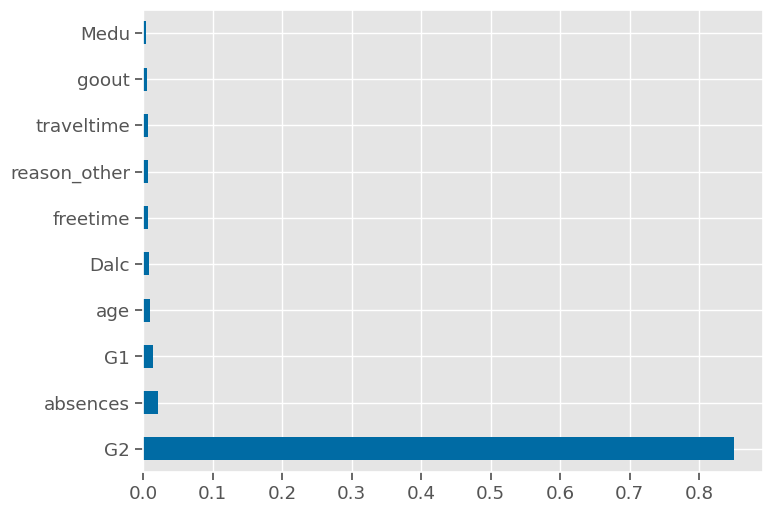

In [28]:
## just keep the top 10 importances and plot
sorted_importance.head(10).plot(kind='barh',
                                   figsize=(8,6))


Is this what you expected? We wanted the most important feature on top, but it is at the bottom!

- We have successfully plotted our top 10 feature importances, but notice that the bars were actually plotted in the REVERSE order than we expected.
- It is a strange quirk of matplotlib: For whatever reason, matplotlib plots bars in the opposite order as they are provided.
- To fix this:
    - We will use the default sorting for sort_values() and we will take the .tail(10) instead of .head(10)

In [29]:
## Saving the feature importances sorted from smallest to largest (ascending=True)
sorted_importance = importances.sort_values()
sorted_importance



paid_yes             0.000205
Fjob_teacher         0.000289
higher_yes           0.000314
higher_no            0.000344
Pstatus_T            0.000357
internet_no          0.000367
Mjob_health          0.000469
paid_no              0.000491
Fjob_at_home         0.000496
Pstatus_A            0.000525
internet_yes         0.000530
activities_no        0.000608
activities_yes       0.000609
Fjob_health          0.000632
guardian_other       0.000659
romantic_yes         0.000678
famsize_GT3          0.000708
Mjob_at_home         0.000725
Mjob_services        0.000788
sex_F                0.000801
address_R            0.000916
romantic_no          0.000948
famsize_LE3          0.000957
address_U            0.001079
nursery_no           0.001092
nursery_yes          0.001098
schoolsup_yes        0.001175
guardian_mother      0.001193
schoolsup_no         0.001292
reason_reputation    0.001329
school_MS            0.001340
reason_home          0.001498
school_GP            0.001506
reason_cou

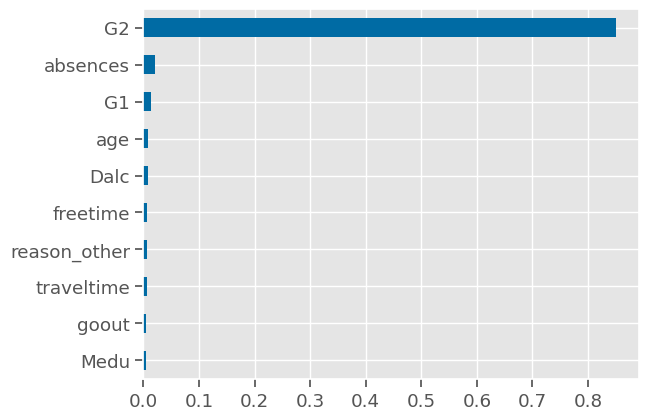

In [30]:
## just keep the top 10 importances and plot (that are now at the bottom of our series)
ax = sorted_importance.tail(10).plot(kind='barh')



- Now, let's address the other issues with our visualization and save the figure as a variable.

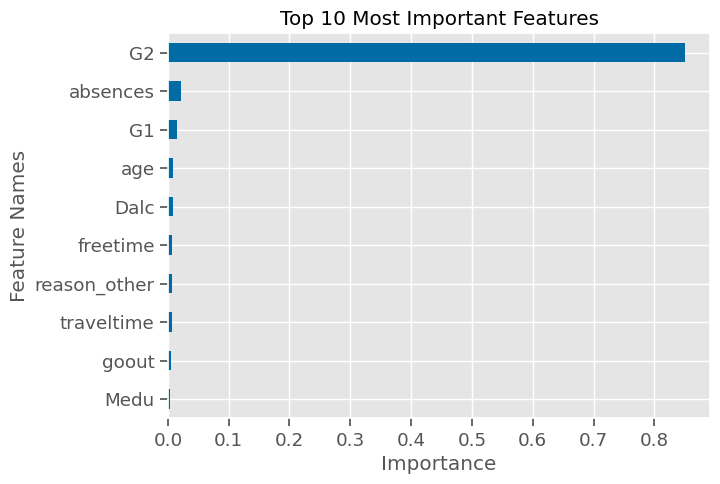

In [31]:
## plotting top 10 importances
ax = sorted_importance.tail(10).plot(kind='barh',
                                    figsize=(7,5),
                                      )
ax.set(xlabel='Importance',
        ylabel='Feature Names',
        title='Top 10 Most Important Features');



**Note on saving Figures as a variables**

- When we use Pandas to make our visualization. It returns the Axis for the plot.
    - As you can see immediately below, if we try to display the ax, we don't actually see our figure!

In [32]:
## displaying the Axis
ax



<Axes: title={'center': 'Top 10 Most Important Features'}, xlabel='Importance', ylabel='Feature Names'>

- To save the Figure, we can either:
    - use the ax.get_figure() method to extract it from our axis
    - run a special matplotlib function in the same cell that we create the graph. The function is called plt.gcf() (get current figure)

We will demonstrate each method below:

**get_figure()**

In [33]:
## using the ax to get the fig
fig_ax = ax.get_figure()



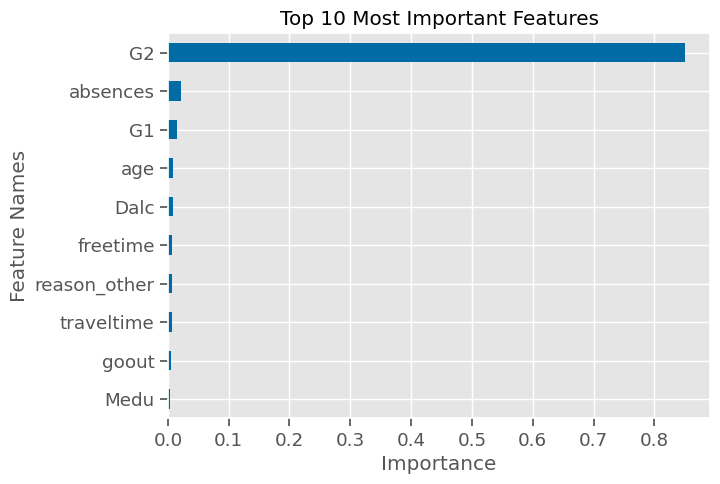

In [34]:
fig_ax



**plt.gcf()**

- plt.gcf() can be very helpful in scenarios where we cannot easily get the figure that is produced by a plotting function in a python package.

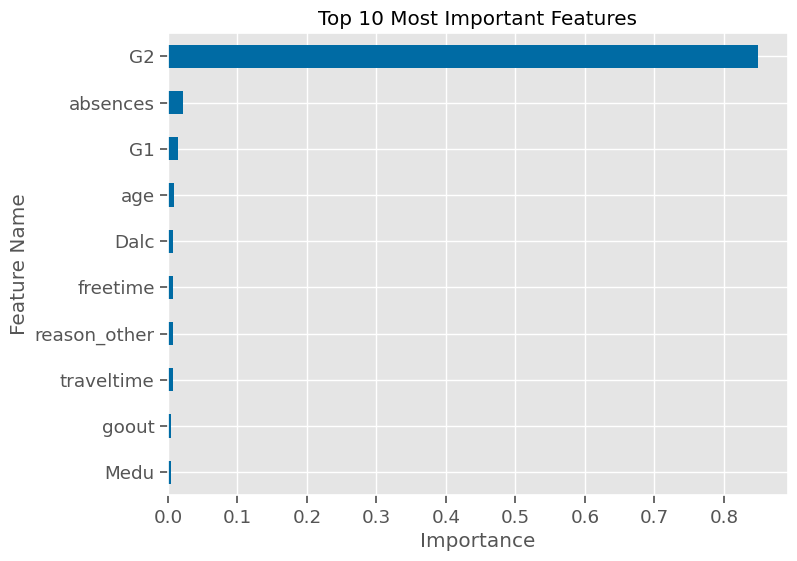

In [35]:
## Using plt.gcf to get the fig
ax = sorted_importance.tail(10).plot(kind='barh',
                                    figsize=(8,6), xlabel='Importance',
                                    ylabel='Feature Name', 
                                    title='Top 10 Most Important Features')
fig_gcf = plt.gcf()



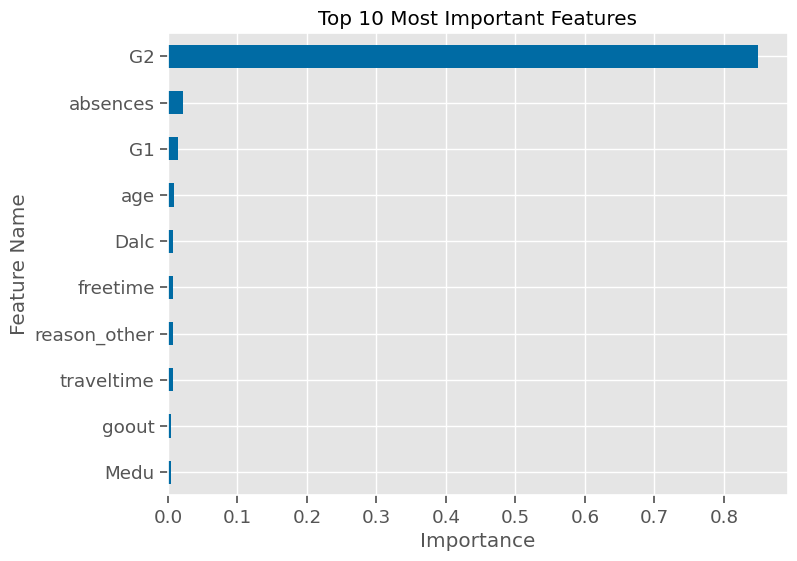

In [36]:
#  Now, we can easily display the figure anytime:

fig_gcf


As you can see, both the ax.get_figure() and plt.gcf () approach of saving the figure produce the same result!

### Interpreting Feature Importance

**Now that we are happy with our visual, let's start interpreting what it means.**

- What the feature importances tell us:
    - G2 is by far the single most important feature for predicting G3.
    - The number of absences is the second most important.
    - G1, age, Dalc, freetime, are somewhat important
    - Everything else is unimportant.

Note: we could actually use the feature importances to select which features we want to keep in our model!

- What the feature importances don't tell us:
    - Notice that all of the values on the graph are positive.
        - There is no +/- directionality with feature importance!
    - We only know that a feature was heavily used to predict the target, but we DON'T KNOW the actual relationship between the feature and the target.
    - Does having a higher G2 mean a higher G3?
    - Do more absences mean a higher G3?

**We don't know!**

### Defining a Function for Feature Importance

- Obtaining feature importance is another process that we will want to easily repeat for future modes, so let's make a function for getting feature importance.

#### Function Considerations:

- We may or may not want to sort the features by importance.
- We may or may not want to plot the importances.
    - We may want to only plot the top N most important features.
- In our current example, we already have the feature names saved as a variable called feature_names. But what about scenarios in which we haven't already created a variable for that?
    - The most convenient solution for this is to leverage the new model.feature_names_in_ attribute, which has the names of the training data features memorized!

In [37]:
## extracting feature names from the model
reg.feature_names_in_



array(['age', 'Medu', 'Fedu', 'traveltime', 'studytime', 'failures',
       'famrel', 'freetime', 'goout', 'Dalc', 'Walc', 'health',
       'absences', 'G1', 'G2', 'school_GP', 'school_MS', 'sex_F', 'sex_M',
       'address_R', 'address_U', 'famsize_GT3', 'famsize_LE3',
       'Pstatus_A', 'Pstatus_T', 'Mjob_at_home', 'Mjob_health',
       'Mjob_other', 'Mjob_services', 'Mjob_teacher', 'Fjob_at_home',
       'Fjob_health', 'Fjob_other', 'Fjob_services', 'Fjob_teacher',
       'reason_course', 'reason_home', 'reason_other',
       'reason_reputation', 'guardian_father', 'guardian_mother',
       'guardian_other', 'schoolsup_no', 'schoolsup_yes', 'famsup_no',
       'famsup_yes', 'paid_no', 'paid_yes', 'activities_no',
       'activities_yes', 'nursery_no', 'nursery_yes', 'higher_no',
       'higher_yes', 'internet_no', 'internet_yes', 'romantic_no',
       'romantic_yes'], dtype=object)

**Note: using None as a default argument for processes that we can calculate/extract if not provided.**

- if we say feature_names=None in our function definition, we can then check if feature_names==None inside our function.
- If it's not None, then go ahead and use the provided feature names.
- If it IS None: then extract them from the model using .feature_names_in_

In [38]:
def get_importances(model, feature_names=None,name='Feature Importance',
                   sort=False, ascending=True):
    
    ## checking for feature names
    if feature_names == None:
        feature_names = model.feature_names_in_
        
    ## Saving the feature importances
    importances = pd.Series(model.feature_importances_, index= feature_names,
                           name=name)
    
    # sort importances
    if sort == True:
        importances = importances.sort_values(ascending=ascending)
        
    return importances



In [39]:
# Test Function
importances = get_importances(reg,sort=True,ascending=False)
importances



G2                   0.849691
absences             0.021246
G1                   0.014336
age                  0.009061
Dalc                 0.007965
freetime             0.007281
reason_other         0.007138
traveltime           0.007005
goout                0.005168
Medu                 0.004278
Mjob_teacher         0.004046
Fedu                 0.003987
Walc                 0.003653
failures             0.003514
health               0.003451
famsup_no            0.002871
Fjob_services        0.002642
famrel               0.002493
guardian_father      0.002401
studytime            0.002256
famsup_yes           0.002088
Fjob_other           0.002024
sex_M                0.002006
Mjob_other           0.001723
reason_course        0.001660
school_GP            0.001506
reason_home          0.001498
school_MS            0.001340
reason_reputation    0.001329
schoolsup_no         0.001292
guardian_mother      0.001193
schoolsup_yes        0.001175
nursery_yes          0.001098
nursery_no

In [40]:
# Custom Function to plot importance

def plot_importance(importances, top_n=None,  figsize=(8,6)):
    # sorting with asc=false for correct order of bars
    if top_n==None:
        ## sort all features and set title
        plot_vals = importances.sort_values()
        title = "All Features - Ranked by Importance"
    else:
        ## sort features and keep top_n and set title
        plot_vals = importances.sort_values().tail(top_n)
        title = f"Top {top_n} Most Important Features"
    ## plotting top N importances
    ax = plot_vals.plot(kind='barh', figsize=figsize)
    ax.set(xlabel='Importance',
            ylabel='Feature Names',
            title=title)
    ## return ax in case want to continue to update/modify figure
    return ax



<Axes: title={'center': 'All Features - Ranked by Importance'}, xlabel='Importance', ylabel='Feature Names'>

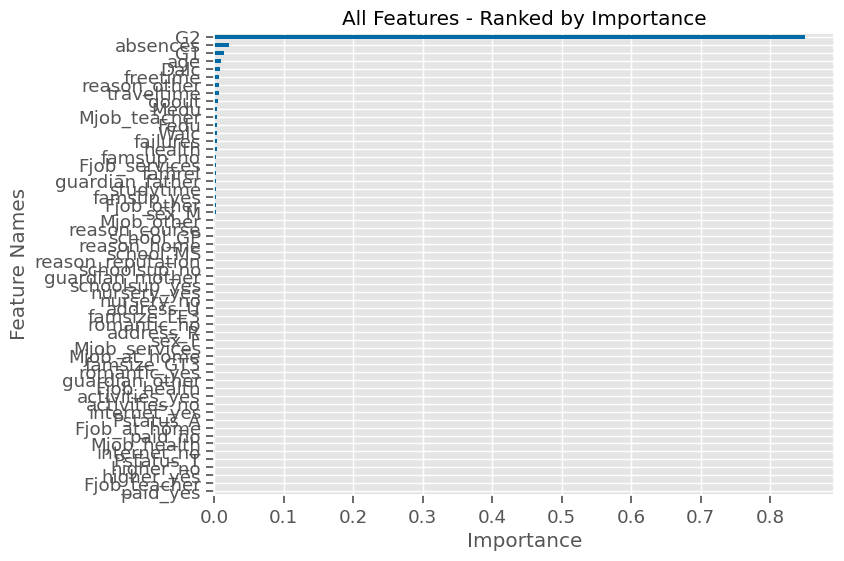

In [41]:
## testing our function
plot_importance(importances)



**Now let's change the argument in our function to produce only the top 15 results.**

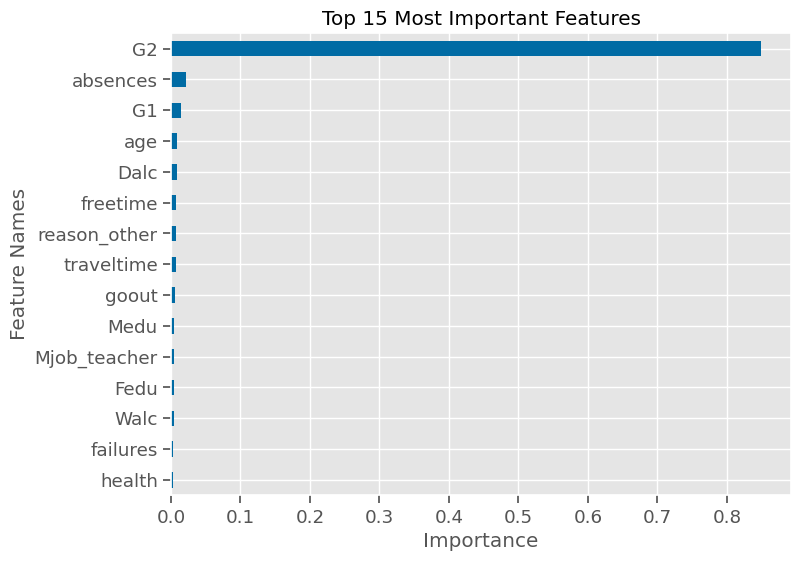

In [42]:
## testing our function
importances = get_importances(reg,sort=True,ascending=False,
                              name="RandomForest Importances")
plot_importance(importances,top_n=15);



### Remaking Our Model - Using Our Functions

- Now that we have 3 helpful functions for evaluating our model and visualizing feature importance, let's remake our previous model one more time.
- This time, we will call all 3 of our custom functions in the same cell as fitting our model.
- Notice how efficient this code cell is!

Training Data:	R^2= 0.98	RMSE= 0.52
Test Data:	R^2= 0.83	RMSE= 1.26


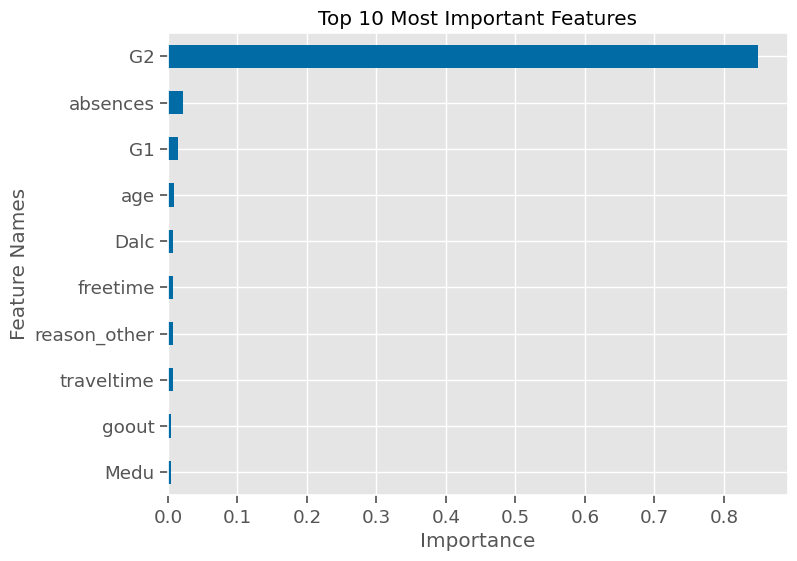

In [43]:
## fit random forest
from sklearn.ensemble import RandomForestRegressor
reg = RandomForestRegressor()
reg.fit(X_train_df,y_train)
evaluate_regression(reg, X_train_df, y_train, X_test_df,y_test)
## Saving the feature importances
importances = get_importances(reg)
plot_importance(importances, top_n=10);



### Exploring the Most Important Features

- As we discussed when we introduced feature importance, we only know which features were used by the model to make its predictions, but we don't know the nature of the relationship between each feature.
- We will discuss additional tools we can apply to get more information about this relationship. But we can also do some EDA to explore the most important features and how they are related to the target.
- Since feature importances sum to 1, if one feature is extremely important (In this case G2 is a dominating feature), the other features will only account for a very small amount of importance.
- Let's dive deeper into the 4 most important features used by our model.

In [44]:
importances.sort_values(ascending=False).head(4)



G2          0.849691
absences    0.021246
G1          0.014336
age         0.009061
Name: Feature Importance, dtype: float64

- Before we complete the EDA, let's put our DataFrame back together for plotting to include all the train and test values and to ensure our features are matched up with the correct G3 score. 

In [45]:
plot_train = pd.concat([X_train_df,y_train],axis=1)
plot_test = pd.concat([X_test_df,y_test],axis=1)
plot_df = pd.concat([plot_train, plot_test])
plot_df



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,...,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_no,schoolsup_yes,famsup_no,famsup_yes,paid_no,paid_yes,activities_no,activities_yes,nursery_no,nursery_yes,higher_no,higher_yes,internet_no,internet_yes,romantic_no,romantic_yes,G3
54,15.0,3.0,3.0,1.0,1.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,0.0,13.0,12.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,13
208,16.0,2.0,3.0,2.0,1.0,0.0,5.0,3.0,3.0,1.0,1.0,3.0,0.0,13.0,12.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,12
23,16.0,2.0,2.0,2.0,2.0,0.0,5.0,4.0,4.0,2.0,4.0,5.0,2.0,10.0,10.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,10
547,16.0,4.0,1.0,1.0,1.0,0.0,4.0,1.0,2.0,2.0,1.0,2.0,0.0,10.0,11.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,11
604,18.0,1.0,1.0,3.0,2.0,1.0,4.0,4.0,2.0,1.0,2.0,2.0,2.0,9.0,10.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
333,17.0,1.0,1.0,1.0,3.0,0.0,4.0,3.0,3.0,1.0,1.0,3.0,0.0,13.0,13.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,14
454,16.0,1.0,2.0,1.0,3.0,1.0,1.0,3.0,2.0,1.0,2.0,4.0,3.0,9.0,8.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,8
56,15.0,4.0,3.0,1.0,2.0,0.0,4.0,3.0,2.0,1.0,1.0,1.0,0.0,15.0,14.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,15
203,17.0,1.0,2.0,1.0,2.0,0.0,3.0,1.0,3.0,1.0,5.0,3.0,6.0,9.0,9.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,10


### G2
- First, let's look at the relationship between G2 and G3 using Seaborn's regplot(). The regplot() will plot the data and a linear best-fit line. 

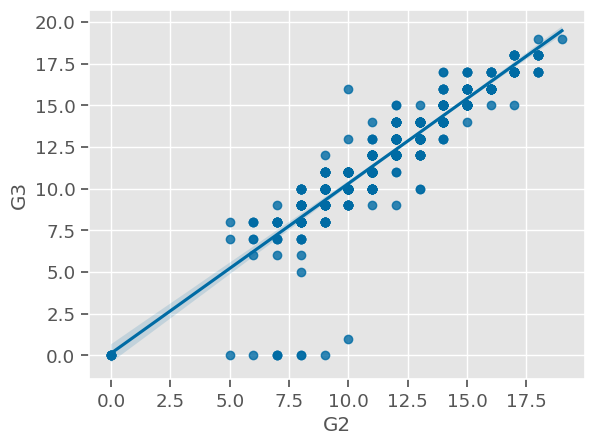

In [46]:
sns.regplot(data=plot_df, x='G2',y='G3');



- We can see a very clear pattern between G2 and G3. Except for a few 0's, all of the other values show a very strong correlation between G2 and G3, which makes sense.
- How well you did in Portuguese last period is going to be a very good indicator of how well you do in Portuguese the next period.

### Absences
Now let's take a look at the relationship between absences and G3. 

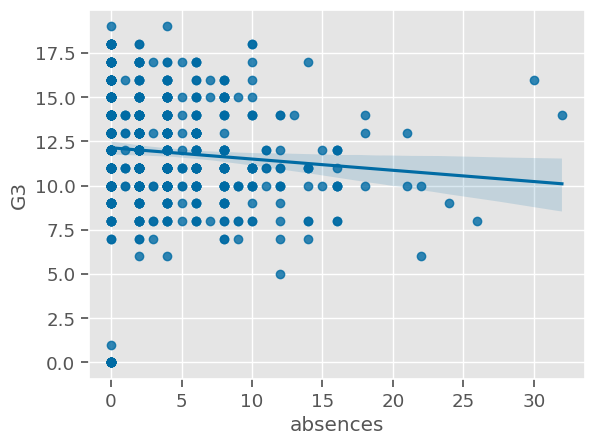

In [47]:
sns.regplot(data=plot_df, x='absences',y='G3');



- Absences seem to have a relatively flat relationship when we view a linear regression line summarizing the relationship.
- Instead of a normal linear regression, we can apply a Lowess regression (Locally Weighted Smoothed Scatterplot). This provides us with a nonlinear curve summarizing the relationship over the length of the entire x-axis.

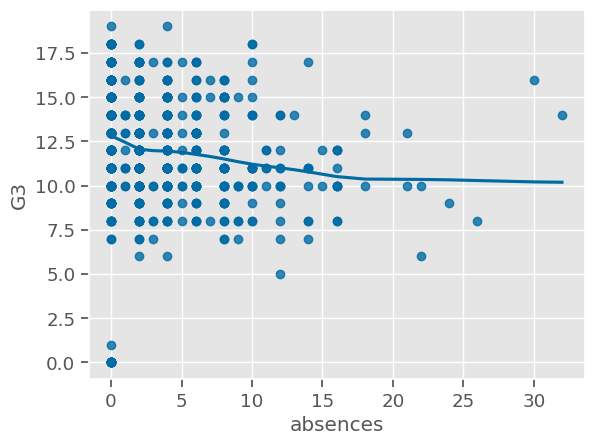

In [48]:
sns.regplot(data=plot_df, x='absences',y='G3', lowess=True);



We can see that there is a general trend where G3 decreases with more absences for about the first 16 absences, and after that, it remains fairly constant.

### G1
Now, let's see how the grade from period 1 relates to the grade in period 3.

<Axes: xlabel='G1', ylabel='G3'>

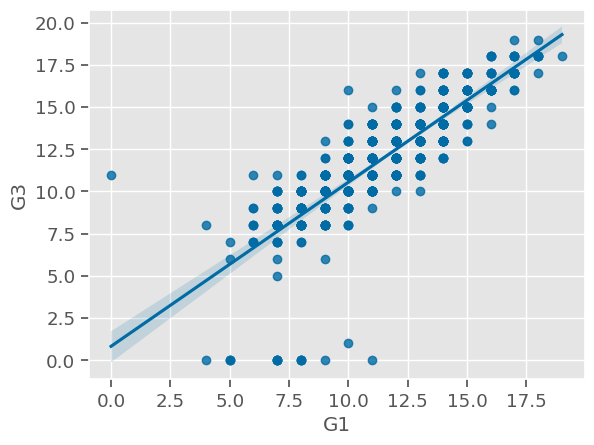

In [49]:
sns.regplot(data=plot_df, x='G1',y='G3')


Not surprisingly G1, is also a strong predictor, like G2.

### Age

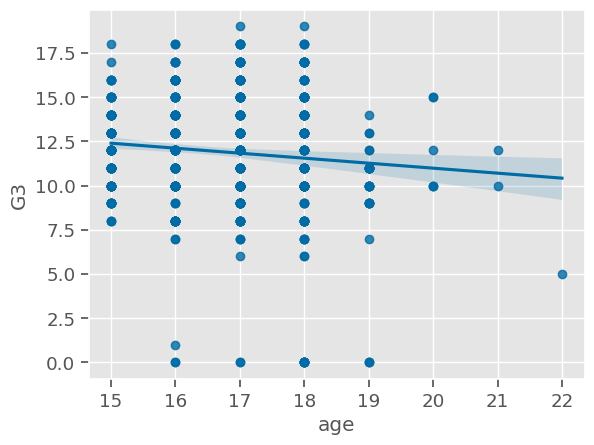

In [50]:
sns.regplot(data=plot_df, x='age',y='G3');


- Hmm, age has a more complicated and nonlinear relationship with our target.
- Let's visualize the Lowess scatterplot for this feature.

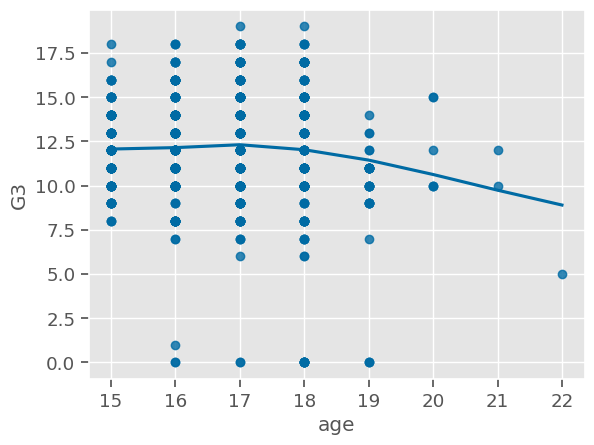

In [51]:
sns.regplot(data=plot_df, x='age',y='G3',lowess=True);



- It looks like the lowess scatterplot is showing us the same thing as our linear scatterplot:
    - A minor downward trend as age increases. 
- If we treat the ages as groups and visualize the average grade for each age, we may be able to see the pattern more clearly.

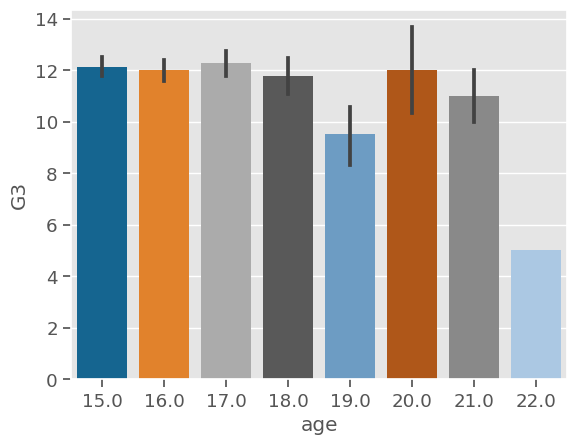

In [52]:
sns.barplot(data=plot_df, x='age',y='G3');



- It looks like there is a general pattern of older students performing worse in their 3rd period.
- This makes sense, as someone who is 19 years old may have been held back previously or had some developmental issues that caused them to start school at an older age.
    - We don't really know, though! At least not with the tools we have applied thus far.

Now we create a swarmplot on top of our bar plot. A swarmplot is a scatterplot that separates the points so they do not overlap and each point can be seen. This is an advanced technique to provide us with a more detailed visualization.

<Axes: xlabel='age', ylabel='G3'>

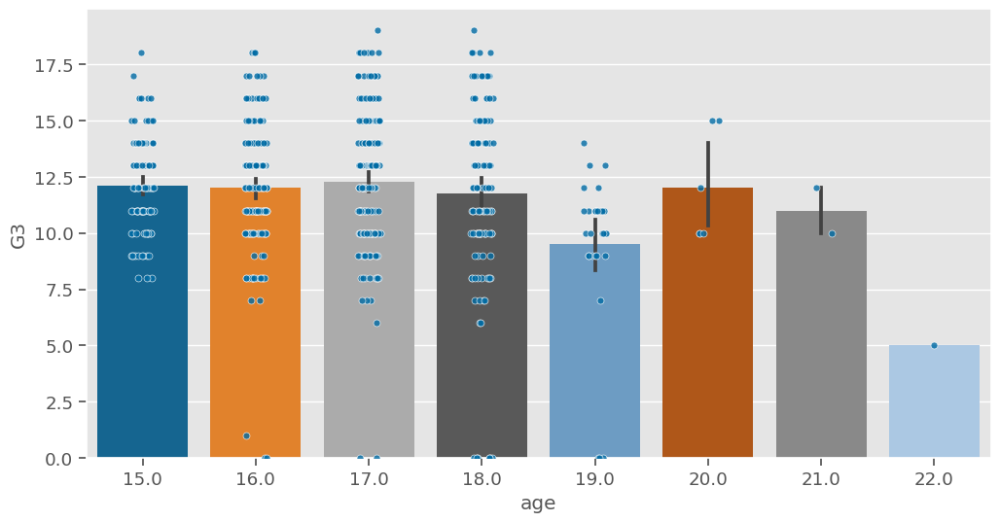

In [53]:
## adding a swarmplot to visualize each point
plt.figure(figsize=(12,6))
sns.stripplot(data=plot_df, x='age',y='G3',size=5,edgecolor='white',
              linewidth=0.5, alpha=.8);
sns.barplot(data=plot_df, x='age',y='G3')#,palette='dark');


As you can see, adding the swarmplot provides more detail in understanding how age is related to the G3 score.


### Plotting trees
Another way to visualize which features have the most impact on the model's prediction is to plot the tree.

- We can select an individual tree from our random forest and visualize its decision pathways using sklearn's plot_tree function.
- First, let's slice out the first tree from the forest's .estimators_ and evaluate its performance.

In [54]:
example_tree =  reg.estimators_[0]
example_tree



DecisionTreeRegressor(max_features=1.0, random_state=1657633780)

In [55]:
evaluate_regression(example_tree,X_train_df, y_train, X_test_df,y_test)



Training Data:	R^2= 0.88	RMSE= 1.16
Test Data:	R^2= 0.71	RMSE= 1.62


- We can see the first tree performed pretty well, with a similar R-squared score for training and test data.
- Before we try to visualize the entire tree, let's find out how deep it grew. Large trees can be very difficult to visualize in 1 graph.

In [56]:
example_tree.get_depth()



12

- Our tree is 12 levels deep. Let's attempt to visualize the entire tree.
- We will need to create a VERY large figure for this. Something way larger than any figure we would normally make. Let's try 40 inches by 30 inches.

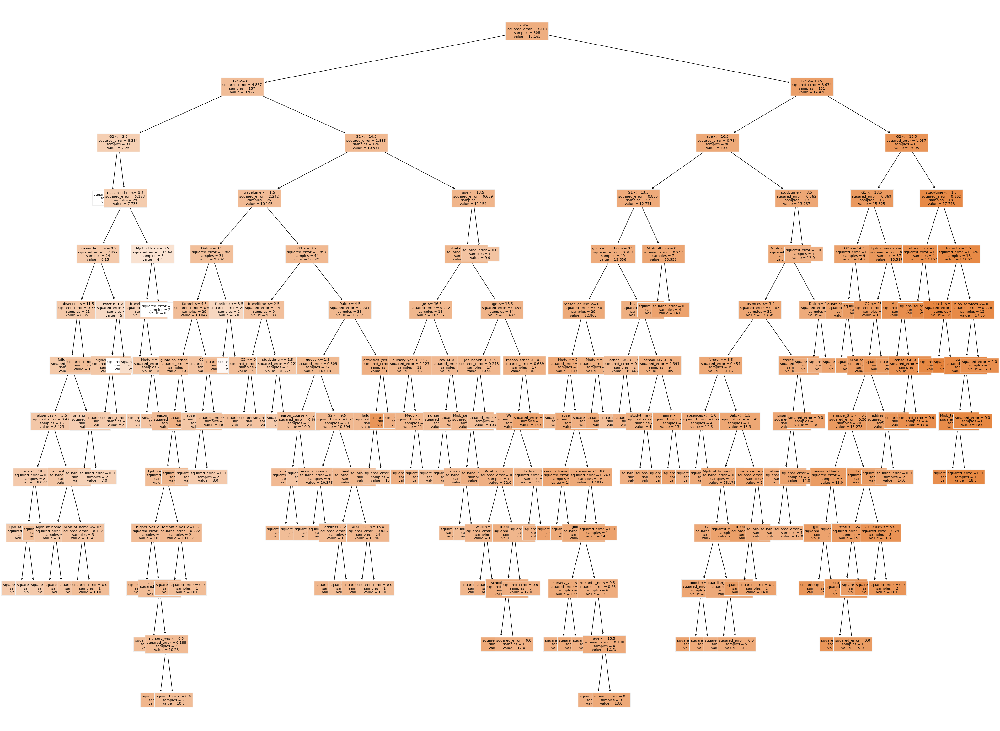

In [57]:
from sklearn.tree import plot_tree
fig, ax = plt.subplots(figsize=(40,30))
plot_tree(example_tree, filled=True, feature_names=feature_names,ax=ax, fontsize=8);



- Note: Jupyter notebook will automatically shrink figures to fit inside the output window.
    - If you slowly double-click on the image in Jupyter notebook, it should show you the larger version of the image with a scrollbar to explore it.
- You can always save the figure as a file first and open that manually, too!

In [58]:
fig.savefig('example_tree.png',dpi=300)



### Inspecting the First Few Layers

- There's a lot of information here, too much to easily fit in 1 visualization.
- Let's limit our plot_tree to use a max_depth of 4.

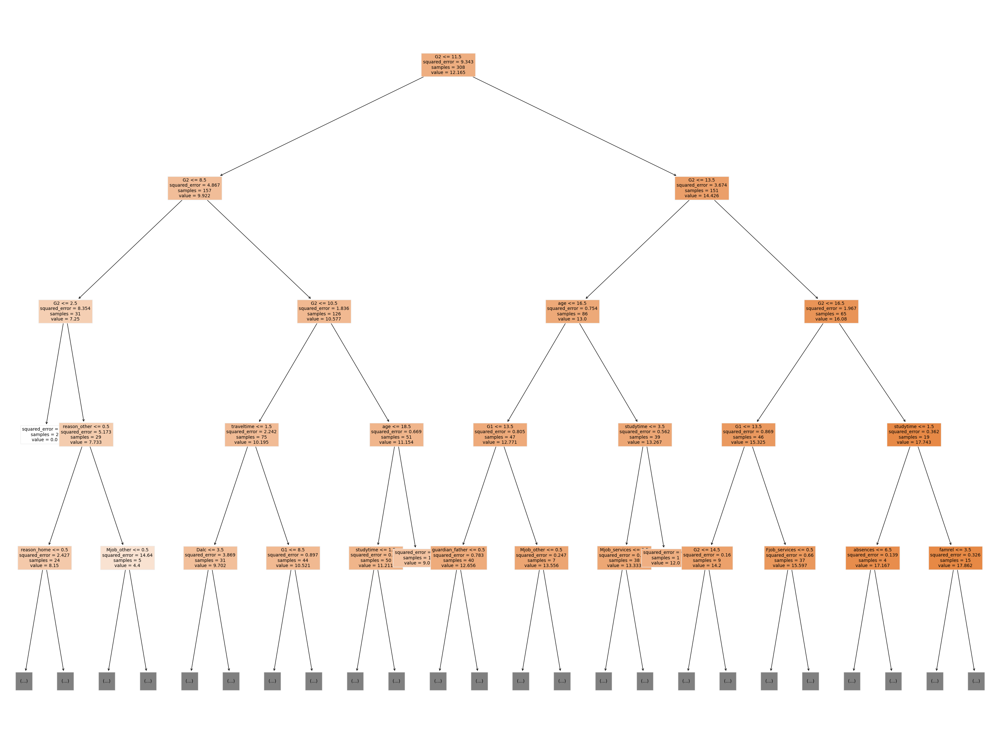

In [59]:
fig, ax = plt.subplots(figsize=(40,30))
plot_tree(example_tree, max_depth=4,filled=True,feature_names=feature_names,ax=ax,
         fontsize=10);




- If we examine the decision pathway (which starts at the top-center of the image), we can see that the tree used G2 for many splits early on in the tree. In the screenshot below, you can see all of the nodes that split using **G2 highlighted in red**.




- Remember: feature importance reflects how much the model used that feature to split the samples and predict the final grade. Therefore, it makes sense that we are seeing G2 being used a lot since it was the single most important feature (by far).

### Task B: Modeling Without Previous Grades

- We have also discussed different approaches we could take with this business problem. Our stakeholders do not want to wait until it is "too late" to start interventions with at-risk students. They want to make identify the potential at-risk students BEFORE G1 and G2 grades are earned. To address this, we will remove the G1 and G2 features in our next model to try to predict student grades for period 3 without knowing their prior grades.

In [60]:
## Drop the G1 and G2 features from the x vars
drop_cols = ['G1','G2']
X_train_B = X_train_df.drop(columns=drop_cols)
X_test_B = X_test_df.drop(columns=drop_cols)
feature_names_B = X_train_B.columns
X_train_B.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_GP,school_MS,sex_F,sex_M,address_R,address_U,famsize_GT3,famsize_LE3,Pstatus_A,Pstatus_T,Mjob_at_home,Mjob_health,...,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_no,schoolsup_yes,famsup_no,famsup_yes,paid_no,paid_yes,activities_no,activities_yes,nursery_no,nursery_yes,higher_no,higher_yes,internet_no,internet_yes,romantic_no,romantic_yes
54,15.0,3.0,3.0,1.0,1.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
208,16.0,2.0,3.0,2.0,1.0,0.0,5.0,3.0,3.0,1.0,1.0,3.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
23,16.0,2.0,2.0,2.0,2.0,0.0,5.0,4.0,4.0,2.0,4.0,5.0,2.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0


**Now that we have dropped G1 and G2, let's fit our model and call our 3 custom functions to evaluate it, get the feature importances, and visualize them.**

Training Data:	R^2= 0.89	RMSE= 1.08
Test Data:	R^2= 0.35	RMSE= 2.44


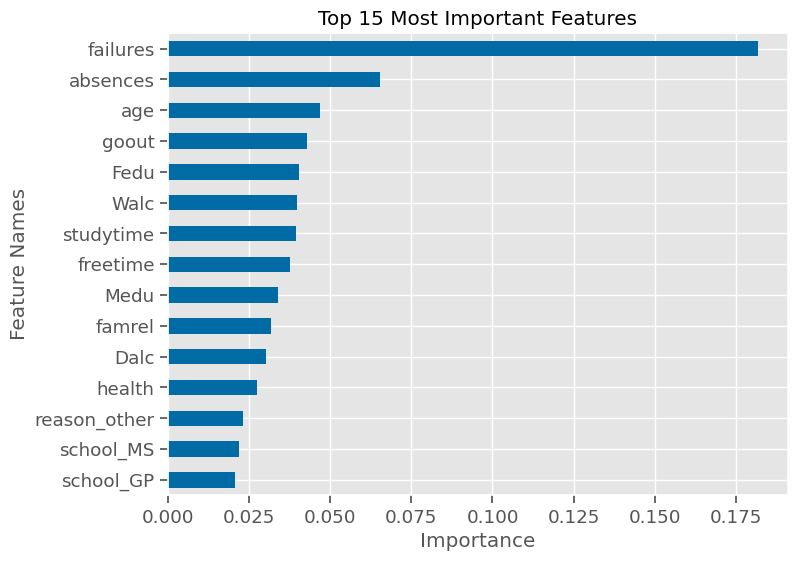

In [61]:
reg_B = RandomForestRegressor(random_state = SEED)
reg_B.fit(X_train_B, y_train)
evaluate_regression(reg_B, X_train_B, y_train, X_test_B,y_test)
## Saving the feature importances
importances = get_importances(reg_B, sort=True, ascending=False)
plot_importance(importances, top_n=15);



- Now that we have removed G2 and G1, we see a couple of significant changes in our results:
    - Our model's performance has decreased dramatically without those features. Our testing R-squared plummeted from .71 to .35
    - Many more features are showing visible degrees of importance than before.

### Quick EDA For Top Features (without G1 & G2)

- Let's visualize the most important feature, failures. 

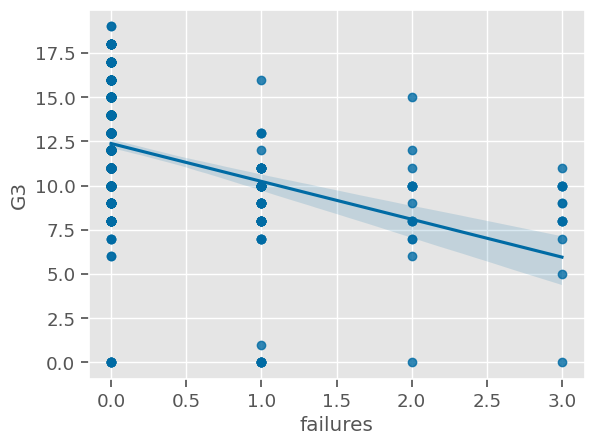

In [62]:
sns.regplot(data=plot_df, x='failures',y='G3');


As you can see, as students have more failures in other classes, they tend to have a lower scores in Portuguese, also.


**Caveats about Built-In Feature Importance**

- Also from the Scikit-Learn RandomForest Documentation on Feature Importance:
    - " Warning: impurity-based feature importances can be misleading for high cardinality features (many unique values). See sklearn.inspection.permutation_importance as an alternative."
- In other words, model-based feature importance is biased towards valuing features with many values and biased against valuing features with only a few values.
- This is notable for one-hot-encoded features which only have two values (0 or 1).
- We will explore another method that removes this bias against one-hot-encoded features in the next lesson.

**Summary**

This lesson used a random forest regressor to make predictions for G3 grades. From our tree-based model, we extracted feature importance, a quantitative value indicating how much each feature contributed to the prediction. Feature importances alone do not tell us the nature of the relationship between a feature and a target, so it is essential to complete additional EDA to understand whether the feature increases or decreases the target. We also saw how feature importances are used by the model by plotting the tree. We addressed our stakeholder's problem by running two models: one including G1 and G2, and one excluding G1 and G2. 

# Permutation Importance

**Learning Objectives:**

- Implement Scikit-Learn's permutation_importance
- Visualize and interpret permutation importance
- Note the advantages of permutation importance vs feature importance

## Permutation Importance (Beyond Built-In Importances)

- Scikit-learn has a tool called permutation importance that will calculate feature importance, without the issues discussed previously.
- The function will take our model and our features, and it will repeat the modeling for each feature.
    - One at a time, for each feature, it will shuffle all of the rows JUST IN THAT ONE FEATURE and repeat the modeling process.
    - The idea is that we are scrambling/destroying that feature's relationship to our target.
- Then, it examines which feature caused the biggest decrease in the model's performance, and it uses this information to determine the "permutation importance."
- A main advantage of permutation importance compared to feature importance it is not biased against valuing features with only a few values. Recall that this is especially notable for one-hot-encoded features, which only have two values (0 and 1). 

Here we will extract the permutation importances from the regression model we developed at the end of the last lesson.

https://scikit-learn.org/stable/modules/permutation_importance.html#permutation-feature-importance

In [63]:
from sklearn.inspection import permutation_importance
## Permutation importance takes a fit model and the test data.
r = permutation_importance(reg_B, X_test_B, y_test,n_repeats =5, random_state = SEED)
r.keys()



dict_keys(['importances_mean', 'importances_std', 'importances'])

**The result is a dictionary, and we want to pull out the importances_mean and make it a Pandas Series so it is easy to work with.** 

In [64]:
## can make the mean importances into a series
permutation_importances = pd.Series(r['importances_mean'],index=X_test_B.columns,
                           name = 'permutation importance')
permutation_importances = permutation_importances.sort_values(ascending=False)
permutation_importances



failures             0.357428
studytime            0.045001
absences             0.035727
Dalc                 0.024777
goout                0.020265
age                  0.019417
health               0.017610
Medu                 0.015610
higher_no            0.014927
higher_yes           0.012659
freetime             0.011334
Walc                 0.006975
famsup_yes           0.006587
famrel               0.006560
traveltime           0.006131
sex_M                0.005797
sex_F                0.005625
reason_other         0.004892
famsup_no            0.004291
activities_yes       0.004070
Mjob_health          0.003454
address_U            0.003346
schoolsup_yes        0.003174
guardian_mother      0.002712
schoolsup_no         0.002369
romantic_no          0.001837
Pstatus_T            0.001315
address_R            0.001179
Pstatus_A            0.000902
nursery_yes          0.000658
guardian_father      0.000655
Mjob_teacher         0.000377
guardian_other       0.000272
activities

**We can call our custom plotting function here to create our visualization. (This function is defined in the previous lesson.)** 

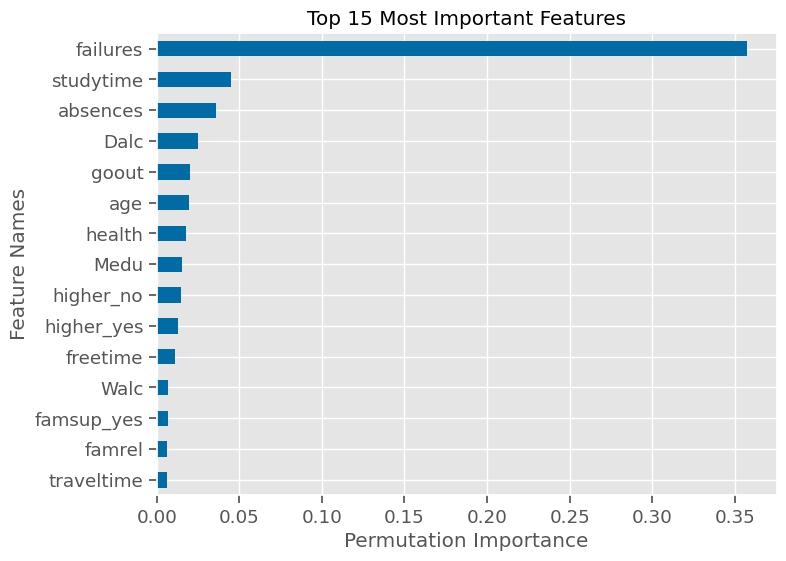

In [65]:
ax = plot_importance(permutation_importances,top_n=15)
ax.set(xlabel='Permutation Importance');


What is different about the features valued by permutation importance vs the built-in feature importances?

To help us make the comparisons, we will update our visual with color.

Easier Comparisons - Color Coordination

- We want to keep track of the top 5 important features from the random forest as we visualize the permutation importances.
- We can do this by creating a dictionary with each feature name as the key and the corresponding color as the value.

    - So if we wanted to color code the top 5 features as green, we first need a list of those top 5 features, which we can get from the sorted importances.

In [66]:
## color -coding top 5 bars
highlight_feats = importances.sort_values(ascending=True).tail(5).index
highlight_feats



Index(['Fedu', 'goout', 'age', 'absences', 'failures'], dtype='object')

- Next, we will create a dictionary by looping through the importances' index, and for each feature, we will add the feature name as the key. The value will be:

    - green if the feature is in our highlight_feats list (Our type 5 features from the built-in feature importances we extracted in the previous lesson).
    - otherwise blue. (see Note below).
    
Note:

- We want to keep the same shade of blue that is used by default with our current style.
- For now, we are simply telling you that this color is '#006ba4', but there is an optional lesson that explains how to obtain colors from an existing graph (See: Colormatching)

In [67]:
## create a dictionary of each feature and its color
colors_dict = {}
for col in importances.index:
    if col in highlight_feats:
        colors_dict[col] = 'green'    
    else:
        colors_dict[col] = '#006ba4'
colors_dict



{'failures': 'green',
 'absences': 'green',
 'age': 'green',
 'goout': 'green',
 'Fedu': 'green',
 'Walc': '#006ba4',
 'studytime': '#006ba4',
 'freetime': '#006ba4',
 'Medu': '#006ba4',
 'famrel': '#006ba4',
 'Dalc': '#006ba4',
 'health': '#006ba4',
 'reason_other': '#006ba4',
 'school_MS': '#006ba4',
 'school_GP': '#006ba4',
 'traveltime': '#006ba4',
 'higher_no': '#006ba4',
 'Mjob_teacher': '#006ba4',
 'higher_yes': '#006ba4',
 'reason_home': '#006ba4',
 'schoolsup_no': '#006ba4',
 'reason_reputation': '#006ba4',
 'Fjob_teacher': '#006ba4',
 'schoolsup_yes': '#006ba4',
 'famsup_no': '#006ba4',
 'Fjob_services': '#006ba4',
 'Mjob_at_home': '#006ba4',
 'activities_yes': '#006ba4',
 'Mjob_other': '#006ba4',
 'reason_course': '#006ba4',
 'famsup_yes': '#006ba4',
 'Fjob_other': '#006ba4',
 'sex_M': '#006ba4',
 'activities_no': '#006ba4',
 'famsize_LE3': '#006ba4',
 'sex_F': '#006ba4',
 'Mjob_services': '#006ba4',
 'romantic_no': '#006ba4',
 'guardian_mother': '#006ba4',
 'nursery_yes': '

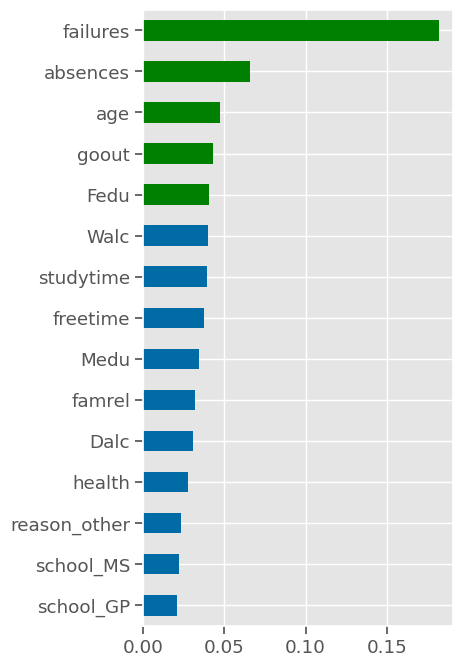

In [68]:
plot_vals = importances.sort_values().tail(15)
plot_vals.plot(kind='barh', color=plot_vals.index.map(colors_dict), figsize=(4,8));


In [69]:
# Function for more efficient future use
def get_color_dict(importances, color_rest='#006ba4' , color_top='green',
                    top_n=7):
    ## color -coding top 5 bars
    highlight_feats = importances.sort_values(ascending=True).tail(top_n).index
    colors_dict = {col: color_top if col in highlight_feats else color_rest for col in importances.index}
    return colors_dict




In [70]:
colors_top7 = get_color_dict(importances, top_n=7)
colors_top7



{'failures': 'green',
 'absences': 'green',
 'age': 'green',
 'goout': 'green',
 'Fedu': 'green',
 'Walc': 'green',
 'studytime': 'green',
 'freetime': '#006ba4',
 'Medu': '#006ba4',
 'famrel': '#006ba4',
 'Dalc': '#006ba4',
 'health': '#006ba4',
 'reason_other': '#006ba4',
 'school_MS': '#006ba4',
 'school_GP': '#006ba4',
 'traveltime': '#006ba4',
 'higher_no': '#006ba4',
 'Mjob_teacher': '#006ba4',
 'higher_yes': '#006ba4',
 'reason_home': '#006ba4',
 'schoolsup_no': '#006ba4',
 'reason_reputation': '#006ba4',
 'Fjob_teacher': '#006ba4',
 'schoolsup_yes': '#006ba4',
 'famsup_no': '#006ba4',
 'Fjob_services': '#006ba4',
 'Mjob_at_home': '#006ba4',
 'activities_yes': '#006ba4',
 'Mjob_other': '#006ba4',
 'reason_course': '#006ba4',
 'famsup_yes': '#006ba4',
 'Fjob_other': '#006ba4',
 'sex_M': '#006ba4',
 'activities_no': '#006ba4',
 'famsize_LE3': '#006ba4',
 'sex_F': '#006ba4',
 'Mjob_services': '#006ba4',
 'romantic_no': '#006ba4',
 'guardian_mother': '#006ba4',
 'nursery_yes': '#006

In [71]:
def plot_importance_color(importances, top_n=None,  figsize=(8,6), 
                          color_dict=None):
    
    # sorting with asc=false for correct order of bars
    if top_n==None:
        ## sort all features and set title
        plot_vals = importances.sort_values()
        title = "All Features - Ranked by Importance"
    else:
        ## sort features and keep top_n and set title
        plot_vals = importances.sort_values().tail(top_n)
        title = f"Top {top_n} Most Important Features"
    ## create plot with colors, if provided
    if color_dict is not None:
        ## Getting color list and saving to plot_kws
        colors = plot_vals.index.map(color_dict)
        ax = plot_vals.plot(kind='barh', figsize=figsize, color=colors)
        
    else:
        ## create plot without colors, if not provided
        ax = plot_vals.plot(kind='barh', figsize=figsize)
        
    # set titles and axis labels
    ax.set(xlabel='Importance', 
           ylabel='Feature Names', 
           title=title)
    
    ## return ax in case want to continue to update/modify figure
    return ax


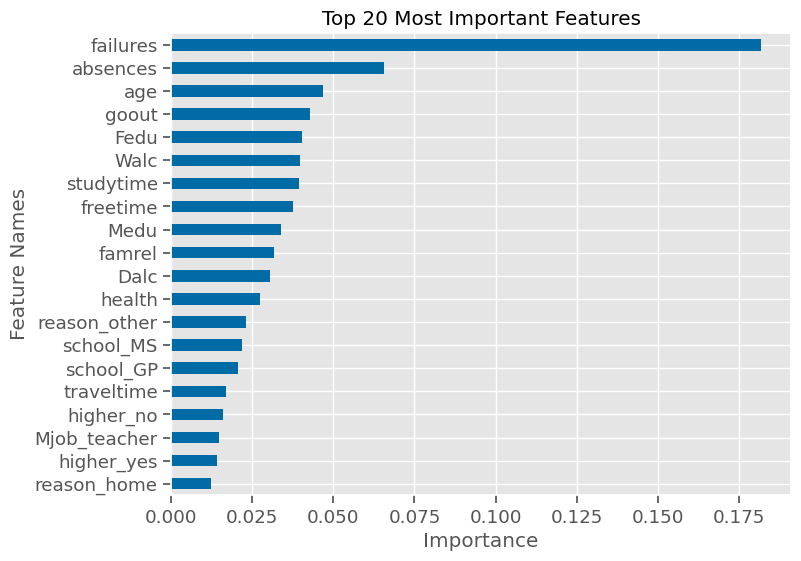

In [72]:
# First test function with no color dictionary

plot_importance_color(importances, color_dict=None,top_n=20);


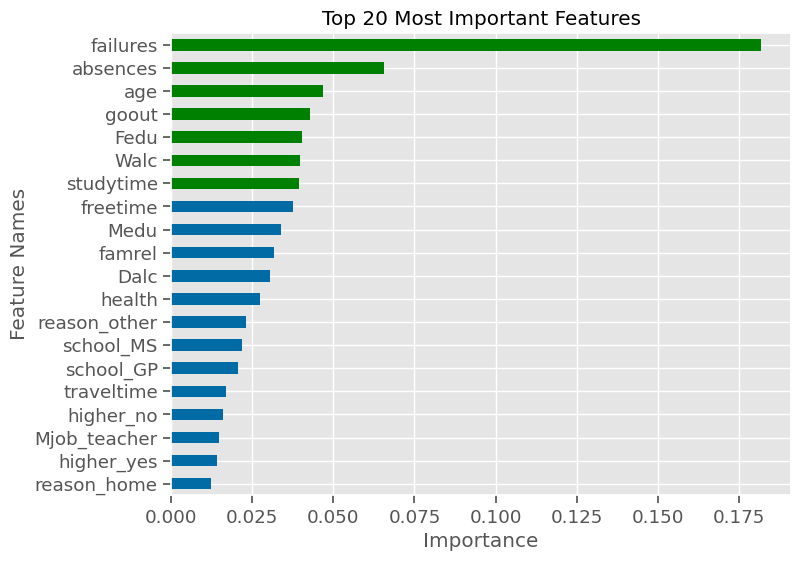

In [73]:
#  Now test with color dictionary

plot_importance_color(importances, color_dict=colors_top7,top_n=20);



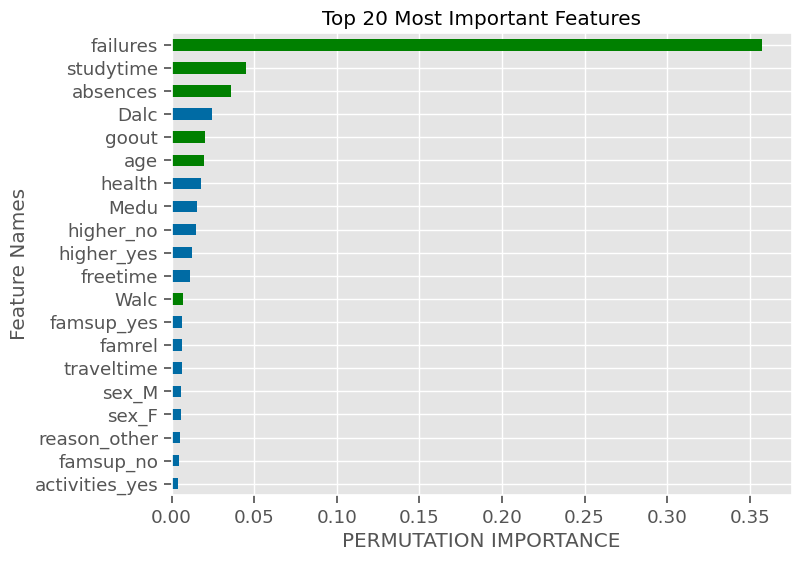

In [74]:
# Now plot based on the order of permutation importance

ax = plot_importance_color(permutation_importances,color_dict=colors_top7,top_n=20);
ax.set_xlabel("PERMUTATION IMPORTANCE");


Now you can see the benefit of color coding. We see that there is some overlap between important features and also some key differences.

The function below will create both a plot of built-in feature importance and permutation importance side by side for easy comparison.


**To make comparing the most important features across figures, we could create side-by-side subplots instead.**

In order to be able to use our function to create 2 subplots in one Figure, we can take advantage of the "ax" argument for panda's .plot method. By default, ax=None, which means pandas will create a new matplotlib axis for the plot. If we pass in a specific Matplotlib Axis (ax) then it will plot onto the provided ax.

- In order to add this to our function, we will add:
    - an "ax" argument that we will default to None ( just like pandas does).
    - "ax=ax" inside .plot




In [75]:
# Function to plot side by side subplots

def plot_importance_color_ax(importances, top_n=None,  figsize=(8,6), 
                          color_dict=None, ax=None):
    
    # sorting with asc=false for correct order of bars
    if top_n==None:
        ## sort all features and set title
        plot_vals = importances.sort_values()
        title = "All Features - Ranked by Importance"
    else:
        ## sort features and keep top_n and set title
        plot_vals = importances.sort_values().tail(top_n)
        title = f"Top {top_n} Most Important Features"
    ## create plot with colors, if provided
    if color_dict is not None:
        ## Getting color list and saving to plot_kws
        colors = plot_vals.index.map(color_dict)
        ax = plot_vals.plot(kind='barh', figsize=figsize, color=colors, ax=ax)
        
    else:
        ## create plot without colors, if not provided
        ax = plot_vals.plot(kind='barh', figsize=figsize, ax=ax)
        
    # set titles and axis labels
    ax.set(xlabel='Importance', 
           ylabel='Feature Names', 
           title=title)
    
    ## return ax in case want to continue to update/modify figure
    return ax


**Now we can create 2 side-by-side Axes with plt.subplots and then use our function twice, first to plot the left subplot and then to plot the right subplot.**

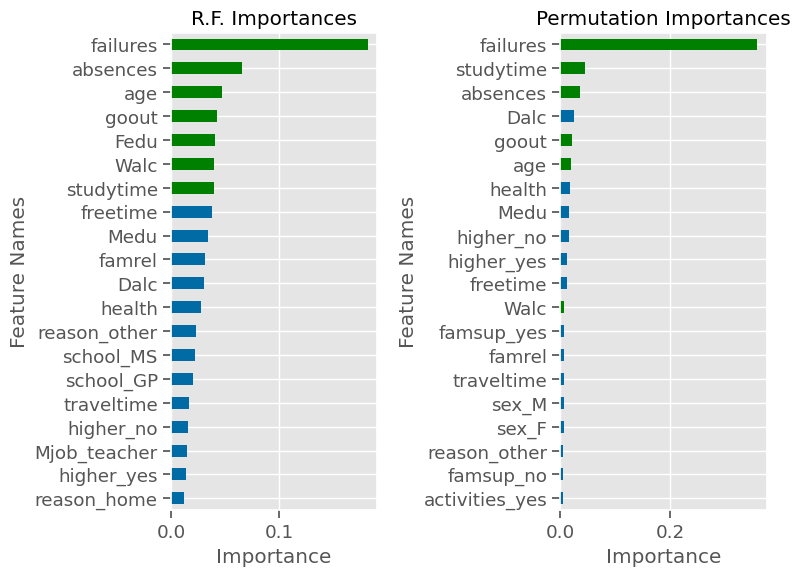

In [76]:
fig, axes = plt.subplots(ncols=2, figsize=(20,8))
n = 20 # setting the # of features to use for both subplots
plot_importance_color_ax(importances, top_n=n, ax=axes[0],
                         color_dict= colors_top7)
plot_importance_color_ax(permutation_importances, top_n=n, ax=axes[1],
                         color_dict=colors_top7)
axes[0].set(title='R.F. Importances')
axes[1].set(title='Permutation Importances')
fig.tight_layout()


Now, what is different about the features that permutation importance ranked as the most important vs. the built-in importances?

Comparing the random forest feature importances and the permutation importances above, we can see that:

- The most important features are the same in both. (failures)
- Notice that our built-in importances below had the following features as the next most important:
    - absences
    - age
    - gout
    - Fedu
- Compare this to permutation importance, which had the following as the next four most important features:
    - studytime
    - absences
    - Dalc
    - goout

- The random forest importances are biased towards considering continuous features to be more important. All of the top 10 features are continuous.
- Whereas permutation Importance judged all features without a bias towards continuous features. It identified a categorical feature in the top 10 (higher_no).

**Advantages/Disadvantages of Permutation Importance**

- Advantages:
    - Model agnostic (can be used on any model)
    - Avoids the biases of built-in feature importances.
- Disadvantages:
    - Only positive values (don't know which way each feature pushes the model's predictions)
        - Note that this is also a disadvantage of built-in feature importances

**EDA Follow-Up**

- Now that we have some categorical features appearing in our permutation importances, let's try to visualize those.
    - We will want to return to the original dataframe that still had the categorical features as a single column.

**Higher**

- Note that we used a larger figsize to allow us to see our individual points in the swarmplot. 

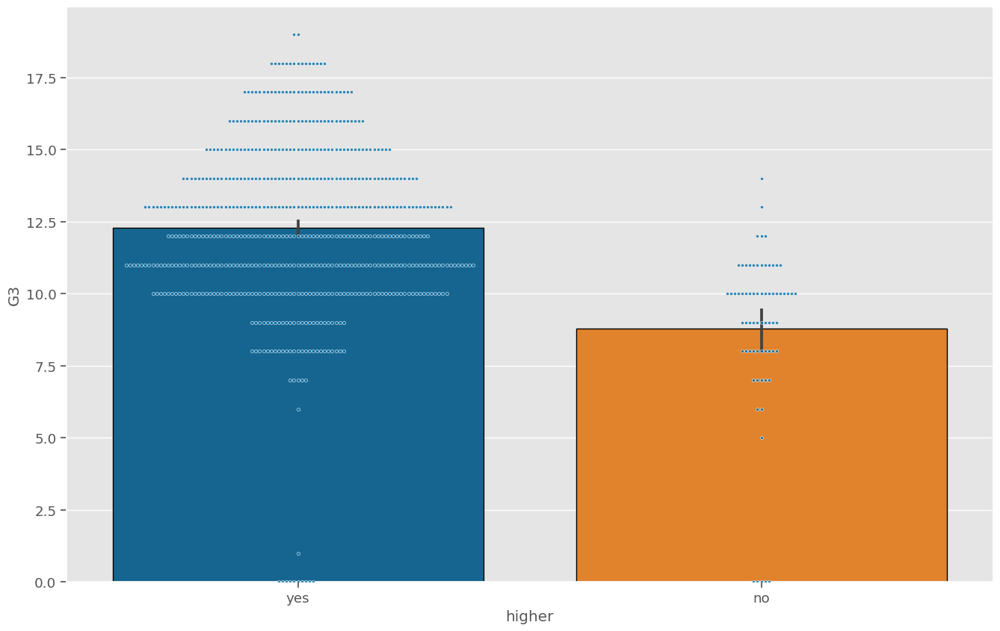

In [77]:
plt.figure(figsize=(16,10))
sns.swarmplot(data=df, x='higher',y='G3',size=3,edgecolor='white',
              linewidth=0.5, alpha=.8);
sns.barplot(data=df, x='higher',y='G3',edgecolor='black',
            linewidth=1);



### Beyond sklearn

- In an upcoming lesson, we will introduce additional packages designed to explain machine learning models with greater detail and nuance.

**Summary**

- In this lesson we implemented a scikit-learn tool that calculated permutation importance which is similar to built in importances but are less biased. We created a color code visualization to help us identify differences between the features valued by built in feature importance and those valued by permutation importance. 

# Color matching

**Learning Objectives:**

- Obtain the exact color used in a visual
- Color code graph elements by feature name

In the "Permutation Importances" lesson, when adding color to our visuals, we said:

- "We want to keep the same shade of blue that is used by default with our current style.
- For now, we are simply telling you that this color is '#006ba4' "

This lesson demonstrates how we obtained the matching color.

We can extract the current color from a bar by finding where it is located inside of the Axis.

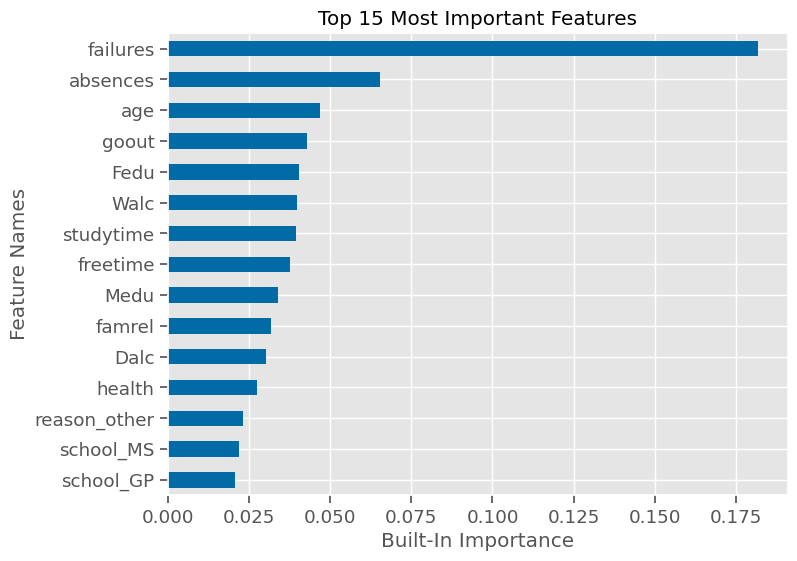

In [78]:
ax = plot_importance(importances,top_n=15)
ax.set(xlabel='Built-In Importance');


We want to obtain this color blue for use in our permutation importance plot.

- Axes have a .containers list that will contain the collections of visual elements used.

In [79]:
ax.containers



[<BarContainer object of 15 artists>]

In [80]:
# We need bars from the barcontainer

## get the bar container
bars = ax.containers[0]
bars



<BarContainer object of 15 artists>

In [81]:
# Each bar in our figure can be found in this object.

bar = bars[0]
bar



In [82]:
# Use OOP .get_ methods to extract the facecolor of the bar


bar_color = bar.get_facecolor()
bar_color



(0.0, 0.4196078431372549, 0.6431372549019608, 1.0)

In [83]:
## The color is returned as a tuple of RGBA values.
## Unfortunately, this format is not compatible with pandas .plot().


## Dict comprehension way - testing using RGBA color
colors_dict = {col:'green' if col in highlight_feats else bar_color for col in importances.index}
colors_dict



{'failures': 'green',
 'absences': 'green',
 'age': 'green',
 'goout': 'green',
 'Fedu': 'green',
 'Walc': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'studytime': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'freetime': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'Medu': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'famrel': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'Dalc': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'health': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'reason_other': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'school_MS': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'school_GP': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'traveltime': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'higher_no': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'Mjob_teacher': (0.0, 0.4196078431372549, 0.6431372549019608, 1.0),
 'higher_yes': (0.0, 0.4196078431372549, 0.6431372549019608

In [84]:
import matplotlib as mpl
#https://matplotlib.org/stable/api/colors_api.html#module-matplotlib.colors
bar_color_hex = mpl.colors.rgb2hex(bar_color)
bar_color_hex



'#006ba4'

**Summary**

In this lesson, we learned how to obtain the exact color used in an existing plot.


**Additional resources:**

For more information on the various forms of colors for matplotlib, check out their documentation on Specifying Colors

https://matplotlib.org/stable/users/explain/colors/colors.html

# Linear Regression Coefficients - Revisited

**Learning Objectives:**

By the end of this lesson, students will be able to:

- Extract coefficients from a sklearn linear regression model.
- Address multicollinearity by dropping one hot encoded categories.

Introduction

- At the end of the last stack, we dove deep into linear regression models and their assumptions. We introduced a new package called statsmodels, which produced a Linear Regression model using "Ordinary-Least-Squared (OLS)."
- The model included a robust statistical summary that was incredibly informative as we critically diagnosed our regression model and if we met the assumptions of linear regression.
- In this stack, we will be focusing on extracting insights from our models: both by examining parameters/aspects of the model itself, like the coefficients it calculated, but also by applying some additional tools and packages specifically designed to explain models.
- Most of these tools are compatible with the scikit-learn ecosystem but are not yet available for statsmodels.

Since we are not focusing on regression diagnostics this week, we will shift back to using scikit-learn models.

Keep working in your notebook where you have pre-processed the data. We will use our X_train_B and X_test_B, which exclude G1 and G2.
Extracting Coefficients and Intercept from Scikit-Learn Linear Regression

In [85]:
from sklearn.linear_model import LinearRegression


**We will run our regression model on our "B" set which excludes G1 and G2.** 

In [86]:
## fitting a linear regression model
lin_reg = LinearRegression()
lin_reg.fit(X_train_B, y_train)
evaluate_regression(lin_reg, X_train_B, y_train, X_test_B,y_test)


Training Data:	R^2= 0.35	RMSE= 2.65
Test Data:	R^2= 0.35	RMSE= 2.45


- When we exclude G1 and G2 our r2 is quite low (.35). When a model's performance is this low, we should be cautious about the insights we take from it. We will demonstrate the process for interpreting the coefficients of this model, but we recommend you also repeat this interpretation for the higher-performing model that includes G1 and G2. These are different use cases, but both are relevant to our stakeholders.
- For scikit-learn Linear Regressions, we can find the coefficients for the features that were included in our X-data under the .coef_ attribute.
- The .coef_ is a NumPy matrix that should have the same number of values as the # of columns in X_train_df.

In [87]:
# .coef_  

lin_reg.coef_



array([ 1.76713930e-01,  8.75746377e-02,  2.12878463e-01,  2.50257851e-01,
        4.62433661e-01, -1.29463344e+00,  1.58601728e-01, -2.34722852e-01,
        5.24829043e-03, -2.12672217e-01, -7.12735735e-02, -1.23058248e-01,
       -2.93712506e-02, -2.07041914e+10, -2.07041914e+10, -3.10857750e+10,
       -3.10857750e+10, -9.49361159e+09, -9.49361159e+09,  2.95249429e+09,
        2.95249429e+09,  9.03831022e+09,  9.03831022e+09,  1.53699936e+09,
        1.53699936e+09,  1.53699936e+09,  1.53699936e+09,  1.53699936e+09,
       -3.01701153e+09, -3.01701153e+09, -3.01701153e+09, -3.01701153e+09,
       -3.01701153e+09,  2.33170318e+10,  2.33170318e+10,  2.33170318e+10,
        2.33170318e+10, -1.27672586e+11, -1.27672586e+11, -1.27672586e+11,
        8.30162997e+10,  8.30162997e+10, -6.28008741e+09, -6.28008741e+09,
       -1.51244873e+10, -1.51244873e+10, -1.69323494e+09, -1.69323494e+09,
       -7.13453863e+09, -7.13453863e+09,  2.31651833e+10,  2.31651833e+10,
        1.16618148e+10,  

In [88]:
## Checking the number of coeffs matches the # of feature names
print(len(lin_reg.coef_))
len(feature_names_B)



56


56

## Saving the coefficients as a pandas Series

- We can immediately turn the model's .coef_ into a pd.Series, as well.
    - Therefore, in our pd.Series, we will provide the lin_reg.coef_ as the first argument, followed by index=feature_names_B.

In [89]:
## Saving the coefficients
coeffs = pd.Series(lin_reg.coef_, index= feature_names_B)
coeffs



age                  1.767139e-01
Medu                 8.757464e-02
Fedu                 2.128785e-01
traveltime           2.502579e-01
studytime            4.624337e-01
failures            -1.294633e+00
famrel               1.586017e-01
freetime            -2.347229e-01
goout                5.248290e-03
Dalc                -2.126722e-01
Walc                -7.127357e-02
health              -1.230582e-01
absences            -2.937125e-02
school_GP           -2.070419e+10
school_MS           -2.070419e+10
sex_F               -3.108577e+10
sex_M               -3.108577e+10
address_R           -9.493612e+09
address_U           -9.493612e+09
famsize_GT3          2.952494e+09
famsize_LE3          2.952494e+09
Pstatus_A            9.038310e+09
Pstatus_T            9.038310e+09
Mjob_at_home         1.536999e+09
Mjob_health          1.536999e+09
Mjob_other           1.536999e+09
Mjob_services        1.536999e+09
Mjob_teacher         1.536999e+09
Fjob_at_home        -3.017012e+09
Fjob_health   

- The constant/intercept is not included in the .coef_ attribute (if we used the default settings for LinearRegression, which sets fit_intercept = True)
- The intercept is stored in the .intercept_ attribute.
- We can add this as a new value to our coeffs series.
- Note: it is up to you what you name your intercept/constant. If you wanted to keep the naming convention of statsmodels, you could use "const" or just "intercept" for simplicity.

In [90]:
# use .loc to add the intercept to the series
coeffs.loc['intercept'] = lin_reg.intercept_
coeffs


age                  1.767139e-01
Medu                 8.757464e-02
Fedu                 2.128785e-01
traveltime           2.502579e-01
studytime            4.624337e-01
failures            -1.294633e+00
famrel               1.586017e-01
freetime            -2.347229e-01
goout                5.248290e-03
Dalc                -2.126722e-01
Walc                -7.127357e-02
health              -1.230582e-01
absences            -2.937125e-02
school_GP           -2.070419e+10
school_MS           -2.070419e+10
sex_F               -3.108577e+10
sex_M               -3.108577e+10
address_R           -9.493612e+09
address_U           -9.493612e+09
famsize_GT3          2.952494e+09
famsize_LE3          2.952494e+09
Pstatus_A            9.038310e+09
Pstatus_T            9.038310e+09
Mjob_at_home         1.536999e+09
Mjob_health          1.536999e+09
Mjob_other           1.536999e+09
Mjob_services        1.536999e+09
Mjob_teacher         1.536999e+09
Fjob_at_home        -3.017012e+09
Fjob_health   

## Suppressing Scientific Notation in Pandas

We can also use panda's options to change how it display numeric values.

- if we want to add a , separator for thousands and round to 2 decimal places, we would use the format code ",.2f".
- For Pandas to use this, we will have to use an f-string with a lambda x. (x represents any numeric value being displayed by pandas).

In [91]:
pd.set_option('display.float_format', lambda x: f"{x:,.2f}")
coeffs



age                                0.18
Medu                               0.09
Fedu                               0.21
traveltime                         0.25
studytime                          0.46
failures                          -1.29
famrel                             0.16
freetime                          -0.23
goout                              0.01
Dalc                              -0.21
Walc                              -0.07
health                            -0.12
absences                          -0.03
school_GP            -20,704,191,375.32
school_MS            -20,704,191,376.78
sex_F                -31,085,774,959.63
sex_M                -31,085,774,960.29
address_R             -9,493,611,591.24
address_U             -9,493,611,591.01
famsize_GT3            2,952,494,294.08
famsize_LE3            2,952,494,294.58
Pstatus_A              9,038,310,219.98
Pstatus_T              9,038,310,220.25
Mjob_at_home           1,536,999,359.81
Mjob_health            1,536,999,360.73


## Inspecting Our Coefficients - Sanity Check

- Hmmm... hold on now. We saw in the last lesson that our target, G3, contained scores from 0 to 20.
- So HOW IN THE WORLD does it make sense that your model's baseline value (the y-intercept) is so huge??!?
- This may be due to us introducing multicollinearity during One Hot Encoding.
- Recall that multicollinearity occurs when features are highly correlated with each other. 

### Using OneHotEncoder with binary categorical features.

- If we check just our string columns for the # of unique values:

In [92]:
df.select_dtypes('object').nunique()



school        2
sex           2
address       2
famsize       2
Pstatus       2
Mjob          5
Fjob          5
reason        4
guardian      3
schoolsup     2
famsup        2
paid          2
activities    2
nursery       2
higher        2
internet      2
romantic      2
dtype: int64

### OneHotEncoding & Multicollinearity

- We can see that many of our categories only have two options.
    - For example the paid feature.
        - One Hot Encoding this feature will create a "paid_no" column and "paid_yes" column.
- Here is where we should consider our final use case for this data. If we want to explain student performance, there is no benefit to one-hot-encoding both categories.
    - We know that if someone has a 0 for "paid_yes," that it means "paid_no" would be 1.
- To remove these unnecessary columns, we can change our arguments for our OneHotEncoder in our pipeline and add "drop='if_binary'" or "drop='first'/'last' to automatically drop one of the categories to reduce multicollinearity.
    - HOWEVER, we cannot use BOTH handle_unknown AND the drop argument together. We will get an error message.
- Since our current modeling will be used to extract insights for our stakeholders and will not be deployed to the cloud where it will run predictions on new data, we can safely switch to using the drop='if_binary' option.

Recreating Our X/y data with drop='if_binary'

In [93]:
## Make x and y variables
y = df['G3'].copy()
X = df.drop(columns=['G1', 'G2', 'G3']).copy()
## train-test-split with random state for reproducibility
X_train, X_test, y_train, y_test = train_test_split(X,y, random_state=SEED)



In [94]:
## make pipelines for categorical vs numeric data
cat_pipe = make_pipeline(SimpleImputer(strategy='constant',
                                       fill_value='MISSING'),
                         OneHotEncoder(drop='if_binary', sparse=False))
num_pipe = make_pipeline(SimpleImputer(strategy='mean'))
## make the preprocessing column transformer
preprocessor = make_column_transformer((num_pipe, num_sel),
                                       (cat_pipe,cat_sel),
                                      verbose_feature_names_out=False)
## fit column transformer and run get_feature_names_out
preprocessor.fit(X_train)
feature_names = preprocessor.get_feature_names_out()
X_train_df = pd.DataFrame(preprocessor.transform(X_train), 
                          columns = feature_names, index = X_train.index)
X_test_df = pd.DataFrame(preprocessor.transform(X_test), 
                          columns = feature_names, index = X_test.index)
X_test_df.head(3)


,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
104,15.00,3.00,4.00,1.00,2.00,0.00,5.00,4.00,4.00,1.00,1.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
284,18.00,2.00,1.00,1.00,1.00,2.00,3.00,2.00,5.00,2.00,5.00,5.00,4.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
579,18.00,1.00,3.00,1.00,1.00,0.00,4.00,3.00,3.00,2.00,3.00,3.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,1.00


**Notice that we now only have one column for our binary categories. For example, we now have "romantic_yes", but there is no longer a "romantic_no".**


### Refitting a LinearRegression (When one hot encoded columns were created with drop='if_binary')

In [95]:
## fitting a linear regression model
lin_reg = LinearRegression()
lin_reg.fit(X_train_df, y_train)
evaluate_regression(lin_reg, X_train_df, y_train, X_test_df,y_test)



Training Data:	R^2= 0.35	RMSE= 2.65
Test Data:	R^2= 0.35	RMSE= 2.45


In [96]:
## Saving the coefficients
coeffs = pd.Series(lin_reg.coef_, index= feature_names)
coeffs['intercept'] = lin_reg.intercept_
coeffs



age                                0.18
Medu                               0.09
Fedu                               0.21
traveltime                         0.25
studytime                          0.46
failures                          -1.29
famrel                             0.16
freetime                          -0.23
goout                              0.01
Dalc                              -0.21
Walc                              -0.07
health                            -0.12
absences                          -0.03
school_MS                         -1.46
sex_M                             -0.66
address_U                          0.23
famsize_LE3                        0.49
Pstatus_T                          0.27
Mjob_at_home        -122,611,576,428.81
Mjob_health         -122,611,576,427.89
Mjob_other          -122,611,576,428.72
Mjob_services       -122,611,576,428.46
Mjob_teacher        -122,611,576,428.56
Fjob_at_home         175,104,848,498.45
Fjob_health          175,104,848,497.30


- Hmm... we fixed the coefficients for binary features like sex, school, romantic, higher, etc. but are still getting some crazy coefficients for our categorical features with more than two options, such as reason, guardian, Fjob, Mjob.

### Recreating Our X/y data with drop='first'

Let's see if we can improve our model by addressing the multicollinearity in all our categorical features (including those with more than two classes), by using drop = 'first'.

In [97]:
## Make x and y variables
y = df['G3'].copy()
X = df.drop(columns=['G1', 'G2', 'G3']).copy()
## train-test-split with random state for reproducibility
X_train, X_test, y_train, y_test = train_test_split(X,y, random_state=SEED)
X_train.head()



,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences
54,GP,F,15,U,LE3,A,3,3,other,other,other,mother,1,1,0,no,no,no,no,yes,yes,yes,no,5,3,4,4,4,1,0
208,GP,M,16,U,GT3,T,2,3,other,other,home,father,2,1,0,no,no,no,no,yes,yes,yes,no,5,3,3,1,1,3,0
23,GP,M,16,U,LE3,T,2,2,other,other,reputation,mother,2,2,0,no,yes,no,yes,yes,yes,yes,no,5,4,4,2,4,5,2
547,MS,M,16,R,LE3,T,4,1,other,at_home,other,father,1,1,0,no,no,no,no,yes,yes,yes,no,4,1,2,2,1,2,0
604,MS,F,18,U,GT3,T,1,1,at_home,services,course,mother,3,2,1,no,no,no,no,yes,no,no,no,4,4,2,1,2,2,2


In [98]:
## make pipelines for categorical vs numeric data
cat_pipe = make_pipeline(SimpleImputer(strategy='constant',
                                       fill_value='MISSING'),
                         OneHotEncoder(drop='first', sparse=False))
num_pipe = make_pipeline(SimpleImputer(strategy='mean'))
## make the preprocessing column transformer
preprocessor = make_column_transformer((num_pipe, num_sel),
                                       (cat_pipe,cat_sel),
                                      verbose_feature_names_out=False)
## fit column transformer and run get_feature_names_out
preprocessor.fit(X_train)
feature_names = preprocessor.get_feature_names_out()
X_train_df = pd.DataFrame(preprocessor.transform(X_train),
                           columns = feature_names, index = X_train.index)
X_test_df = pd.DataFrame(preprocessor.transform(X_test),
                           columns = feature_names, index = X_test.index)
X_test_df.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_home,reason_other,reason_reputation,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
104,15.00,3.00,4.00,1.00,2.00,0.00,5.00,4.00,4.00,1.00,1.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
284,18.00,2.00,1.00,1.00,1.00,2.00,3.00,2.00,5.00,2.00,5.00,5.00,4.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
579,18.00,1.00,3.00,1.00,1.00,0.00,4.00,3.00,3.00,2.00,3.00,3.00,0.00,1.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,1.00


Notice, for example that guardian originally had 3 classes (guardian_mother, guardian_father, and guardian_other), but by dropping the first, we have now have only two columns for guardian in our one hot encoded data (guardian_mother and guardian_other). If guardian_mother and guardian_other are both false, we can conclude that guardian_father would be True.
### Refitting a LinearRegression (When one hot encoded columns were created with drop='first')

In [99]:
## fitting a linear regression model
lin_reg = LinearRegression()
lin_reg.fit(X_train_df, y_train)
evaluate_regression(lin_reg, X_train_df, y_train, X_test_df,y_test)



Training Data:	R^2= 0.35	RMSE= 2.65
Test Data:	R^2= 0.35	RMSE= 2.45


In [100]:
# Tip: sklearn models now store the feature names in .feature_names_in_!
lin_reg.feature_names_in_



array(['age', 'Medu', 'Fedu', 'traveltime', 'studytime', 'failures',
       'famrel', 'freetime', 'goout', 'Dalc', 'Walc', 'health',
       'absences', 'school_MS', 'sex_M', 'address_U', 'famsize_LE3',
       'Pstatus_T', 'Mjob_health', 'Mjob_other', 'Mjob_services',
       'Mjob_teacher', 'Fjob_health', 'Fjob_other', 'Fjob_services',
       'Fjob_teacher', 'reason_home', 'reason_other', 'reason_reputation',
       'guardian_mother', 'guardian_other', 'schoolsup_yes', 'famsup_yes',
       'paid_yes', 'activities_yes', 'nursery_yes', 'higher_yes',
       'internet_yes', 'romantic_yes'], dtype=object)

In [101]:
## Saving the coefficients
coeffs = pd.Series(lin_reg.coef_, index= lin_reg.feature_names_in_)
coeffs['intercept'] = lin_reg.intercept_
coeffs



age                  0.18
Medu                 0.09
Fedu                 0.21
traveltime           0.25
studytime            0.46
failures            -1.29
famrel               0.16
freetime            -0.23
goout                0.01
Dalc                -0.21
Walc                -0.07
health              -0.12
absences            -0.03
school_MS           -1.46
sex_M               -0.66
address_U            0.23
famsize_LE3          0.49
Pstatus_T            0.27
Mjob_health          0.92
Mjob_other           0.10
Mjob_services        0.36
Mjob_teacher         0.25
Fjob_health         -1.16
Fjob_other          -0.38
Fjob_services       -0.81
Fjob_teacher         0.95
reason_home          0.12
reason_other        -0.22
reason_reputation   -0.07
guardian_mother     -0.38
guardian_other      -0.03
schoolsup_yes       -1.31
famsup_yes          -0.01
paid_yes            -0.48
activities_yes       0.29
nursery_yes         -0.40
higher_yes           1.69
internet_yes         0.30
romantic_yes

- OK, now THESE coefficients pass our sanity check. They are all values with magnitude <2, which seems appropriate for predicting a value between 0 and 20.

### Selecting which category to drop

Since our main goal this week is to extract insights from our model, it would be much better if we could select WHICH category should be dropped, rather than just defaulting to the first value.

- For example, we would prefer to drop "other" for any feature that has an "other" category and to drop"no" for every feature with yes/no, etc.

We can actually do this with OneHotEncoder as well!

- We can provide a list of categories to drop to OneHotEncoder as the drop argument.
The list will need a category for each categorical feature.

In [102]:
## using our cat_sel to get the list of categorical features
cat_sel(X)



['school',
 'sex',
 'address',
 'famsize',
 'Pstatus',
 'Mjob',
 'Fjob',
 'reason',
 'guardian',
 'schoolsup',
 'famsup',
 'paid',
 'activities',
 'nursery',
 'higher',
 'internet',
 'romantic']

**This for loop will allow us to quickly view each unique value for each of our categorical columns.**

In [103]:
for col in cat_sel(X):
    print(f"For {col}:\n{X[col].unique()}\n")



For school:
['GP' 'MS']

For sex:
['F' 'M']

For address:
['U' 'R']

For famsize:
['GT3' 'LE3']

For Pstatus:
['A' 'T']

For Mjob:
['at_home' 'health' 'other' 'services' 'teacher']

For Fjob:
['teacher' 'other' 'services' 'health' 'at_home']

For reason:
['course' 'other' 'home' 'reputation']

For guardian:
['mother' 'father' 'other']

For schoolsup:
['yes' 'no']

For famsup:
['no' 'yes']

For paid:
['no' 'yes']

For activities:
['no' 'yes']

For nursery:
['yes' 'no']

For higher:
['yes' 'no']

For internet:
['no' 'yes']

For romantic:
['no' 'yes']



### Specifying the category to drop for each feature

Deciding which categories to drop is somewhat subjective, but this list provides one example of the technique.

In [104]:
drop_cats = ['GP', 'M', 'R', 'LE3', 'A', 'other', 'other', 'other',
              'other', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no']



In [105]:
## make pipelines for categorical vs numeric data
cat_pipe = make_pipeline(SimpleImputer(strategy='constant',
                                       fill_value='MISSING'),
                         OneHotEncoder(drop=drop_cats, sparse=False))
num_pipe = make_pipeline(SimpleImputer(strategy='mean'))
## make the preprocessing column transformer
preprocessor = make_column_transformer((num_pipe, num_sel),
                                       (cat_pipe,cat_sel),
                                      verbose_feature_names_out=False)
## fit column transformer and run get_feature_names_out
preprocessor.fit(X_train)
feature_names = preprocessor.get_feature_names_out()
X_train_df = pd.DataFrame(preprocessor.transform(X_train),
                           columns = feature_names, index = X_train.index)
X_test_df = pd.DataFrame(preprocessor.transform(X_test),
                           columns = feature_names, index = X_test.index)
X_test_df.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_F,address_U,famsize_GT3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_reputation,guardian_father,guardian_mother,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
104,15.00,3.00,4.00,1.00,2.00,0.00,5.00,4.00,4.00,1.00,1.00,1.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
284,18.00,2.00,1.00,1.00,1.00,2.00,3.00,2.00,5.00,2.00,5.00,5.00,4.00,0.00,0.00,1.00,1.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
579,18.00,1.00,3.00,1.00,1.00,0.00,4.00,3.00,3.00,2.00,3.00,3.00,0.00,1.00,0.00,1.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,1.00


You can see the difference. For guardian, we specified to drop "other" so we now have a guardian_mother and guardian_father, but do not have a guardian_other.


### Refitting a LinearRegression (When one hot encoded columns were created with drop was manually specified)

In [106]:
## fitting a linear regression model
lin_reg = LinearRegression()
lin_reg.fit(X_train_df, y_train)
evaluate_regression(lin_reg, X_train_df, y_train, X_test_df,y_test)



Training Data:	R^2= 0.35	RMSE= 2.65
Test Data:	R^2= 0.35	RMSE= 2.45


- Since we will be extracting coefficients from multiple models, let's convert our code for extracting coefficients into a function.
- Let's have the feature names as an optional argument. If they are not provided, we can just grab them from the model's .feature_names_in_.
- Let's also allow for the option of sorting the coefficients too (to save time).
- Finally, let's accept a name for our series so we can easily keep track of different coefficients using their name.

In [107]:
def get_coeffs_linreg(lin_reg, feature_names = None, sort=True,ascending=True,
                     name='LinearRegression Coefficients'):
    if feature_names is None:
        feature_names = lin_reg.feature_names_in_
    ## Saving the coefficients
    coeffs = pd.Series(lin_reg.coef_, index= feature_names)
    coeffs['intercept'] = lin_reg.intercept_
    if sort==True:
        coeffs = coeffs.sort_values(ascending=ascending)
    return coeffs



In [108]:
coeffs = get_coeffs_linreg(lin_reg)
coeffs



school_MS           -1.46
schoolsup_yes       -1.31
failures            -1.29
Fjob_health         -0.77
famsize_GT3         -0.49
paid_yes            -0.48
Fjob_services       -0.42
romantic_yes        -0.42
nursery_yes         -0.40
guardian_mother     -0.35
freetime            -0.23
Dalc                -0.21
health              -0.12
Mjob_at_home        -0.10
Walc                -0.07
absences            -0.03
famsup_yes          -0.01
goout                0.01
guardian_father      0.03
Medu                 0.09
reason_reputation    0.14
Mjob_teacher         0.15
famrel               0.16
age                  0.18
Fedu                 0.21
reason_course        0.22
address_U            0.23
traveltime           0.25
Mjob_services        0.26
Pstatus_T            0.27
activities_yes       0.29
internet_yes         0.30
reason_home          0.33
Fjob_at_home         0.38
studytime            0.46
sex_F                0.66
Mjob_health          0.82
Fjob_teacher         1.33
higher_yes  

- We've addressed multicollinearity by dropping a category from each feature, but we did it in a purposeful way that will help us extract meaningful insights from our model.
- A Note: when using a different model type where multicollinearity isn't an issue (e.g., RandomForest), drop='if_binary' will be the safest option to use as a default.

**Summary**

In this lesson, we extracted coefficients from a linear regression model. We also addressed multicollinearity by experimenting with several options when one hot encoding. Now that we have coefficients that seem reasonable, we will visualize them in the next lesson. 

# Visualizing Coefficients

**Learning Objectives:**

By the end of this lesson, students will be able to:

- Visualize coefficients from a Scikit-Learn regression model.
- Select coefficients by magnitude/rank.
- Annotate horizontal bar graphs.

## Visualizing Coefficients with Matplotlib

- Now, let's examine the coefficients below and see if they make sense based on our knowledge of students.
- To more easily analyze our coefficients, we will sort them by value and plot them as a horizontal bar graph.

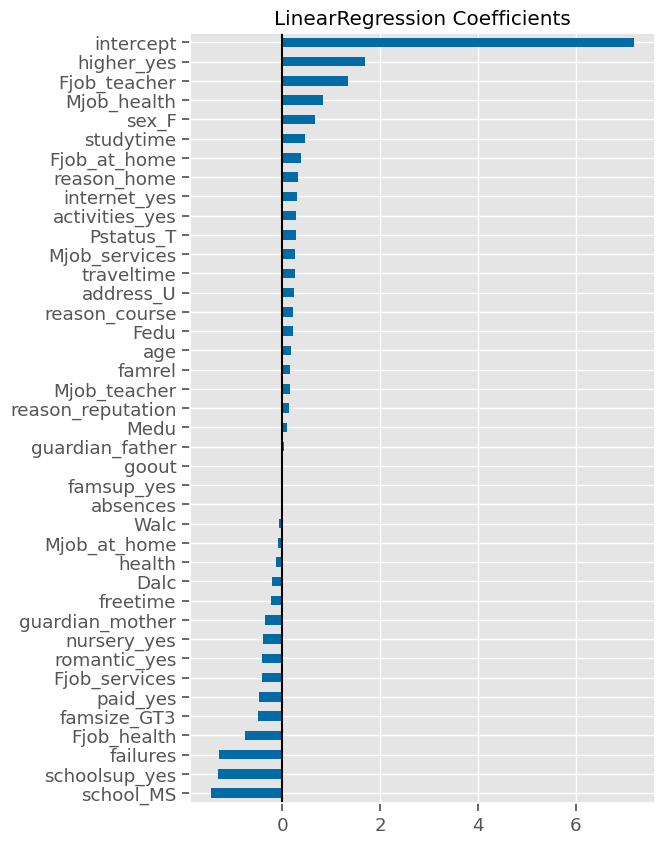

In [109]:
## Plot the coefficients
ax = coeffs.sort_values().plot(kind='barh',figsize=(6,10))
ax.axvline(0,color='k')
ax.set_title('LinearRegression Coefficients');



- When we have a large number of coefficients that are small, it can be helpful to only visualize the largest coefficients.
- Since we have both positive and negative values, we can't simply take the .head() or .tail() as we did with feature importances.

## Visualizing the Most Impactful Coefficients

- While our current dataset doesn't have an overwhelming number of features, that won't always be the case.
- What do we do when we want to visualize the coefficients for our model with 100 features?
- For feature importances, we took the top n most important features but the same approach would only take the largest positive coefficients.

The solution is to use the absolute value of the coefficients and then rank them to determine the n-largest (positive or negative).

- Pandas Series have a method for calculating the absolute value (.abs()) and for ranking values (.rank()).
    - Note that .rank() numbers the smallest value as 1 so the higher the rank the larger the coefficient.
- Let's calculate the ranks of the absolute values of our features and sort them.

In [110]:
coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
coeff_rank



intercept           40.00
higher_yes          39.00
school_MS           38.00
Fjob_teacher        37.00
schoolsup_yes       36.00
failures            35.00
Mjob_health         34.00
Fjob_health         33.00
sex_F               32.00
famsize_GT3         31.00
paid_yes            30.00
studytime           29.00
Fjob_services       28.00
romantic_yes        27.00
nursery_yes         26.00
Fjob_at_home        25.00
guardian_mother     24.00
reason_home         23.00
internet_yes        22.00
activities_yes      21.00
Pstatus_T           20.00
Mjob_services       19.00
traveltime          18.00
freetime            17.00
address_U           16.00
reason_course       15.00
Fedu                14.00
Dalc                13.00
age                 12.00
famrel              11.00
Mjob_teacher        10.00
reason_reputation    9.00
health               8.00
Mjob_at_home         7.00
Medu                 6.00
Walc                 5.00
guardian_father      4.00
absences             3.00
famsup_yes  

In [111]:
## Let's plot the 10 most impactful coefficients.

top_n_features = coeff_rank.head(10)
top_n_features



intercept       40.00
higher_yes      39.00
school_MS       38.00
Fjob_teacher    37.00
schoolsup_yes   36.00
failures        35.00
Mjob_health     34.00
Fjob_health     33.00
sex_F           32.00
famsize_GT3     31.00
dtype: float64

In [112]:
## Slicing out the top_n_features names to visualize
plot_vals = coeffs.loc[top_n_features.index]
plot_vals



intercept        7.18
higher_yes       1.69
school_MS       -1.46
Fjob_teacher     1.33
schoolsup_yes   -1.31
failures        -1.29
Mjob_health      0.82
Fjob_health     -0.77
sex_F            0.66
famsize_GT3     -0.49
dtype: float64

In [113]:
top_n = 15
coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
top_n_features = coeff_rank.head(top_n).index
plot_vals = coeffs.loc[top_n_features].sort_values()
plot_vals



school_MS       -1.46
schoolsup_yes   -1.31
failures        -1.29
Fjob_health     -0.77
famsize_GT3     -0.49
paid_yes        -0.48
Fjob_services   -0.42
romantic_yes    -0.42
nursery_yes     -0.40
studytime        0.46
sex_F            0.66
Mjob_health      0.82
Fjob_teacher     1.33
higher_yes       1.69
intercept        7.18
dtype: float64

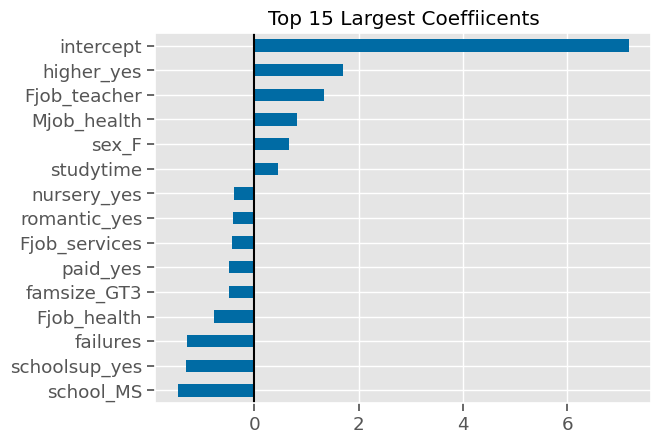

In [114]:
## Plot the coefficients
ax = plot_vals.sort_values().plot(kind='barh')#,figsize=(5,6))
ax.axvline(0,color='k')
ax.set_title(f'Top {top_n} Largest Coeffiicents');



Notice that our intercept was one of the largest coefficients. While this can be helpful for evaluation modeling decisions, it is not as helpful for a non-technical stakeholder.

We should convert our plotting code into a function and we should build in an argument that will give us the flexibility to decide when to include the intercept in the final plot or not.

We can accomplish this by adding a boolean argument to our function called intercept. If intercept is False, then we will drop the intercept from our series before we rank our coefficients and plot them.

Since we are focused on producing insights for our stakeholders this week, we will set the default value for this argument to False

## Functionizing Coefficient Visualization

In [115]:
def plot_coeffs(coeffs, top_n=None,  figsize=(4,5), intercept=False):
    if (intercept==False) & ('intercept' in coeffs.index):
        coeffs = coeffs.drop('intercept')
        
    if top_n==None:
        ## sort all features and set title
        plot_vals = coeffs.sort_values()
        title = "All Coefficients - Ranked by Magnitude"
    else:
        ## rank the coeffs and select the top_n
        coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
        top_n_features = coeff_rank.head(top_n)
        plot_vals = coeffs.loc[top_n_features.index].sort_values()
        ## sort features and keep top_n and set title
        title = f"Top {top_n} Largest Coefficients"
        
    ## plotting top N importances
    ax = plot_vals.plot(kind='barh', figsize=figsize)
    ax.set(xlabel='Coefficient', 
           ylabel='Feature Names', 
           title=title)
    ax.axvline(0, color='k')
    
    ## return ax in case want to continue to update/modify figure
    return ax



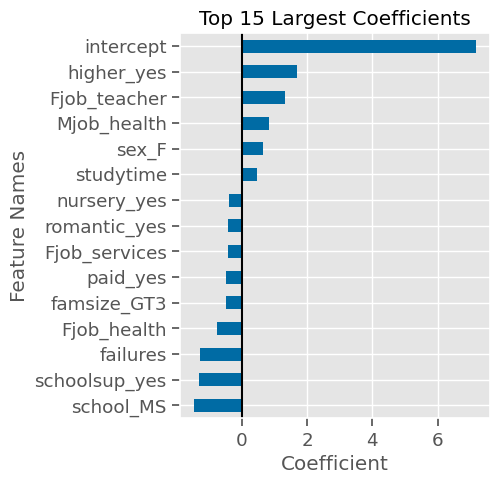

In [116]:
## Testing our function with intercept=True
ax= plot_coeffs(coeffs,top_n=15, intercept=True)



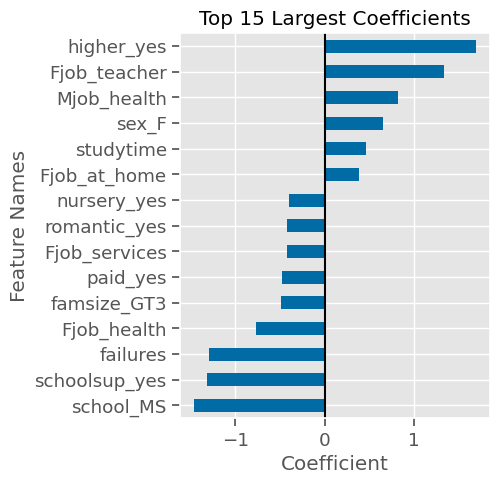

In [117]:
## Testing our function with intercept=False (the default)
ax= plot_coeffs(coeffs,top_n=15)



## Annotating Bar Graphs

- We can annotate the values of our bars programmatically using matplotlib's annotation functions and some knowledge about the structure of our figures.
- Matplotlib has a plt.annotate/ax.annotate function that allows us to add lines, arrows, and text annotations to our figure.
    - ax.annotate documentation
- the annotate function needs the text to annotate the "xy" coordinates at a minimum. But there are many additional parameters that we can provide to create more involved annotations.
    - For example, by also providing an "xytext" which will annotate the text at the xytext coordinates and then use a line to connect to the "xy" coordinates.
    - For most of our purposes, this coordinate system should be fine. But know that there are other options such as "figure fraction", which uses a proportion between 0 and 1 to represent the proportional distance on x and y.

## Coordinates for Annotations

- The annotate function has a "xycoords" argument that controls what type of coordinate system it should use to place the annotation.
- By default, the xycoords is set to use the "data". Meaning that the coordinates we provide correspond to values along the x and y axis, in the same units as our data.
- Example Annotations:
    - If we wanted to add a text annotation for the 5th bar(from the bottom of the y-axis) where the xaxis == 1, we would use:

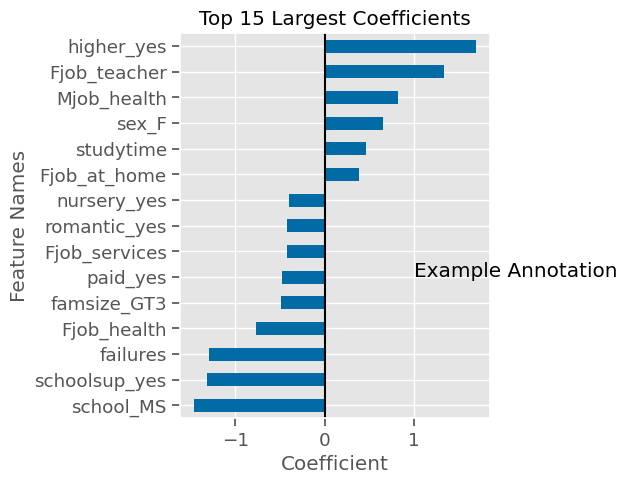

In [118]:
ax = plot_coeffs(coeffs, top_n=15)
ax.annotate("Example Annotation", xy=(1,5));


- By adding the xytext argument, we can offset the text from our xy coordinate.
- We can then use the arrowprops argument, which is a dictionary of parameters for lines/arrows.
    - For more information about what arguments are available for arrowprops, see the "FancyArrowPatch" documentation, which is linked in the ax.annotate documentation.

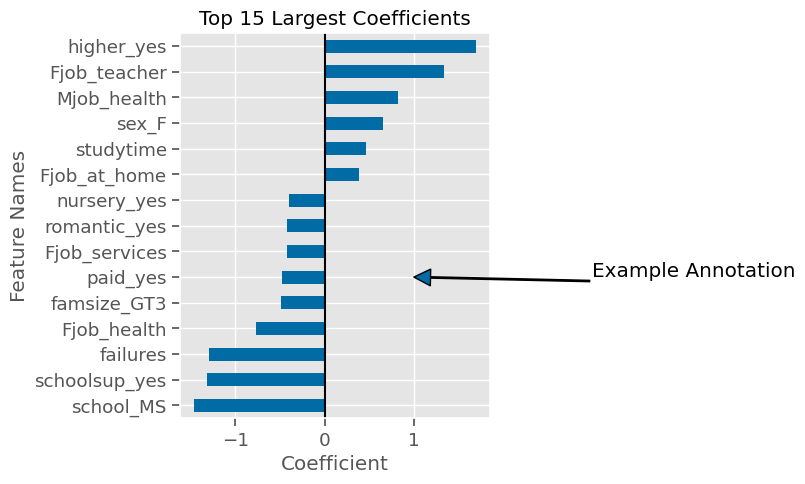

In [119]:
ax= plot_coeffs(coeffs,top_n=15)
ax.annotate("Example Annotation", xy=(1,5), xytext=(3,5),
            arrowprops={'width':1, 'ec':'k'});



**Notice that by default the annotation coordinates refer to the bottom left of the text. We can use the horizontal alignment "ha" and vertical alignment "va" arguments for ax.annotate to control this behavior.**

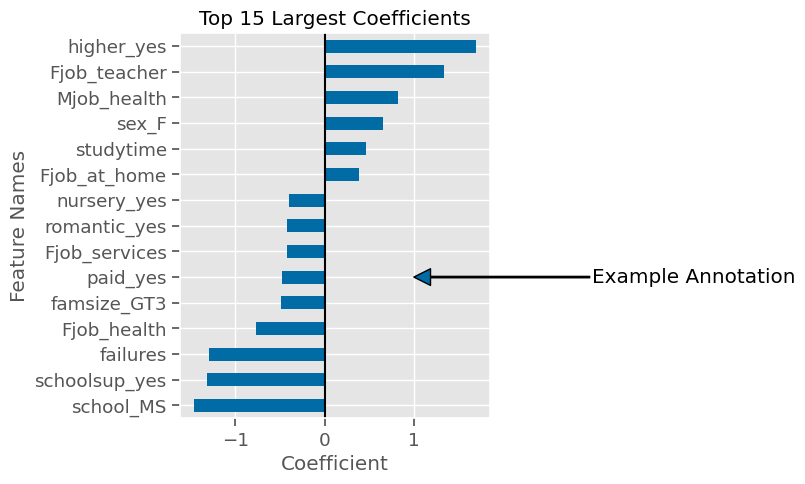

In [120]:
ax = plot_coeffs(coeffs, top_n=15)
ax.annotate("Example Annotation", xy=(1,5), xytext=(3,5), va='center',
            arrowprops={'width':1, 'ec':'k'});


## Annotating Bar Heights

- In order to programmatically annotate the values of each bar, we will need to determine the correct x and y coordinates for each bar.
- While we could use the series of coefficients to extract those values, it is not the most ideal solution, as we would need to provide that series and correctly slice out only the bars that were included in our graph.
- To make this process more streamlined and flexible, we can actually extract the coordinates from the bars themselves!
- Matplotlib figures are members of a class called Patch.
- We can also extract a list of all of the patches on an axis using the ax.patches attribute.

In [121]:
print(type(ax.patches))
print(len(ax.patches))
ax.patches[0]



<class 'matplotlib.axes._base._AxesBase.ArtistList'>
15


- As you can see above, we have a list of 15 patches, which is the number of bars on our bar graph.
- To extract the x and y coordinates from a patch, we can use the:
    - patch.get_height()
- Note on bar parameters with horizontal bar charts:
    - bar.get_width() will actually return the "height" of our bar. Just keep in mind that the naming scheme of the methods is based on a normal bar chart and that we will need to swap x/y height/width.

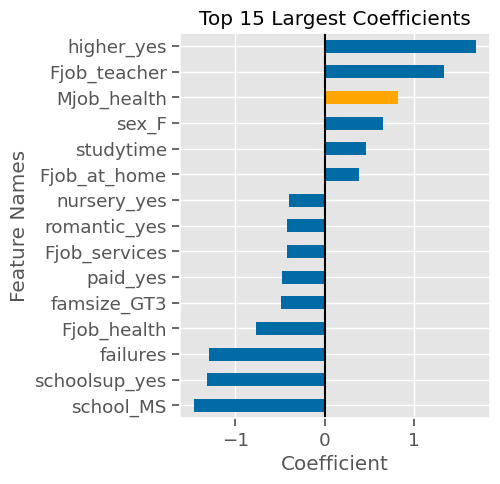

In [122]:
ax= plot_coeffs(coeffs,top_n=15)
## slicing out a test bar and changing its color to identify index
bar = ax.patches[12]
bar.set_facecolor('orange')



In [123]:
## get height returns the width of the bar for barh
bar.get_height()



0.5

In [124]:
## get width returns the height of the bar (the coefficient to annotate)
bar.get_width()



0.821767328528554

In [125]:
## get_x will return top-left coordinate of bar (which is at x=0)
bar.get_x()



0

In [126]:
## returns the bottom coordinate of the bar
bar.get_y()



11.75

- The bar is centered on y=12 (the 12th bar) from the bottom.
    - The bar is 0.5 wide.
    - Therefore the bar is centered at 18 but extends down to 11.75 and up to 12.25
- To get the coefficient value to annotate, we will take the "width" of the bar.
- To calculate the center of the bar, we need to add the height of the bar/2 to the y-position of the bar.

In [127]:
## calculate center of bar
bar_ax = bar.get_y() + bar.get_height()/2
bar_ax



12.0

In [128]:
## get the value to annotate
val = bar.get_width()
val



0.821767328528554

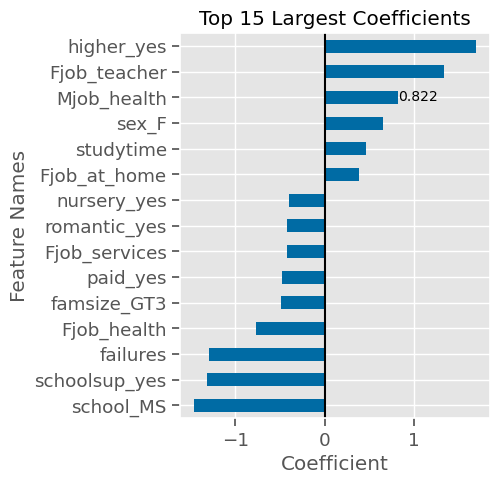

In [129]:
## Demonstrating Annotating the value of the bar:



ax= plot_coeffs(coeffs,top_n=15)
## slicing out a test bar and changing its color to identify index
bar = ax.patches[12]
## calculate center of bar
bar_ax = bar.get_y() + bar.get_height() / 2
## get the value to annotate
val = bar.get_width()
# ha and va stand for the horizontal and vertical alignment
ax.annotate(f"{val:.3f}",
                 (val, bar_ax), ha='left', va='center', size=10) ;



- We can use the xytext arg to move the text and the textcoords arg to tell indicate we are using "offset points"

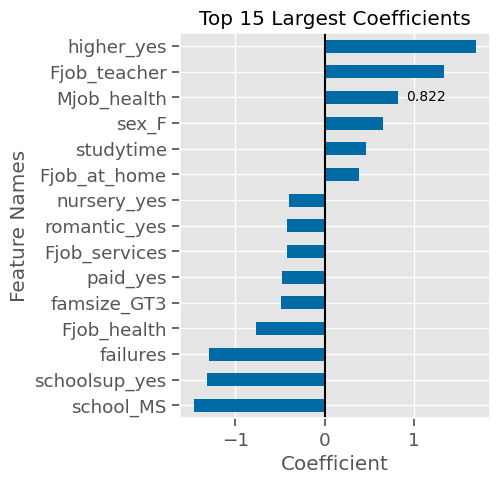

In [130]:
ax= plot_coeffs(coeffs, top_n=15)
## slicing out a test bar and changing its color to identify index
bar = ax.patches[12]
## calculate center of bar
bar_ax = bar.get_y() + bar.get_height() / 2
## get the value to annotate
val = bar.get_width()
# ha and va stand for the horizontal and vertical alignment
ax.annotate(f"{val:.3f}",
                 (val,bar_ax), ha='left', va='center', size=10,
           xytext=(6, 0), textcoords='offset points') ;



- Now that we have 1 bar figured out, let's make a loop to apply this to all bars.

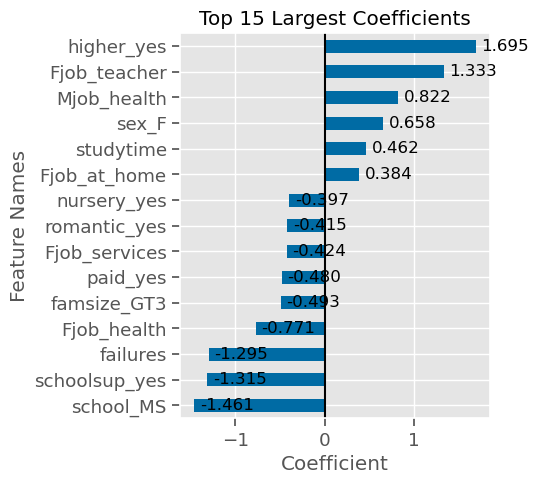

In [131]:
ax= plot_coeffs(coeffs,top_n=15)
for bar in ax.patches:
    ## calculate center of bar
    bar_ax = bar.get_y() + bar.get_height()/2
    ## get the value to annotate
    val = bar.get_width()
    # ha and va stand for the horizontal and vertical alignment
    ax.annotate(f"{val:.3f}", (val,bar_ax),
                ha='left',va='center',size=12,
                xytext=(4,0), textcoords='offset points') 



- As we can see above, this approach doesn't handle negative bars very well. It is still placing the annotation at the same place relative to the top of the bar. However, our bars for negative coefficients overlap with our annotation.
- We can fix this by doing 2 things:
    - Using a different variable for the value to label (val) and the value that is the top of the bar's position (val_pos)).
    - Checking the val of bar, and if the value is less than 0, we can use set our val_pos to 0; otherwise, val_pos will be equal to val.

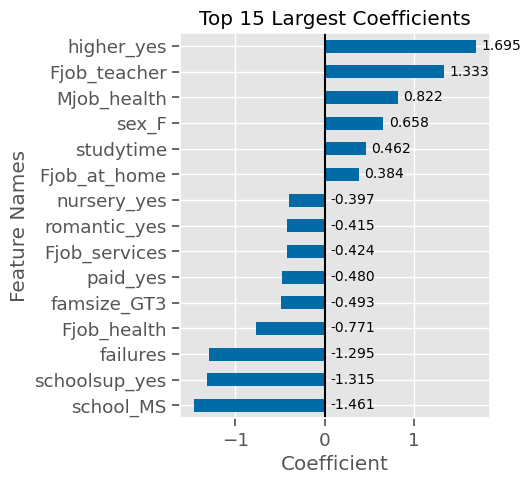

In [132]:
ax = plot_coeffs(coeffs,top_n=15)
for bar in ax.patches:
    ## calculate center of bar
    bar_ax = bar.get_y() + bar.get_height() / 2
    ## get the value to annotate
    val = bar.get_width()
    
    if val < 0:
        val_pos = 0
    else:
        val_pos = val
    
    # ha and va stand for the horizontal and vertical alignment
    ax.annotate(f"{val:.3f}", (val_pos,bar_ax),
                ha='left', va='center',size=10,
                xytext=(4,0), textcoords='offset points')


## Functionalizing Annotating Horizontal Bars

In [133]:
def annotate_hbars(ax, ha='left', va='center', size=12, xytext=(4,0),
                  textcoords='offset points'):
    for bar in ax.patches:
    
        ## calculate center of bar
        bar_ax = bar.get_y() + bar.get_height() / 2
        ## get the value to annotate
        val = bar.get_width()
        if val < 0:
            val_pos = 0
        else:
            val_pos = val
        # ha and va stand for the horizontal and vertical alignment
        ax.annotate(f"{val:.3f}", (val_pos,bar_ax), ha=ha, va=va, size=size,
                        xytext=xytext, textcoords=textcoords)


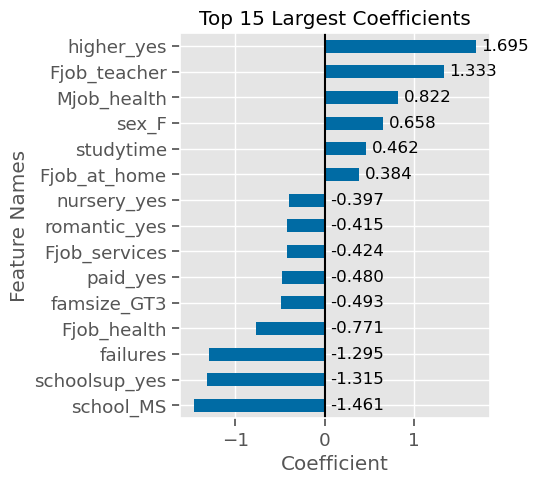

In [134]:
ax = plot_coeffs(coeffs,top_n=15)
annotate_hbars(ax)



## Final step: adding annotations to plot_coeffs

In [135]:
def plot_coeffs(coeffs, top_n=None, figsize=(4,5), 
                intercept=False, intercept_name="intercept", 
                annotate=False, ha='left', va='center', size=12, 
                xytext=(4,0), textcoords='offset points'):
    """ Plots the top_n coefficients from a Series, with optional annotations.
    """
    # Drop intercept if intercept=False and 
    if (intercept == False) & (intercept_name in coeffs.index):
        coeffs = coeffs.drop(intercept_name)
    if top_n == None:
        ## sort all features and set title
        plot_vals = coeffs.sort_values()
        title = "All Coefficients - Ranked by Magnitude"
    else:
        ## rank the coeffs and select the top_n
        coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
        top_n_features = coeff_rank.head(top_n)
        
        ## sort features and keep top_n and set title
        plot_vals = coeffs.loc[top_n_features.index].sort_values()
        title = f"Top {top_n} Largest Coefficients"
    ## plotting top N importances
    ax = plot_vals.plot(kind='barh', figsize=figsize)
    ax.set(xlabel='Coefficient', 
            ylabel='Feature Names', 
            title=title)
    ax.axvline(0, color='k')
    if annotate == True:
        annotate_hbars(ax, ha=ha, va=va, size=size, xytext=xytext, textcoords=textcoords)
    return ax


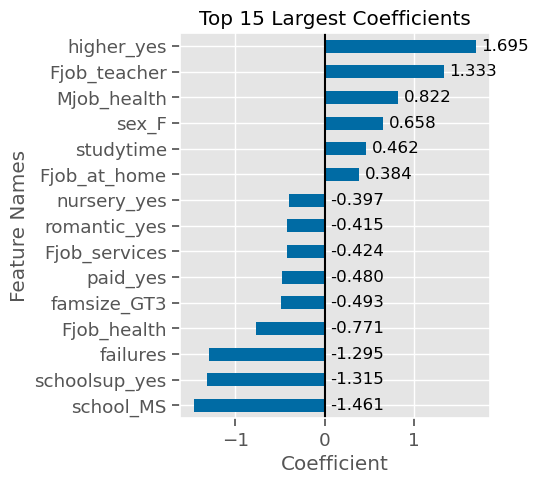

In [136]:
plot_coeffs(coeffs, top_n=15, annotate=True);


## Additional Resources

See the following resources for more details and examples on annotating with matplotlib.

- Medium Article: Annotating in Matplotlib
- Matplotlib Tutorial: Advanced Annotations

## Interpreting Coefficients - Linear Regression

- Let's put it all together and interpret our coefficients!

**Reminder: Interpreting Coefficients**

When interpreting coefficients we need to keep in mind what transformations have been applied to our features.

- If its a numeric feature and it has NOT been scaled:
    - The coefficient tells us "When I increase the value for this feature by 1 unit, this is the change in the target."
- If its a numeric feature that has been scaled using Z-scores/StandardScaler:
    - The coefficient tells us "When I increase the value for this feature by 1 Standard Deviation this is the change in the target."
- If it's a One-Hot Encoded categorical feature:
    - The coefficient tells us "If you belong to this category, this will be the change in the target."

Training Data:	R^2= 0.35	RMSE= 2.65
Test Data:	R^2= 0.35	RMSE= 2.45


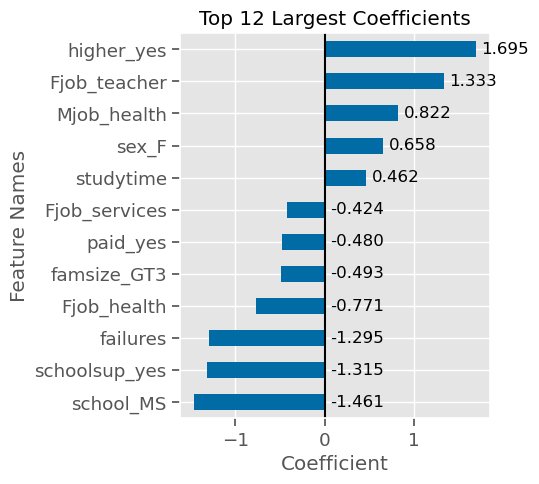

In [137]:
lin_reg = LinearRegression()
lin_reg.fit(X_train_df,y_train)
evaluate_regression(lin_reg, X_train_df, y_train, X_test_df,y_test)
coeffs = get_coeffs_linreg(lin_reg)
plot_coeffs(coeffs,top_n=12,annotate=True);



## Interpreting Our Model's Coefficients

- Intercept:
    - Our model assumed a baseline score of 7.176
- Coefficients that Positively Influence Final Grade:
    - higher_yes (student intends to continue higher education):
        - Being in the yes group (wanting higher education) increases their grade by 1.695 (out of 20).
    - Fjob_teacher (father is an educator):
        - Having a father who is a teacher increases their grade by 1.33.
    - Mjob_health:
        - Having a mother who works in healthcare increases the predicted grade by 0.8.
    sex_F:
       - Being female increases the predicted grade by 0.65.
    studytime:
        - Increasing studytime hours by 1 (according to the ordinal scale) increases the predicted grade by 0.46.
        - studytime (numeric: 1 - <2 hours, 2 - 2 to 5 hours, 3 - 5 to 10 hours, or 4 - >10 hours).
- Coefficients that Negatively Influence Final Grade:
    - school_MS:
        - Attending MS subtracted 1.461 points.
    - schoolsup_yes (getting extra education support):
        - student getting extra support decreases the predicted score by 1.3. While this may seem paradoxical at first (why would a student with MORE help perform worse?), this could represent the effect of the student needing the extra help in the first place.
    - failures:
        - for every 1 failure, the predicted score decreases by 1.295.
    - Fjob_health:
        - Interestingly, as opposed to having a Mother in healthcare, having a father in healthcare decreases the predicted grade by .771.
    - famesize_GT3:
        - Having a larger family (more than 3) decreases the predicted grade by .493.

**Summary**

This lesson showed how to create high-quality visuals of our regression coefficients. We also interpreted our coefficients to help understand what leads to a higher or lower G3 grade. However, as we discussed in the previous lesson, if our model does not perform very well overall, we cannot trust the parameters/coefficients that it determined. One solution is to include G1 and G2 to improve performance, but that only addresses part of our use case in which students entering the third period are being identified. It does not address the use case in which our stakeholders want to intervene before students have those grades.

In the next lesson, we will take a step back and re-evaluate our business case and consider converting our regression task for improved performance and interpretability.


# Saving & Loading Models (joblib)

**Learning Objectives:**

- Define serialization and why its important for data science
- Save models and variables as organized joblib files.
- Load models and variables from a joblib file.

## Serialization

In order to save and reuse/deoply a previously trained model, the model must be converted into a form that can be saved and loaded again. This process is called "serialization."

"Serialization is the process of converting a data structure or object into a data format that can be stored . . . or transmitted . . . and reconstructed later. . ." - Serialization (Wikipedia)

Python comes with a built-in module for serialization called pickle, which can save objects as .pickle files. However, it is not the method that is recommended by scikit-learn.

According to scikit-learn's Model Persistence page from the User Guide: "In the specific case of scikit-learn, it may be better to use joblib’s replacement of pickle (dump & load), which is more efficient on objects that carry large numpy arrays internally as is often the case for fitted scikit-learn estimators. . ."

As data scientists, our primary use case for serialization is for saving models and preprocessing tools. We will therefore use the tool recommended by scikit-learn: joblib.

### Saving Models & Objects with joblib

- First, let's train and evaluate the model we are going to save, so we can verify that the loaded model is indeed the same model. 

In [138]:
## Fitting and evaluating the model
rf_reg = RandomForestRegressor()
rf_reg.fit(X_train_df, y_train)
evaluate_regression(rf_reg, X_train_df, y_train, X_test_df, y_test)


Training Data:	R^2= 0.90	RMSE= 1.05
Test Data:	R^2= 0.34	RMSE= 2.46


- Next, we will create a collection of variables we want to export to use in a subsequent notebook/analysis.  To make it easy to remember which variable was which, we will save the data and model in a dictionary with informative key names.
    - We will save our:
        - Training and test data
        - Our preprocessing column transformer
        - Our model

- Finally, we will save the dictionary to a joblib file.
    - While pickle is a common tool used for this, the joblib package has become increasingly popular. Scikit-learn now promotes joblib files as the best way to save models.
    - Here is the section of the User Guide on "Serializing models" where they demonstrate using joblib.

In [139]:
## saving variables for next lesson/notebook
import joblib
## creating a dictionary of all of the variables to save for later
export = {'X_train':X_train_df,
         'y_train': y_train,
         'X_test':X_test_df,
          "y_test": y_test,
         'preprocessor':preprocessor,
         'RandomForest':rf_reg}
joblib.dump(export, 'random_forest_l01.joblib')



['random_forest_l01.joblib']

- The joblib file is now saved and can be moved or transmitted like any other file on your computer. 

### Loading Objects from a Joblib File

- To load in the joblib in the future, we will just use joblib.load and can then slice out the keys from our dictionary to create new variables.
    - Note: if we did not save our variables in a dictionary first, we would need to remember the variable names based on their original order when the joblib file was saved.

In [140]:
import joblib
loaded = joblib.load('random_forest_l01.joblib')
loaded.keys()



dict_keys(['X_train', 'y_train', 'X_test', 'y_test', 'preprocessor', 'RandomForest'])

In [141]:
X_train_df = loaded['X_train']
y_train = loaded['y_train']
X_test_df = loaded['X_test']
y_test = loaded['y_test']
preprocessor = loaded['preprocessor']
loaded_model = loaded['RandomForest']



- Notably, the variables are all fully intact, previous fitting and all.

Training Data:	R^2= 0.90	RMSE= 1.05
Test Data:	R^2= 0.34	RMSE= 2.46


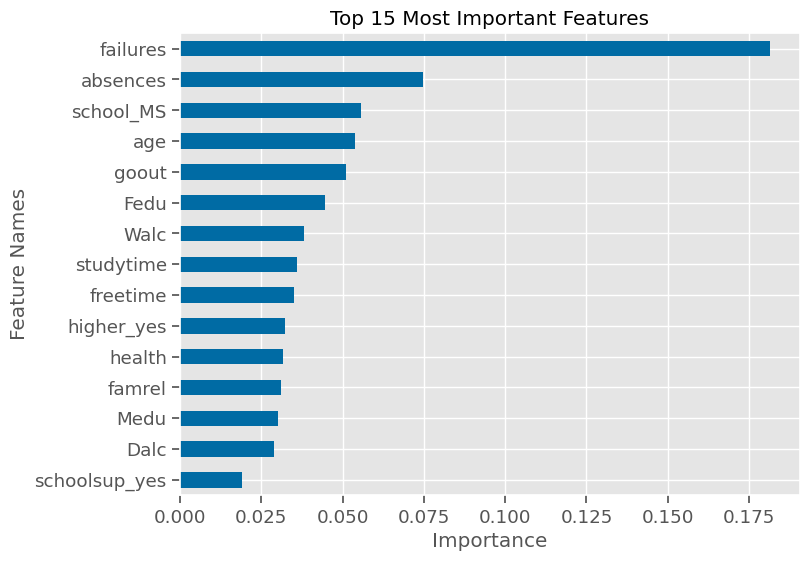

In [142]:
evaluate_regression(loaded_model,X_train_df, y_train, X_test_df,y_test)
loaded_importances = get_importances(loaded_model)
plot_importance_color(loaded_importances,top_n=15,color_dict=None);



**Summary**

In this lesson, we introduced the concept of serialization and why it is needed for data science. We walked through scikit-learn's recommended tool for serialization: joblib.

You will be saving and loading models and other variables from joblib files in upcoming assignments. 

# Extracting Insights from a Pipeline

**Learning Objectives:**

By the end of this assignment, students will be able to:

- Extract coefficients and feature names from within a modeling pipeline.

In stack 2, we always combined our ColumnTransformer and model together in a final modeling pipeline. Let's create and fit a Linear Regression pipeline and a DecisionTreeRegressor pipeline using this approach.

**Preprocessing**

In [143]:
## Typical Imports
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
## Modeling & preprocessing import
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder,StandardScaler
from sklearn.compose import ColumnTransformer,make_column_transformer,make_column_selector
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer



In [144]:
## Load dataset from published web view link
import pandas as pd
fpath ="https://docs.google.com/spreadsheets/d/e/2PACX-1vS6Sn9LaMSc_E1EHQpuRK6BTpKp6h27obTP_dTpAVu_xtoqsge30jBGh9vYlO4DYe-utRKMgMqYChU_/pub?output=csv"
df = pd.read_csv(fpath)
df.head(3)



,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.02,Dairy,249.81,OUT049,1999,Medium,Tier 1,Supermarket Type1,"3,735.14"
1,DRC01,5.92,Regular,0.02,Soft Drinks,48.27,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.42
2,FDN15,17.50,Low Fat,0.02,Meat,141.62,OUT049,1999,Medium,Tier 1,Supermarket Type1,"2,097.27"


In [145]:
## replace inconsistent categories
fat_content_map = {'LF':'Low Fat',
                   'reg':'Regular',
                   'low fat':'Low Fat'}
df['Item_Fat_Content'] = df['Item_Fat_Content'].replace(fat_content_map)
## Verify 
df['Item_Fat_Content'].value_counts()



Item_Fat_Content
Low Fat    5517
Regular    3006
Name: count, dtype: int64

In [146]:
## Define X and y
target = 'Item_Outlet_Sales'
X = df.drop(columns=target).copy()
y = df[target].copy()
X



,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,FDA15,9.30,Low Fat,0.02,Dairy,249.81,OUT049,1999,Medium,Tier 1,Supermarket Type1
1,DRC01,5.92,Regular,0.02,Soft Drinks,48.27,OUT018,2009,Medium,Tier 3,Supermarket Type2
2,FDN15,17.50,Low Fat,0.02,Meat,141.62,OUT049,1999,Medium,Tier 1,Supermarket Type1
3,FDX07,19.20,Regular,0.00,Fruits and Vegetables,182.09,OUT010,1998,NaN,Tier 3,Grocery Store
4,NCD19,8.93,Low Fat,0.00,Household,53.86,OUT013,1987,High,Tier 3,Supermarket Type1
...,...,...,...,...,...,...,...,...,...,...,...
8518,FDF22,6.87,Low Fat,0.06,Snack Foods,214.52,OUT013,1987,High,Tier 3,Supermarket Type1
8519,FDS36,8.38,Regular,0.05,Baking Goods,108.16,OUT045,2002,NaN,Tier 2,Supermarket Type1
8520,NCJ29,10.60,Low Fat,0.04,Health and Hygiene,85.12,OUT035,2004,Small,Tier 2,Supermarket Type1
8521,FDN46,7.21,Regular,0.15,Snack Foods,103.13,OUT018,2009,Medium,Tier 3,Supermarket Type2


In [147]:
## Drop unwanted/inappropriate columns 
bad_cols = ['Item_Identifier','Outlet_Identifier','Outlet_Establishment_Year']
X = X.drop(columns=bad_cols)
## Perform a train-test-split
X_train, X_test, y_train, y_test = train_test_split(X,y, random_state=42)


## Making a Preprocessing Pipeline

In [148]:
## Create categorical pipeline
cat_selector = make_column_selector(dtype_include='object')
# create pipeline for handling categorical data
impute_most_freq = SimpleImputer(strategy='most_frequent')
encoder = OneHotEncoder(handle_unknown='ignore',sparse=False)
cat_pipe = make_pipeline(impute_most_freq,encoder)
## Create numeric pipelien
num_selector = make_column_selector(dtype_include='number')
num_selector(X_train)
# create pipeline for handling categorical data
impute_mean = SimpleImputer(strategy='mean')
scaler = StandardScaler()
num_pipe = make_pipeline(impute_mean, scaler)
## Combine into 1 column transformer
preprocessor = make_column_transformer( (cat_pipe,cat_selector),
                                       (num_pipe,num_selector),
                                      verbose_feature_names_out=False)
preprocessor


ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x00000199D703FFA0>),
                                ('pipeline-2',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer()),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x00000199D703F070>)],
                  verbose_feature_names_out=False)

## Modeling 

### Model 1 - LinearReression

In [149]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score,mean_squared_error



In [150]:
## Make & Fit the modeling pipeline
pipe = make_pipeline(preprocessor, LinearRegression())
pipe.fit(X_train, y_train)
## Quick peek at the R^2 value for test data
print(f"Training R2: {pipe.score(X_train,y_train) :.3f}")
print(f"Test R2: {pipe.score(X_test,y_test): .3f}")



Training R2: 0.561
Test R2:  0.566


### Model 2 - Decision Tree Regressor

In [151]:
from sklearn.tree import DecisionTreeRegressor



In [152]:
## Make and fit model
tree_pipe = make_pipeline(preprocessor,DecisionTreeRegressor())
tree_pipe.fit(X_train, y_train)
## Quick peek at the R^2 value for test data
print(f"Training R2: {tree_pipe.score(X_train,y_train) :.3f}")
print(f"Test R2: {tree_pipe.score(X_test,y_test): .3f}")



Training R2: 1.000
Test R2:  0.111


## Extracting Values from a Modeling Pipeline

If you want to extract the feature importances or coefficients from your model, you can do so without creating your X_train and X_test data as DataFrames.

Instead, we will need to slice out the correct object in our modeling pipeline for each piece of information we need (feature names vs. coefficients/importances).

### **Extracting Feature Names and Model Parameters from a Pipeline**

- First, make sure you have already fit your modeling pipeline and are working below that point in your notebook.
- Pipelines can be sliced as if they were a list - with square brackets and a numeric index.
- Right now, we have a fit modeling pipeline with 2 components:
    - the preprocessing ColumnTransformer (with the method to get our feature names: .get_feature_names_out()).
    - your model (with your .feature_importances or .coef_).

In [153]:
pipe



Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('pipeline-1',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse=False))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x00000199D703FFA0>),
                                                 ('pipeline-2',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer()),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x00000199D703F070>)],
                                   verbose_feature_names_out=False)),
                ('linearregression', LinearRegression())])

### Extracting the feature names

- The ColumnTransformer is the first item in the pipeline, so it is index 0.
- Therefore, to slice out the pipeline and run the get_feature_names_out method we would use:

In [154]:
# Extracting the feature names from the pipeline
feature_names = pipe[0].get_feature_names_out()
feature_names



array(['Item_Fat_Content_Low Fat', 'Item_Fat_Content_Regular',
       'Item_Type_Baking Goods', 'Item_Type_Breads',
       'Item_Type_Breakfast', 'Item_Type_Canned', 'Item_Type_Dairy',
       'Item_Type_Frozen Foods', 'Item_Type_Fruits and Vegetables',
       'Item_Type_Hard Drinks', 'Item_Type_Health and Hygiene',
       'Item_Type_Household', 'Item_Type_Meat', 'Item_Type_Others',
       'Item_Type_Seafood', 'Item_Type_Snack Foods',
       'Item_Type_Soft Drinks', 'Item_Type_Starchy Foods',
       'Outlet_Size_High', 'Outlet_Size_Medium', 'Outlet_Size_Small',
       'Outlet_Location_Type_Tier 1', 'Outlet_Location_Type_Tier 2',
       'Outlet_Location_Type_Tier 3', 'Outlet_Type_Grocery Store',
       'Outlet_Type_Supermarket Type1', 'Outlet_Type_Supermarket Type2',
       'Outlet_Type_Supermarket Type3', 'Item_Weight', 'Item_Visibility',
       'Item_MRP'], dtype=object)

- Note: if you are seeing pipeline-1__ and pipeline-2__ in your feature names, you must scroll back up to where you ran the make_column_transformer function and add verbose_feature_names_out=False.
    - Make sure to Restart and Run All once you've added this argument.

### Extracting the coefficients

- The model is the last item in the pipeline, so it is index -1. Once we've sliced out the model, we can use the access .coef_ or .feature_importances_ attributes.
- Therefore, in order to slice out the coefficients from a Linear Regression model from the pipeline in our pipeline, we would use:

In [155]:
# Extracting the ceofficients from the pipeline
pipe[-1].coef_



array([  -31.65955127,    31.65955127,   -17.81055932,   -47.32912632,
          29.49155537,     8.35511513,  -124.04362252,   -19.58098541,
          26.16520702,    -5.23964289,     9.38658377,   -14.19946577,
         -27.37097996,   -49.6573709 ,   300.96692908,   -38.72762819,
         -59.14397686,    28.73796777,    27.06634502,   -25.31147112,
          -1.7548739 ,    -2.52864461,    12.59945834,   -10.07081373,
       -1741.06799063,   199.41105623,   -83.15064385,  1624.80757825,
          -7.35798529,   -21.77257164,   984.31470151])

### Putting it all together

- Now, we just need to create our panda's Series but using the values extracted from our pipeline.

#### Extracting Regression Coefficients

In [156]:
feature_names = pipe[0].get_feature_names_out()
coeffs = pd.Series(pipe[-1].coef_, index=feature_names)
coeffs



Item_Fat_Content_Low Fat             -31.66
Item_Fat_Content_Regular              31.66
Item_Type_Baking Goods               -17.81
Item_Type_Breads                     -47.33
Item_Type_Breakfast                   29.49
Item_Type_Canned                       8.36
Item_Type_Dairy                     -124.04
Item_Type_Frozen Foods               -19.58
Item_Type_Fruits and Vegetables       26.17
Item_Type_Hard Drinks                 -5.24
Item_Type_Health and Hygiene           9.39
Item_Type_Household                  -14.20
Item_Type_Meat                       -27.37
Item_Type_Others                     -49.66
Item_Type_Seafood                    300.97
Item_Type_Snack Foods                -38.73
Item_Type_Soft Drinks                -59.14
Item_Type_Starchy Foods               28.74
Outlet_Size_High                      27.07
Outlet_Size_Medium                   -25.31
Outlet_Size_Small                     -1.75
Outlet_Location_Type_Tier 1           -2.53
Outlet_Location_Type_Tier 2     

#### Extracting Feature Importances

In [157]:
feature_names = tree_pipe[0].get_feature_names_out()
importances = pd.Series(tree_pipe[-1].feature_importances_, index=feature_names)
importances



Item_Fat_Content_Low Fat          0.00
Item_Fat_Content_Regular          0.00
Item_Type_Baking Goods            0.00
Item_Type_Breads                  0.00
Item_Type_Breakfast               0.00
Item_Type_Canned                  0.00
Item_Type_Dairy                   0.01
Item_Type_Frozen Foods            0.01
Item_Type_Fruits and Vegetables   0.01
Item_Type_Hard Drinks             0.00
Item_Type_Health and Hygiene      0.00
Item_Type_Household               0.01
Item_Type_Meat                    0.00
Item_Type_Others                  0.00
Item_Type_Seafood                 0.00
Item_Type_Snack Foods             0.01
Item_Type_Soft Drinks             0.01
Item_Type_Starchy Foods           0.00
Outlet_Size_High                  0.00
Outlet_Size_Medium                0.01
Outlet_Size_Small                 0.01
Outlet_Location_Type_Tier 1       0.01
Outlet_Location_Type_Tier 2       0.01
Outlet_Location_Type_Tier 3       0.00
Outlet_Type_Grocery Store         0.19
Outlet_Type_Supermarket T

### Summary

In this short optional lesson, we reviewed how to extract our feature names, coefficients, and feature importances from a modeling pipeline.

# From Regression to Classification

**Learning Objectives:**

- Identify the utility of converting regression tasks to classification tasks.
- To thoughtfully determine the target class.
- To explain classification feature importances.

## Moving From Regression to Classification

- Previously, we've created several regression models to predict the final grade for our students.
- We saw that once we removed G1 and G2 grades, it became much more difficult to predict their final score.
- Since we cannot trust our models' predictions, we cannot trust the insights/explanations we extract from the model.
- Our stakeholder's goal is to identify at-risk students before their final grade in order to intervene and provide additional support to those students. The stakeholder never said that they need to know the EXACT GRADE for each student.

In this situation, it makes perfect sense to convert this task into a classification that better addresses our stakeholder business case.


### Custom Functions

We've included several functions in the previous lessons this week that we will be using in this analysis. To save space, the function definitions have been removed from this lesson. 

Revisit the previous lessons for the code that corresponds to the following custom functions:

- get_importances (from the Feature Importance lesson)
- plot_importances (from the Feature Importance lesson)
- get_color_dict (from Permutation Importance lesson)
- annotate_hbars (from Visualizing Coefficients lesson)
- plot_coeffs (from Visualizing Coefficients lesson)

In [158]:
## Our standard imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
## Preprocessing tools
from sklearn.model_selection import train_test_split
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
## Models & evaluation metrics
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
import joblib
## setting random state for reproducibility
SEED = 321
np.random.seed(SEED)
## set text displays for sklearn
from sklearn import set_config
set_config(display='text')
## Using pd.set_option to display more columns
pd.set_option('display.max_columns',50)


#### Plot Styles

In [159]:
import matplotlib.pyplot as plt
import seaborn as sns
fav_style = ('ggplot','tableau-colorblind10')
fav_context  ={'context':'notebook', 'font_scale':1.2}
plt.style.use(fav_style)
sns.set_context(**fav_context)
plt.rcParams['savefig.transparent'] = False
plt.rcParams['savefig.bbox'] = 'tight'



#### Preprocessing

In [160]:
## Load in the student performance - Portuguese dataset & display the head and info
url = "https://docs.google.com/spreadsheets/d/e/2PACX-1vS6xDKNpWkBBdhZSqepy48bXo55QnRv1Xy6tXTKYzZLMPjZozMfYhHQjAcC8uj9hQ/pub?output=xlsx"
df = pd.read_excel(url,sheet_name='student-por')
df.info()
df.head(3)



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 649 entries, 0 to 648
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   school      649 non-null    object
 1   sex         649 non-null    object
 2   age         649 non-null    int64 
 3   address     649 non-null    object
 4   famsize     649 non-null    object
 5   Pstatus     649 non-null    object
 6   Medu        649 non-null    int64 
 7   Fedu        649 non-null    int64 
 8   Mjob        649 non-null    object
 9   Fjob        649 non-null    object
 10  reason      649 non-null    object
 11  guardian    649 non-null    object
 12  traveltime  649 non-null    int64 
 13  studytime   649 non-null    int64 
 14  failures    649 non-null    int64 
 15  schoolsup   649 non-null    object
 16  famsup      649 non-null    object
 17  paid        649 non-null    object
 18  activities  649 non-null    object
 19  nursery     649 non-null    object
 20  higher    

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,4,0,11,11
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,2,9,11,11
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,0,yes,no,no,no,yes,yes,yes,no,4,3,2,2,3,3,6,12,13,12


### Rethinking Our Target

- We need to determine what qualifies as an "at-risk" student for our stakeholder?
    - Note: talking to your stakeholder is ALWAYS a good idea when making this choice.
- There are several different ways we could define an at-risk student.
    - Students in the 30 percentile or lower (the bottom third of students).
    - Students who fail (receive an F).
    - Students who receive a D or an F in their final period.
- After talking with our stakeholder, we've agreed that predicting which students will receive an F would be the most effective target.
- First, we must convert the student scores into a letter grade.

#### Calculating Letter Grades from G3

- We want to determine which students will receive an F for their G3 score. Right now, we have the grades as values out of 20.
- The school informed us that when they determine letter grades, they:
    - First, convert the raw scores out of 20 into % out of 100.
    - Bin the % grades to determine the letter:
        - 'A': if G3>=90
        - 'B': if G3>= 80 & G3 <90
        - 'C': if G3>= 70 & G3 <80
        - 'D': if G3>= 60 & G3 < 70
        - 'F': if G3 is <60
- Our first task is to convert the G3 scores into %'s.


In [161]:
## convert G3 to a % out of 100
df['G3(%)'] = (df['G3']/20) *100
df['G3(%)'].head()



0   55.00
1   55.00
2   60.00
3   70.00
4   65.00
Name: G3(%), dtype: float64

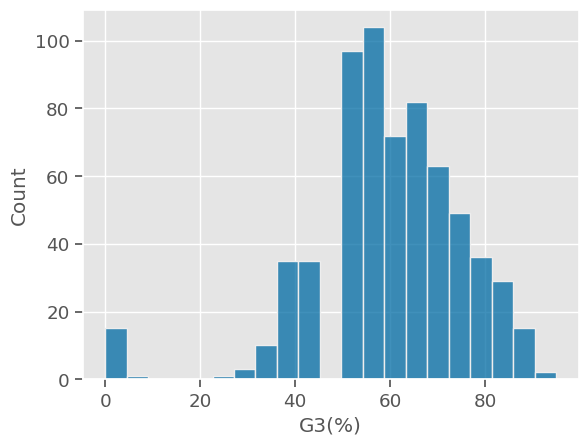

In [162]:
## visual distribution of % grades
ax = sns.histplot(data=df, x='G3(%)')




- Next we need to bin the percentages into letter grades. While there are many ways to do this, one of the most effective is to use panda's cut function.

#### Using pd.cut

- Documentation for pd.cut
    - pd.cut is a very flexible function. If we simply knew how many bins we need but don't care about the actual cutoffs for each bin, we can simply provide it an integer for the number of bins.
- For our needs, we will provide a list of the exact bin edges that will be used to cut the data.

    - Note that when we are providing a list of bin edges, we need to provide 1 more value than the # of bins we want to have. - For example, we want to bin the % grades into 5 bins: F,D,C,B,A - In order to create a list of bin edges, the very first value we include is the lowest possible value that is included in the lowest bin. Since we need to account for scores as low as 0, we need to have our first bin edge start at 0. - Next, we define the right edge of the our lowest bin. Since we are binning 0 - 60 as F, the right edge will be 60. - thus far we have used [0,60] to define the left and right edges of our First bin. - For the remainder of the bins, the right edge of the previous bin is also the left edge of the next bin. - Therefore, we only need to add 70 to our bin edges to define our second bin.



In [163]:
## defining bin edges
bins = [0,60,70,80,90,100]
grades = pd.cut(df['G3(%)'], bins=bins)
grades.value_counts().sort_index()




G3(%)
(0, 60]      358
(60, 70]     145
(70, 80]      85
(80, 90]      44
(90, 100]      2
Name: count, dtype: int64


- Looking at the value counts above, we can see the name of the first group is: "(0,60]", the second is "(60,70]" and so on.
    - When displaying intervals/bins, pandas uses square brackets to indicate when the number is INCLUDED in the bin or a round bracket if the number is not included in the bin.
- So in the example above:
    - (0,60]: does not include 0, but does include 60. The logic it is capturing is 0
    - But we want to include 0 in the bin and DON'T want to include 60. We want the logic to be 0<=x<60

**There are a couple of ways we can address this:**

- We can change this by providing additional arguments to pd.cut:
    - right: "Indicates whether bins includes the rightmost edge or not." default is True.
    - If we say right=False, then the logic will change to match what we wanted, where scores up to 60 (but not 60) are defined as an F.


In [164]:
grades = pd.cut(df['G3(%)'], bins=bins,right=False)
grades.value_counts(dropna=False)



G3(%)
[0, 60)      301
[60, 70)     154
[70, 80)     112
[80, 90)      65
[90, 100)     17
Name: count, dtype: int64

- The downside to this approach is that 100 will no longer be included in the last bin, so we would to increase the final bin edge to 101.

In [165]:
bins = [0,60,70,80,90,101]
grades = pd.cut(df['G3(%)'], bins=bins,right=False)
grades.value_counts()



G3(%)
[0, 60)      301
[60, 70)     154
[70, 80)     112
[80, 90)      65
[90, 101)     17
Name: count, dtype: int64

#### Adding Bin labels and saving as a column

In [166]:
## defining bins and their labels
bins = [0,60,70,80,90,101]
bin_labels = ['F','D','C','B','A']
grades = pd.cut(df['G3(%)'],bins, labels=bin_labels,include_lowest=True)
grades.value_counts()



G3(%)
F    373
D    145
C     85
B     44
A      2
Name: count, dtype: int64

In [167]:
# Now we can add these values to our DataFrame as a new column 'FinalGrade'. 


df['FinalGrade'] = pd.cut(df['G3(%)'],bins, labels=bin_labels,include_lowest=True)
df



,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,G3(%),FinalGrade
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,4,0,11,11,55.00,F
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,2,9,11,11,55.00,F
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,0,yes,no,no,no,yes,yes,yes,no,4,3,2,2,3,3,6,12,13,12,60.00,F
3,GP,F,15,U,GT3,T,4,2,health,services,home,mother,1,3,0,no,yes,no,yes,yes,yes,yes,yes,3,2,2,1,1,5,0,14,14,14,70.00,D
4,GP,F,16,U,GT3,T,3,3,other,other,home,father,1,2,0,no,yes,no,no,yes,yes,no,no,4,3,2,1,2,5,0,11,13,13,65.00,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
644,MS,F,19,R,GT3,T,2,3,services,other,course,mother,1,3,1,no,no,no,yes,no,yes,yes,no,5,4,2,1,2,5,4,10,11,10,50.00,F
645,MS,F,18,U,LE3,T,3,1,teacher,services,course,mother,1,2,0,no,yes,no,no,yes,yes,yes,no,4,3,4,1,1,1,4,15,15,16,80.00,C
646,MS,F,18,U,GT3,T,1,1,other,other,course,mother,2,2,0,no,no,no,yes,yes,yes,no,no,1,1,1,1,1,5,6,11,12,9,45.00,F
647,MS,M,17,U,LE3,T,3,1,services,services,course,mother,2,1,0,no,no,no,no,no,yes,yes,no,2,4,5,3,4,2,6,10,10,10,50.00,F


In [168]:
## We can group by the letter grades and get the min/max of the scores to confirm 
df.groupby('FinalGrade')['G3(%)'].agg(['min','max','count'])



,min,max,count
FinalGrade,,,
F,0.00,60.00,373
D,65.00,70.00,145
C,75.00,80.00,85
B,85.00,90.00,44
A,95.00,95.00,2


Next, we will make a visualization showing how our students' grades are distributed with color-coded regions for each letter grade.

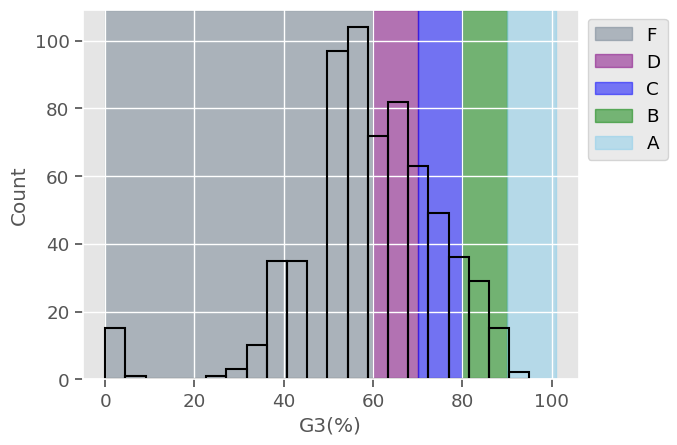

In [169]:
## visualizing the cutoffs for grades
ax = sns.histplot(data=df, x='G3(%)',color='k',fill=False)
colors = ['slategray','purple','blue','green','skyblue']
for i in range(len(bins)-1):
    x1 = bins[i]
    x2 = bins[i+1]
    label = bin_labels[i]
    ax.axvspan(x1,x2, label=label,color=colors[i],zorder=0,alpha=.5)
ax.legend(bbox_to_anchor=[1,1])



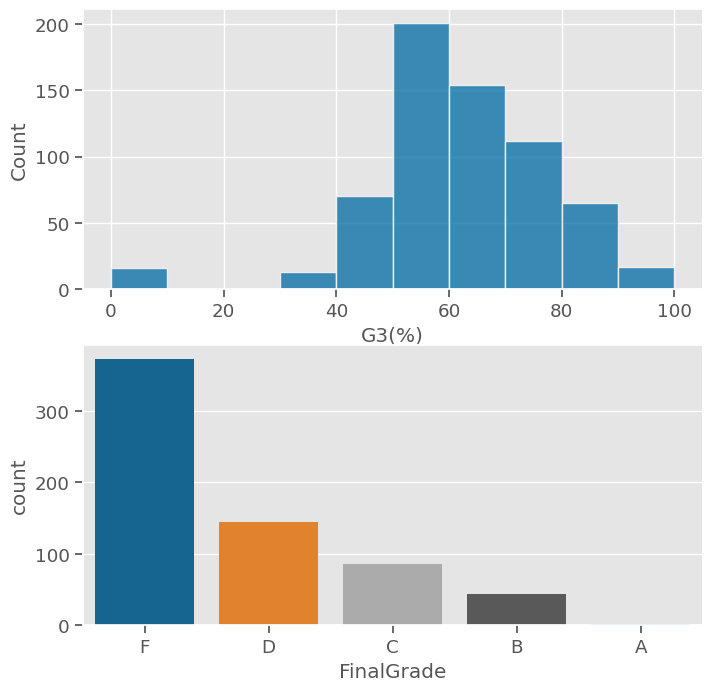

In [170]:
# We can also view these distributions on two separate graphs.

fig, axes = plt.subplots(nrows=2,figsize=(8,8))
sns.histplot(data=df, x='G3(%)',ax=axes[0], binwidth=10);
sns.countplot(data=df,x='FinalGrade',ax=axes[1],order=['F','D','C','B','A']);


### Making Our Final Target & X/y Data

Since we are interested in creating a binary classification. We will define a new column that simply indicates whether a student received an F (failed) or not (passed). We will also check the class balance by using value_counts(normalize=True).

In [171]:
## Define target as had a F or Above
df['target_F'] = df['FinalGrade'] == 'F'
df['target_F'].value_counts(normalize=True)



target_F
True    0.57
False   0.43
Name: proportion, dtype: float64

#### Train Test Split

We must make sure to remove the original target that we used to calculate our grades. Otherwise, G3 and G3% would be perfect predictors of passing or failing!

In [172]:
## Make x and y variables
drop_feats = ['G1','G2','G3','G3(%)','FinalGrade']
y = df['target_F'].copy()
X = df.drop(columns=['target_F',*drop_feats]).copy()
## train-test-split with random state for reproducibility
X_train, X_test, y_train, y_test = train_test_split(X,y, random_state=SEED)


#### Preprocessing and Column Transformers

Since we will be revisiting RandomForest first, let's use drop='if_binary' in our OneHotEncoder to keep as many categories as possible without losing information.

In [173]:
## make categorical & numeric selectors
cat_sel = make_column_selector(dtype_include='object')
num_sel = make_column_selector(dtype_include='number')
## make pipelines for categorical vs numeric data
cat_pipe = make_pipeline(SimpleImputer(strategy='constant',
                                     fill_value='MISSING'),
                         OneHotEncoder(drop='if_binary', sparse=False))
num_pipe = make_pipeline(SimpleImputer(strategy='mean'))
## make the preprocessing column transformer
preprocessor = make_column_transformer((num_pipe, num_sel),
                                       (cat_pipe,cat_sel),                                      verbose_feature_names_out=False)
## fit column transformer and run get_feature_names_out
preprocessor.fit(X_train)
feature_names = preprocessor.get_feature_names_out()
X_train_df = pd.DataFrame(preprocessor.transform(X_train),
                           columns = feature_names, index = X_train.index)
X_test_df = pd.DataFrame(preprocessor.transform(X_test),
                           columns = feature_names, index = X_test.index)
X_test_df.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
104,15.00,3.00,4.00,1.00,2.00,0.00,5.00,4.00,4.00,1.00,1.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
284,18.00,2.00,1.00,1.00,1.00,2.00,3.00,2.00,5.00,2.00,5.00,5.00,4.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
579,18.00,1.00,3.00,1.00,1.00,0.00,4.00,3.00,3.00,2.00,3.00,3.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,1.00


#### Preprocessing and Column Transformers

Since we will be revisiting RandomForest first, let's use drop='if_binary' in our OneHotEncoder to keep as many categories as possible without losing information.

In [174]:
## make categorical & numeric selectors
cat_sel = make_column_selector(dtype_include='object')
num_sel = make_column_selector(dtype_include='number')
## make pipelines for categorical vs numeric data
cat_pipe = make_pipeline(SimpleImputer(strategy='constant',
                                     fill_value='MISSING'),
                         OneHotEncoder(drop='if_binary', sparse=False))
num_pipe = make_pipeline(SimpleImputer(strategy='mean'))
## make the preprocessing column transformer
preprocessor = make_column_transformer((num_pipe, num_sel),
                                       (cat_pipe,cat_sel),                                      verbose_feature_names_out=False)
## fit column transformer and run get_feature_names_out
preprocessor.fit(X_train)
feature_names = preprocessor.get_feature_names_out()
X_train_df = pd.DataFrame(preprocessor.transform(X_train),
                           columns = feature_names, index = X_train.index)
X_test_df = pd.DataFrame(preprocessor.transform(X_test),
                           columns = feature_names, index = X_test.index)
X_test_df.head(3)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
104,15.00,3.00,4.00,1.00,2.00,0.00,5.00,4.00,4.00,1.00,1.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
284,18.00,2.00,1.00,1.00,1.00,2.00,3.00,2.00,5.00,2.00,5.00,5.00,4.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
579,18.00,1.00,3.00,1.00,1.00,0.00,4.00,3.00,3.00,2.00,3.00,3.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,1.00


#### RandomForestClassifier
Function for Evaluating Classification Models

In [175]:
def evaluate_classification(model, X_train,y_train,X_test,y_test,
                            normalize='true',cmap='Blues', figsize=(10,5)):
    header="\tCLASSIFICATION REPORT"
    dashes='--'*40
    print(f"{dashes}\n{header}\n{dashes}")
    ## training data
    print('[i] Training Data:')
    y_pred_train = model.predict(X_train)
    report_train = metrics.classification_report(y_train, y_pred_train)
    print(report_train)
    fig,ax = plt.subplots(figsize=figsize,ncols=2)
    metrics.ConfusionMatrixDisplay.from_estimator(model,X_train,y_train,
                                                  normalize=normalize,
                                                   cmap=cmap,ax=ax[0])
    metrics.RocCurveDisplay.from_estimator(model,X_train,y_train,ax=ax[1])
    ax[1].plot([0,1],[0,1],ls=':')
    ax[1].grid()
    
    fig.tight_layout()
    plt.show()
     
    print(dashes)
    ## test data
    print(f"[i] Test Data:")
    y_pred_test = model.predict(X_test)
    report_test = metrics.classification_report(y_test, y_pred_test)
    print(report_test)
    fig,ax = plt.subplots(figsize=figsize,ncols=2)
    metrics.ConfusionMatrixDisplay.from_estimator(model,X_test,y_test,
                                                  normalize=normalize,
                                                   cmap=cmap, ax=ax[0])
    metrics.RocCurveDisplay.from_estimator(model,X_test,y_test,ax=ax[1])
    ax[1].plot([0,1],[0,1],ls=':')
    ax[1].grid()
    fig.tight_layout()
    plt.show()



--------------------------------------------------------------------------------
	CLASSIFICATION REPORT
--------------------------------------------------------------------------------
[i] Training Data:
              precision    recall  f1-score   support

       False       1.00      1.00      1.00       205
        True       1.00      1.00      1.00       281

    accuracy                           1.00       486
   macro avg       1.00      1.00      1.00       486
weighted avg       1.00      1.00      1.00       486



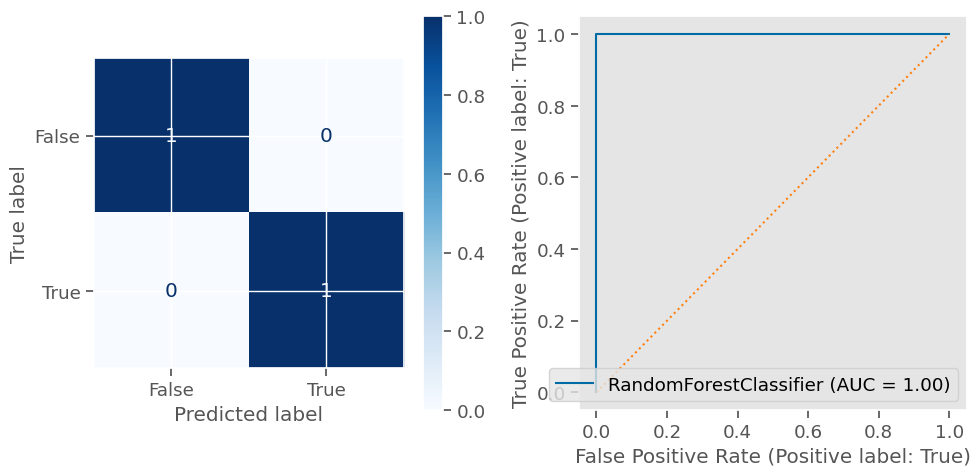

--------------------------------------------------------------------------------
[i] Test Data:
              precision    recall  f1-score   support

       False       0.81      0.70      0.75        71
        True       0.79      0.87      0.83        92

    accuracy                           0.80       163
   macro avg       0.80      0.79      0.79       163
weighted avg       0.80      0.80      0.80       163



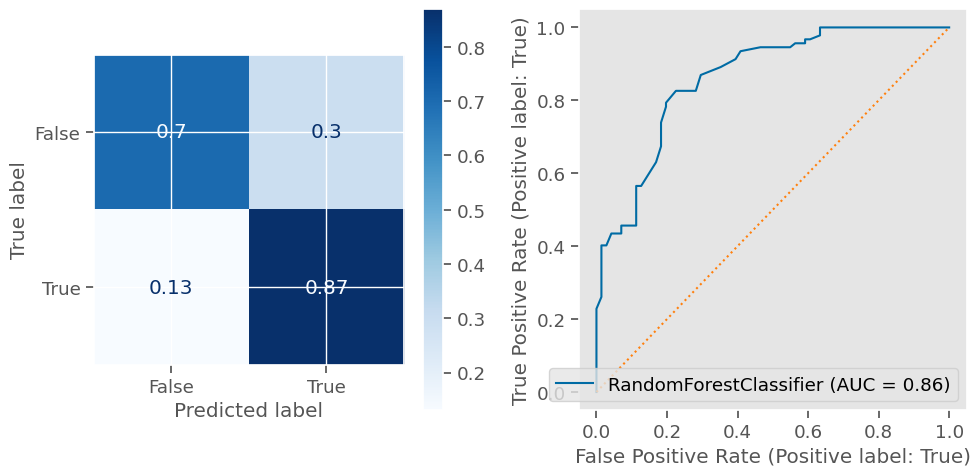

In [176]:
## fit random forest
from sklearn.ensemble import RandomForestClassifier
rf_clf = RandomForestClassifier()#class_weight='balanced')
rf_clf.fit(X_train_df,y_train)
evaluate_classification(rf_clf,X_train_df,y_train, X_test_df,y_test)




- We have an overall accuracy of .80, which isn't bad. However, our task is to identify the students who will get an F (the True group). So let's take a closer look at our True class scores.
    - The Recall score for True is .87. This means that out of all of the students who will fail, our model is identifying 87% of them correctly. While this isn't perfect (there are still 13% of students who will fail that are falling through the cracks), this is MUCH better than our R-squared of 0.35!
- As we can see above, our classification task is performing much better than our regression version of the task! This is a much more appropriate model to extract insights from.


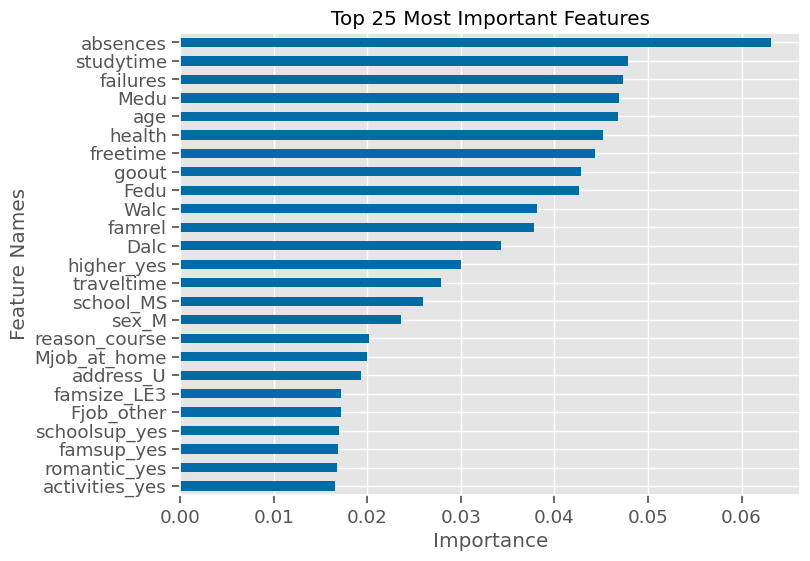

In [177]:
rf_importances = get_importances(rf_clf)
ax = plot_importance(rf_importances,top_n=25)




- As we can see above, absences, studytime, failures, Medu, and age are the most important features, with many other features not too far behind.
- As we discussed previously, built-in feature importances are biased towards considering numeric features as more important, so let's compare these importances to our Permutation Importance.


### Permutation Importances - RandomForest

In [178]:
from sklearn.inspection import permutation_importance
r = permutation_importance(rf_clf,X_train_df,y_train,n_jobs=-1,n_repeats=5)
r.keys()



dict_keys(['importances_mean', 'importances_std', 'importances'])

In [179]:
## getting the colors for the top 7 important rf features
colors_rf = get_color_dict(rf_importances,top_n=7)



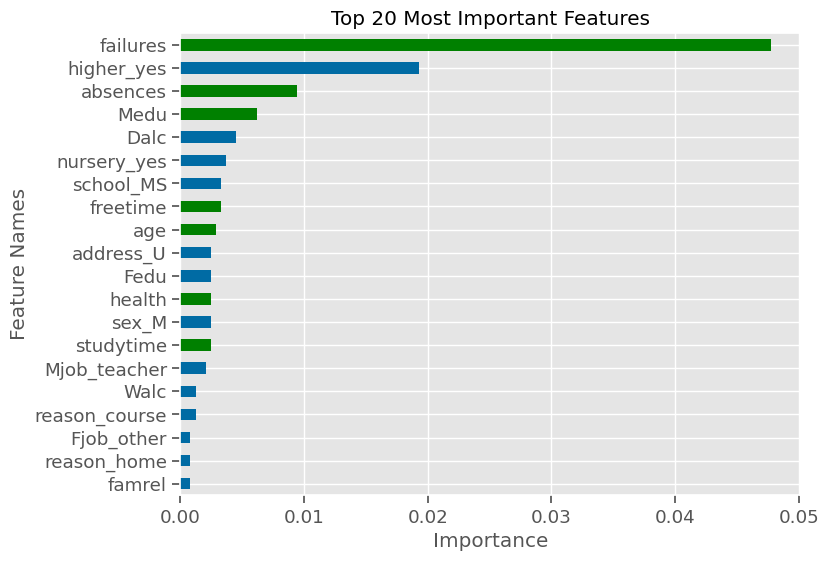

In [180]:
## can make the mean importances into a series
rf_perm_importances = pd.Series(r['importances_mean'],index=X_train_df.columns,
                           name = 'permutation importance')
rf_perm_importances = rf_perm_importances.sort_values(ascending=False)
plot_importance_color(rf_perm_importances,color_dict=colors_rf,top_n=20);




- As we can see above, one of the features with the top 3 largest permutation importance were not in the random forest's top features:
    - higher_yes
- As we previously discussed, built-in feature importance often overlooks categorical features. Our permutation importance, however, avoids this bias and it determined 1 out of the 3 most important features to be a categorical feature.
- Also, as we discussed previously, neither feature importance nor permutation importance tells us the directionality of that feature vs the target.
    - higher_yes means that the student is planning to pursue higher education. We may suspect that being in this group leads to decreased likelihood of Failing, but we cannot say that for sure with just this information.

### Post-Modeling EDA

- Let's combine all of our processed data back into 1 DataFrame for our final EDA.
    - This means we want to combine:
        - X_train and y_train (first),
        - X_test and y_test (second),
        - and then combine both of the above!


In [181]:
# Combining all data for eda post-modeling
plot_df_train = pd.concat([X_train_df, y_train],axis=1)
plot_df_test = pd.concat([X_test_df, y_test],axis=1)
plot_df = pd.concat([plot_df_train, plot_df_test])
plot_df



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes,target_F
54,15.00,3.00,3.00,1.00,1.00,0.00,5.00,3.00,4.00,4.00,4.00,1.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,False
208,16.00,2.00,3.00,2.00,1.00,0.00,5.00,3.00,3.00,1.00,1.00,3.00,0.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,True
23,16.00,2.00,2.00,2.00,2.00,0.00,5.00,4.00,4.00,2.00,4.00,5.00,2.00,0.00,1.00,1.00,1.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00,True
547,16.00,4.00,1.00,1.00,1.00,0.00,4.00,1.00,2.00,2.00,1.00,2.00,0.00,1.00,1.00,0.00,1.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,True
604,18.00,1.00,1.00,3.00,2.00,1.00,4.00,4.00,2.00,1.00,2.00,2.00,2.00,1.00,0.00,1.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
333,17.00,1.00,1.00,1.00,3.00,0.00,4.00,3.00,3.00,1.00,1.00,3.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00,False
454,16.00,1.00,2.00,1.00,3.00,1.00,1.00,3.00,2.00,1.00,2.00,4.00,3.00,1.00,0.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,True
56,15.00,4.00,3.00,1.00,2.00,0.00,4.00,3.00,2.00,1.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00,False
203,17.00,1.00,2.00,1.00,2.00,0.00,3.00,1.00,3.00,1.00,5.00,3.00,6.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,True


- Now, let's do some quick exploration of the relationship between our target and the top 3 features.

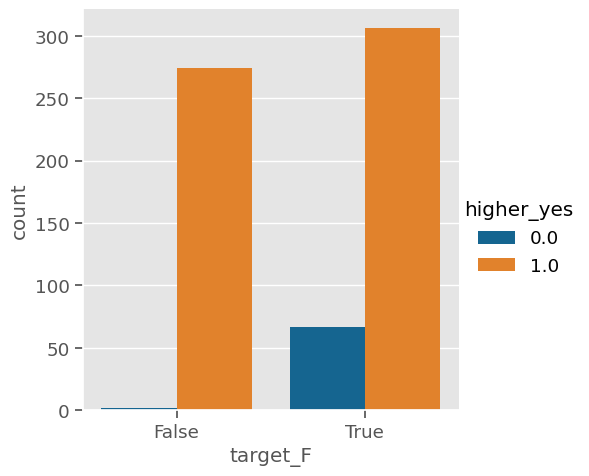

In [182]:
sns.catplot(data=plot_df, kind='count', x='target_F', hue='higher_yes');



- As we can see with our EDA above, it looks like there are a higher proportion of students that are NOT pursuing higher education (blue group) in the Failing students (target_F==True) than the successful students.

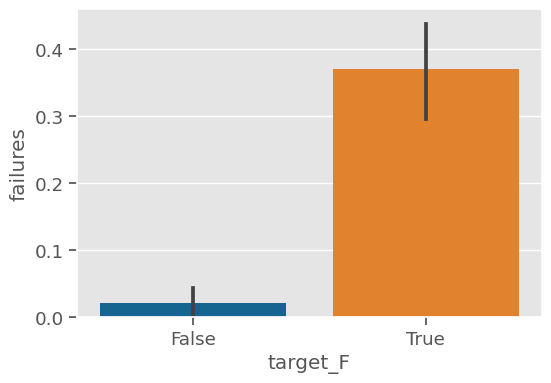

In [183]:
plt.figure(figsize=(6,4))
ax = sns.barplot(data=plot_df, x='target_F',y='failures')



- We can see above that students who failed Portuguese had many more failures, on average.

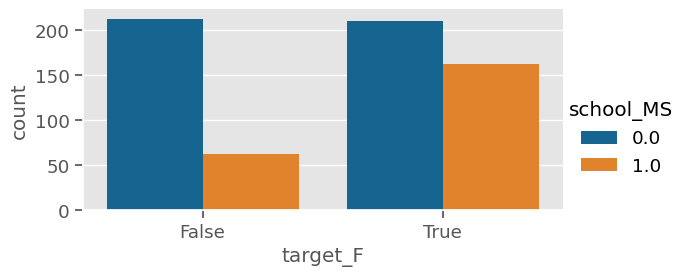

In [184]:
sns.catplot(data=plot_df, kind='count', x='target_F', hue='school_MS',
            aspect=2, height=3);



- A greater porportion of students are failing at GP middle school than MS middle school.  

**Summary**

In this lesson, you converted a regression target to a classification target. This may or may not be appropriate depending on your stakeholder's needs. In this case, the classification model served our purpose and allowed us to develop a higher-performing model from which to gain insights. Now that we are working with a classification task, we will revisit regression coefficients in the next lesson, but this time it will be for Logistic Regression coefficients for classification.

# Logistic Regression Coefficients

**Learning Objectives:**

- Extract and visualize coefficients from sklearn logistic regression model.
- Compare feature importance vs regression coefficients.
- Convert log odds to odds and interpret each.

## Introduction

- Just like Linear Regression models calculate a coefficient for each feature to predicted a value for the target, Logistic Regression models also calculate coefficients to predict the probability of being in a specific class.
- It does this by converting a linear regression equation into a sigmoid curve, which will convert the predictions for y to a value between 0 and 1.

Converting Our Linear Equation to A Sigmoid Curve

Visual Example of Converting Linear Equation to a Sigmoid Curve Desmos Example:  https://www.desmos.com/calculator/vk1afglgyc

Let's look at example of an arbitrary linear equation:


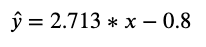

Here we define a simple function to solve this equation when various values of x are given.

In [185]:
def calc_lin_reg(x):
    return x*2.713 - .8



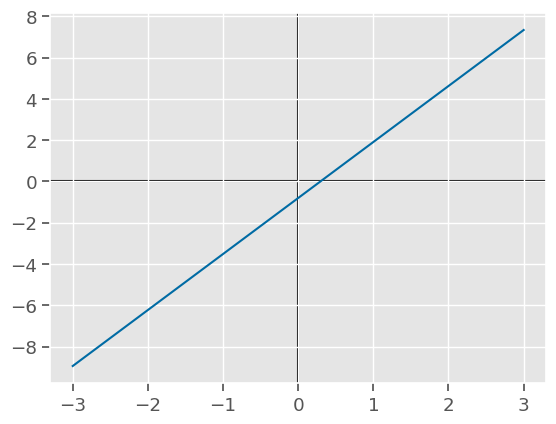

In [186]:
# Now we will plot our line

xs = np.linspace(-3,3)
ys = calc_lin_reg(xs)
def plot_xy(xs,ys):
    plt.plot(xs,ys)
    plt.axvline(0,color='k', zorder=0)
    plt.axhline(0, color='k', zorder=0)
plot_xy(xs,ys)



You can see that a linear equation will give unbounded results which is why it is used for predicting a continuous variable.

For classification, we want to bound our results.

Notice the location of our example linear equation within the logistic equation below:

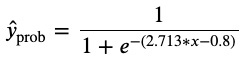

We will write this equation into our code and plot the result. 

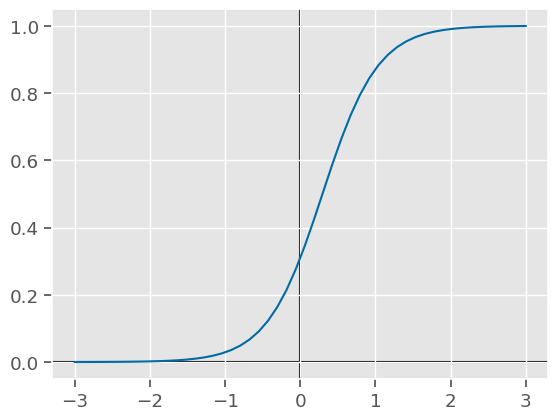

In [187]:
from math import e
def calc_sigmoid(ys):
    return 1/(1+e**-ys)
ys_sigmoid = calc_sigmoid(ys)
plot_xy(xs,ys_sigmoid)




- Now the regression equation is predicting a value between 0 and 1 which represents the probability of being in the 1 class. By default, values above .5 will be classified as 1 while values below .5 will be classified as 0.

### LogisticRegression in sklearn

--------------------------------------------------------------------------------
	CLASSIFICATION REPORT
--------------------------------------------------------------------------------
[i] Training Data:
              precision    recall  f1-score   support

       False       0.73      0.71      0.72       205
        True       0.79      0.81      0.80       281

    accuracy                           0.77       486
   macro avg       0.76      0.76      0.76       486
weighted avg       0.76      0.77      0.76       486



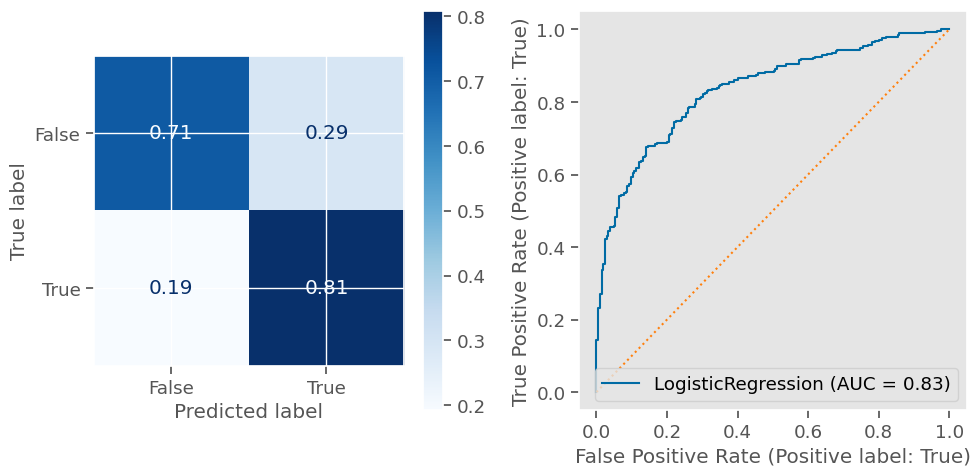

--------------------------------------------------------------------------------
[i] Test Data:
              precision    recall  f1-score   support

       False       0.73      0.69      0.71        71
        True       0.77      0.80      0.79        92

    accuracy                           0.75       163
   macro avg       0.75      0.75      0.75       163
weighted avg       0.75      0.75      0.75       163



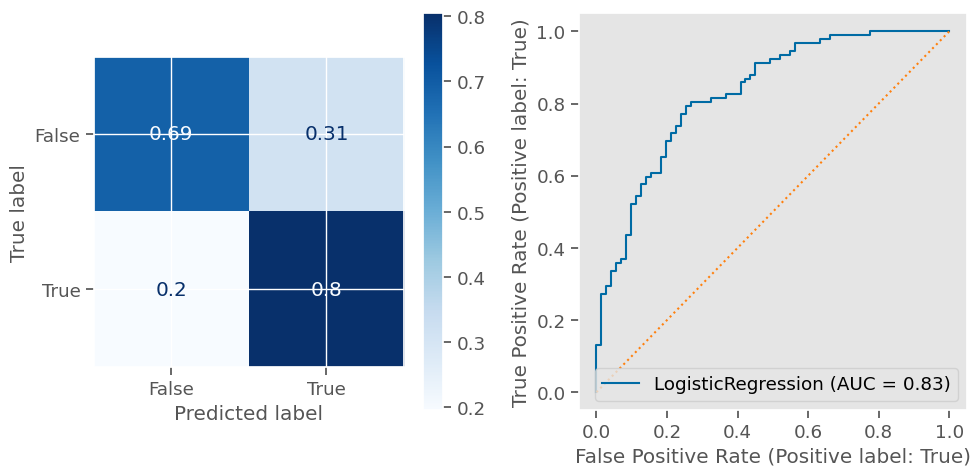

In [188]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(max_iter=1000)
logreg.fit(X_train_df, y_train)
evaluate_classification(logreg,X_train_df,y_train, X_test_df,y_test)



- As we can see above, our LogisticRegression model did not perform quite as well as our RandomForest, but it is still performing well-enough that it is worth extracting our coefficients and getting additional insights into the directionality of the effect of each feature on the target.

### Extracting Coefficients from LogisticRegression in scikit-learn

- Just like we extracted our coefficients from our linear regression's lin_reg.coef_, we can also extract our logistic regression coefficients in the same way.
- Both scikit-learn Linear Regressions & Logistic Regressions calculate coefficients.
    - However, logistic regression models will return more than 1 set of coefficients if you are predicting more than 2 classes.
- Let's try to use our previous get_coeffs function on the logistic regression model.


In [189]:
try:
    get_coeffs_linreg(logreg)
except Exception as e:
    print("ERROR: ", e) 


ERROR:  Length of values (1) does not match length of index (43)



- We got an error when we tried to make our coef's into a pd.Series. The reason for this is that we have an extra empty matrix around our coefficients.
- Notice the shape of our .coef_ below has an extra first dimension added:


In [190]:
logreg.coef_



array([[-0.22033254, -0.18664545, -0.21560597, -0.33684027, -0.37153276,
         1.3971672 , -0.25646555,  0.10220749,  0.1223227 ,  0.43155326,
        -0.11744035,  0.13294922,  0.07235506,  0.62769684,  0.61178008,
        -0.3245788 ,  0.13845285,  0.19644874,  0.41637008, -0.35051795,
        -0.19680153,  0.01688446,  0.1156519 , -0.30254763,  0.38032004,
         0.3261798 ,  0.29080017, -0.6931654 ,  0.16816492, -0.38891135,
         0.21949903,  0.00283437, -0.14246681, -0.05378312,  0.19783691,
         0.94178493,  0.13843315,  0.12489102, -0.18657475, -0.07941994,
        -1.70502703, -0.07351978,  0.1918389 ]])

- Also note that the intercept_ (which was a single value in LinearRegression mode) is now also wrapped in an array. 

In [191]:
logreg.intercept_



array([6.26857514])

### Slicing LogReg Coefficients

- The first dimension is unnecessary, as all of our coefficients are stored in the first (and only) index of the first dimension.


In [192]:
logreg.coef_[0]



array([-0.22033254, -0.18664545, -0.21560597, -0.33684027, -0.37153276,
        1.3971672 , -0.25646555,  0.10220749,  0.1223227 ,  0.43155326,
       -0.11744035,  0.13294922,  0.07235506,  0.62769684,  0.61178008,
       -0.3245788 ,  0.13845285,  0.19644874,  0.41637008, -0.35051795,
       -0.19680153,  0.01688446,  0.1156519 , -0.30254763,  0.38032004,
        0.3261798 ,  0.29080017, -0.6931654 ,  0.16816492, -0.38891135,
        0.21949903,  0.00283437, -0.14246681, -0.05378312,  0.19783691,
        0.94178493,  0.13843315,  0.12489102, -0.18657475, -0.07941994,
       -1.70502703, -0.07351978,  0.1918389 ])

In [193]:
logreg.intercept_[0]



6.268575140981756

- If we were predicting more than 2 classes, we would have a dimension for each class.

    - In this case, we would need to decide WHICH target class we wanted to extract the coefficients for and slice out the correct index.


## Writing a get_coeffs_logreg function.

- Let's define a new get_coeffs_logreg function that we can use for LogisticRegression models.
    - It will be structured very similarly to our previous function, but this time we will slice out the correct index from our .coef_ and our .intercept_.
    - Since we are focusing on a binary task, let's use 0 as the default value for the class index.


In [194]:
def get_coeffs_logreg(logreg, feature_names = None, sort=True,ascending=True,
                      name='LogReg Coefficients', class_index=0):
    if feature_names is None:
        feature_names = logreg.feature_names_in_ 
    
    ## Saving the coefficients
    coeffs = pd.Series(logreg.coef_[class_index],
                       index= feature_names, name=name)
    
    # use .loc to add the intercept to the series
    coeffs.loc['intercept'] = logreg.intercept_[class_index]
    if sort == True:
        coeffs = coeffs.sort_values(ascending=ascending)  
    return coeffs



In [195]:
coeffs = get_coeffs_logreg(logreg)
coeffs



higher_yes          -1.71
Fjob_teacher        -0.69
reason_home         -0.39
studytime           -0.37
Mjob_health         -0.35
traveltime          -0.34
address_U           -0.32
Fjob_at_home        -0.30
famrel              -0.26
age                 -0.22
Fedu                -0.22
Mjob_other          -0.20
Medu                -0.19
activities_yes      -0.19
guardian_father     -0.14
Walc                -0.12
nursery_yes         -0.08
internet_yes        -0.07
guardian_mother     -0.05
reason_reputation    0.00
Mjob_services        0.02
absences             0.07
freetime             0.10
Mjob_teacher         0.12
goout                0.12
paid_yes             0.12
health               0.13
famsup_yes           0.14
famsize_LE3          0.14
reason_course        0.17
romantic_yes         0.19
Pstatus_T            0.20
guardian_other       0.20
reason_other         0.22
Fjob_services        0.29
Fjob_other           0.33
Fjob_health          0.38
Mjob_at_home         0.42
Dalc        


- There we go! We have our new get_coeffs function designed explicitly for logistic regression.

    - Note: an even better solution would be to make a get_coeffs function that is flexible enough to work for either type of regression! We won't cover this in our lessons, but if you write a function that does this, share it with your cohort on Discord!

#### Visualizing Our Coefficients

- We previously wrote a plot_coeffs function that should already work with our logistic regression coefficients, now that we have them in a Series. (Refer to the lesson: Visualizing Coefficients for this function)
- Let's test and confirm that it works!


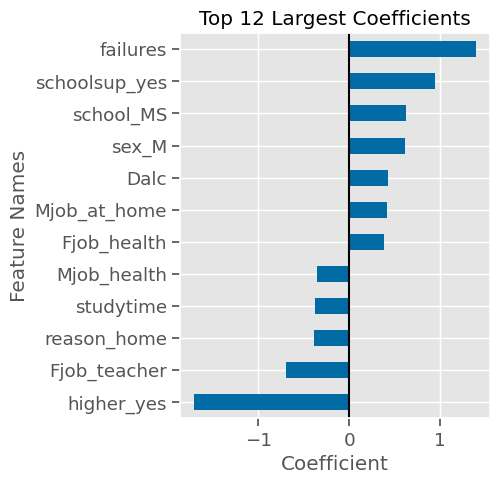

In [196]:
ax = plot_coeffs(coeffs,top_n=12)



- Excellent! Now let's explain what our coefficients are telling us

## Comparing Linear and Logistic Regression Coefficients

Brief review of linear regression coefficients

- Previously, when we interpreted the coefficients of our linear regression, we said that the coefficient for a feature represents how much our target will change for every increase of 1 unit in our feature.
- E.g. For each failure, the final grade decreased by 1.295.
- For OneHotEncoded features, increasing the value of that feature by 1 really meant how being in that category affected the target.
    - E.g. Intending to go to college (higher_yes ==1) increased the final grade by 1.695.

### Introducing logistic regression coefficients

- But now that our target is a classification, how do we interpret the meaning of logistic regression coefficients?
- At the start of the lesson, we discussed how logistic regression converts a linear regression equation into an S-shaped (sigmoid) curve. We said the result is that the curve predicts a probability value between 0 and 1 instead of the actual score.
- The coefficients of a logistic regression are the log odds, which we will convert to odds for interpretation and discuss in detail below.


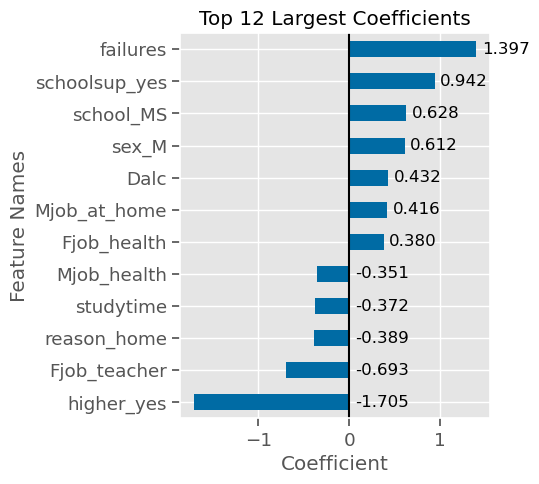

In [197]:
ax = plot_coeffs(coeffs,top_n=12,annotate=True)


- In our figure above, we have both positive and negative coefficients.
    - Positive values indicate the feature makes it more likely the student will fail (class==True)
    - Negative values indicate the feature makes it less likely the student will fail.
- If you look closely, we actually have some values that are larger than +1 or less than -1. But we said that logistic regression returns a probability less than 1?
    - So what is going on? What are these coefficient values?


### LogisticRegression Returns Log Odds Coefficents

   **"...logistic regression coefficients represent the log odds that an observation is in the target \class (“1”) given the values of its X variables. Thus, these log odd coefficients need to be converted to regular odds in order to make sense of them. Happily, this is done by simply exponentiating the log odds coefficients, which you can do with np.exp()" - Source: Medium Blog Post on Interpreting Linear Regression and Logistic Regression Coefficients**

- In order for us to explain the logistic regression coefficients in plain English, we first need to convert the log-odds into odds.

#### Converting Log-Odds to Odds

- To convert our log-odds coefficients into odds, we need to take the Euler number (the math constant e = 2.718281) and raise it to the power of our coefficient (e**coeff).


In [198]:
## logodds coeff for failures
coeffs.loc['failures']



1.3971672008421123

In [199]:
## Raising e to the power of our logodds coeff 
import math
math.e**coeffs.loc['failures']



4.0437286554253955


- This returns the "odds" of being in the positive class (in our case - the odds of failing vs passing).
- By using np.exp(), we can do this to our entire series at once:


<Axes: title={'center': 'All Coefficients - Ranked by Magnitude'}, xlabel='Coefficient', ylabel='Feature Names'>

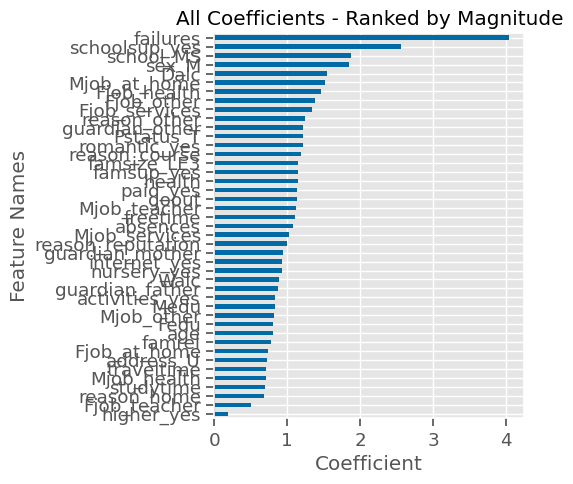

In [200]:
coeffs_odds = np.exp(coeffs)
plot_coeffs(coeffs_odds)


### Updating our function

    Let's add a boolean argument for if we want to convert the log-odds into odds right away.


In [201]:
def get_coeffs_logreg(logreg, feature_names = None, sort=True,ascending=True,
                      name='LogReg Coefficients', class_index=0,  
                      include_intercept=False, as_odds=False):
    
    if feature_names is None:
        feature_names = logreg.feature_names_in_
        
    ## Saving the coefficients
    coeffs = pd.Series(logreg.coef_[class_index],
                       index= feature_names, name=name)
    
    if include_intercept:
        # use .loc to add the intercept to the series
        coeffs.loc['intercept'] = logreg.intercept_[class_index]
        
    if as_odds==True:
        coeffs = np.exp(coeffs)
    if sort == True:
        coeffs = coeffs.sort_values(ascending=ascending)
    
        
    return coeffs


In [202]:
coeffs_odds = get_coeffs_logreg(logreg, as_odds=True)
coeffs_odds



higher_yes          0.18
Fjob_teacher        0.50
reason_home         0.68
studytime           0.69
Mjob_health         0.70
traveltime          0.71
address_U           0.72
Fjob_at_home        0.74
famrel              0.77
age                 0.80
Fedu                0.81
Mjob_other          0.82
Medu                0.83
activities_yes      0.83
guardian_father     0.87
Walc                0.89
nursery_yes         0.92
internet_yes        0.93
guardian_mother     0.95
reason_reputation   1.00
Mjob_services       1.02
absences            1.08
freetime            1.11
Mjob_teacher        1.12
goout               1.13
paid_yes            1.13
health              1.14
famsup_yes          1.15
famsize_LE3         1.15
reason_course       1.18
romantic_yes        1.21
Pstatus_T           1.22
guardian_other      1.22
reason_other        1.25
Fjob_services       1.34
Fjob_other          1.39
Fjob_health         1.46
Mjob_at_home        1.52
Dalc                1.54
sex_M               1.84


#### Interpreting Odds

- Odds are how much more likely to fall into the 1 class than the 0 class.
    - A value of 1 means both classes are equally likely.
    - A value > 1 means that the 1 class is more likely than the 0 class.
    - A value < 1 means that the 1 class is less likely than the 0 class.

- You've likely encountered odds in real-world situations/conversations.
    - "What are the odds that horse A will win the race over horse B?"
    - In other words, how many times more likely is horse A to win vs horse B?


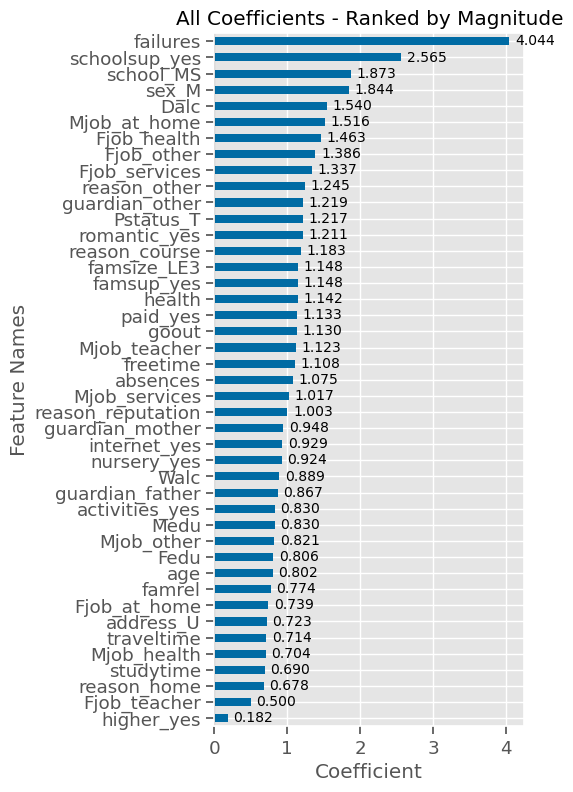

In [203]:
coeffs_odds = get_coeffs_logreg(logreg, as_odds=True)
ax = plot_coeffs(coeffs_odds,annotate=True,figsize=(4,9),size=10)



#### Interpreting Odds Coefficients

**“For every one-unit increase in [X variable], the odds that the observation is in (y class) are [coefficient] times as large as the odds that the observation is not in (y class) (when all other variables are held constant).”**

- Let's walk through interpreting some of our largest odds coefficients:
    - failures:
        - For every additional failure, the odds of a student failing is 4.043 times the odds of passing.
    - schoolsup_yes:
        - Getting (needing?) extra support from the school increases the odds of failing by 2.566
    - school_MS:
        - students who attend MS (and not GP) are 1.873 times more likely to fail.
    - sex_M:
        - male students are 1.844 times more likely to fail than female students.


**Note About Odds being Positive**

- Now that we have odds coefficients, we no longer have any negative values.
    - This means that any of our negative log-odds coefficients (that decreased the chances of the failing) are now odds values less than 1.
    - In other words, we can no longer use the magnitude of the coefficients to determine the most impactful, since a very small coefficient will still represent a big change.
- Looking back at our smallest odds coefficients, we can see that:
    - higher_yes:
        - students who intended to pursue higher education are .18 times more likely to fail (meaning they are much less likely to fail).
        - Or we could say that these students are .18 times less likely to fail.
   -  Fjob_teacher:
        - having a father who is a teacher decreases the odds of failing by .5.
    - reason_home:
        - attending the school because it's close to their home decreases the odds of failing by .678 times.

#### Presenting Logistic Regression Coefficients to Non-Technical Stakeholders

- To help us digest and interpret the coefficients better, let's add a vertical line at 1 (where 1= equally likely of Failing or Passing).


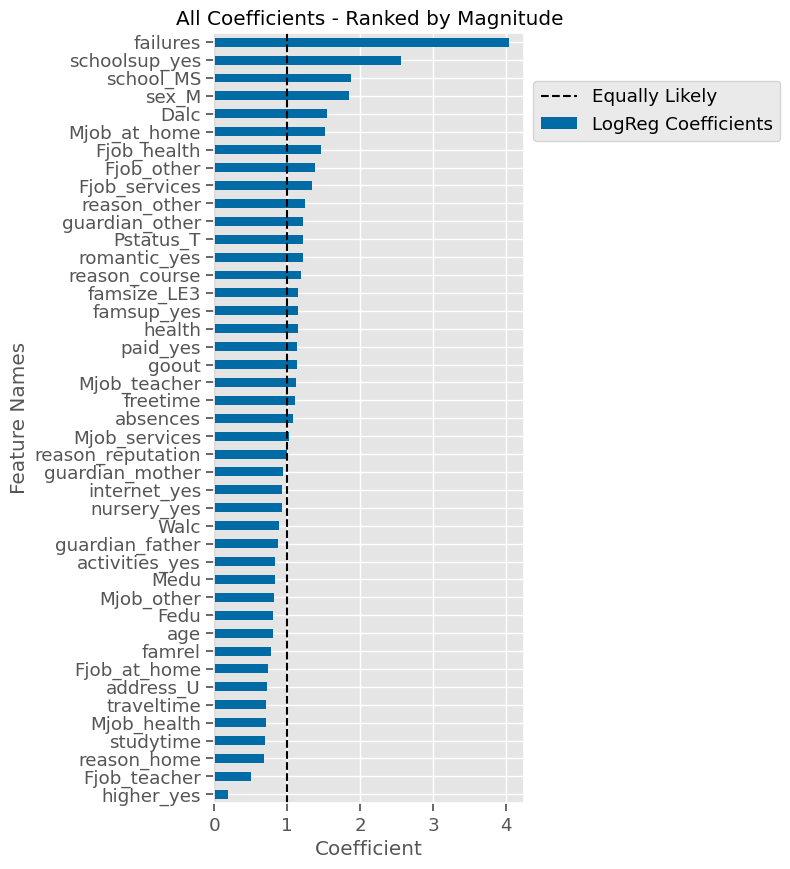

In [204]:
ax = plot_coeffs(coeffs_odds,annotate=False,figsize=(4,10))
ax.axvline(1, ls='--',label='Equally Likely',color='k', zorder=1)
ax.legend(bbox_to_anchor=[1,.95]);



- When presenting a summary of your model's findings to a non-technical stakeholder, you can choose which version of the coefficients you show.
- Depending on your comfort level for interpreting odds, you may want to leave the coefficients as log-odds to get a nice/clean positive value for each feature.

#### Visualizing Odds Coefficients more effectively.

- If you are comfortable explaining odds and use color-coding and/or a vertical line indicating the threshold between more/less likely, then using odds coefficients may work better for you.
- To aid in the visual interpretation of Odds, we can color-code the values greater than 1 and less than 1.
- See the next (optional) lesson for how to accomplish this yourself!


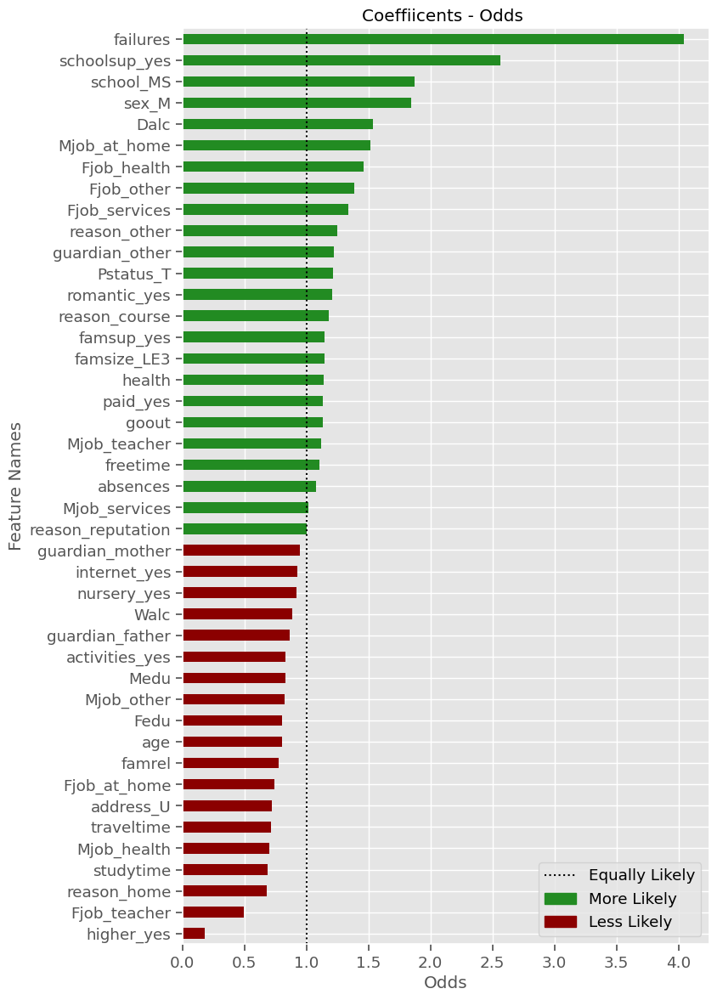


**Summary**

- In this lesson, we reviewed the extraction and interpretation of Logistic Regression coefficients.
- The Logistic Regression coefficients provided more information about the directionality of the relationship between our features and our target.
    - However, our Logistic Regression did not perform as well as our RandomForest model.
- It would be great if we had a tool that would allow us to get the directionality of the features effect on our model's predictions for all models, not just Logistic Regression model.
    - There is indeed such a tool! Which we will explore in the next lesson.


# Advanced MatPlotLib

**Learning Objectives:**

By the end of this lesson, students will be able to:

- Color matplotlib bars based on values
- Manually construct a matplotlib legend
- Annotate matplotlib figures

## Color-Coding By Value

In order to create the bar graph from the previous lesson, with the bars colored by value, we created a dictionary that contains each feature name as the key and the color to use for its bars, based upon if the value was greater or less than 1. 

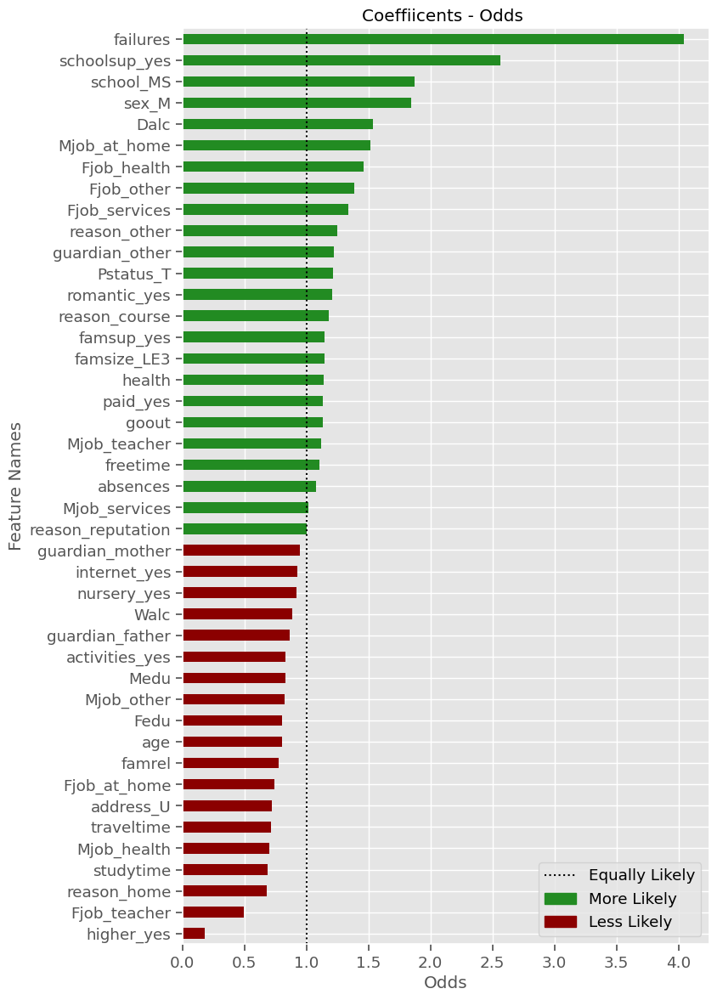

**We accomplished this using the following loop:**

In [205]:
colors_dict = {}
for i in coeffs.index:
    rounded_coeff = np.round( coeffs.loc[i],3)
    if rounded_coeff < 1:
        color = 'darkred'
    elif rounded_coeff > 1:
        color = 'forestgreen'
    else:
        color= 'gray'
    colors_dict[i] = color
    
## previewing example >1 and <1
colors_dict['failures'],colors_dict['higher_yes']



('forestgreen', 'darkred')


- We will now convert this code into a function, but we will add some flexibility.
- To use this function for positive/negative or other value comparisons:
    - Let's add an argument called threshold that will be 1 by default, but will be the value compared to determine the color.
    - Let's also turn the 3 colors into keyword arguments in case we want to change them.


In [206]:
def get_colors_gt_lt(coeffs, threshold=1, color_lt ='darkred',
                     color_gt='forestgreen', color_else='gray'):
    """Creates a dictionary of features:colors based on if value is > or < threshold"""
    colors_dict = {}
    for i in coeffs.index:
        rounded_coeff = np.round( coeffs.loc[i],3)
        if rounded_coeff < threshold:
            color = color_lt
        elif rounded_coeff > threshold:
            color = color_gt
        else:
            color=color_else
        colors_dict[i] = color
    return colors_dict



In [207]:
def plot_coeffs_color(coeffs, top_n=None,  figsize=(8,6), color_dict=None,
                   plot_kws = {}):
    """Plots series of coefficients
    
    Args:
        ceoffs (pands Series): importance values to plot
        top_n (int): The # of features to display (Default=None). 
                        If None, display all.
                        otherwise display top_n most important
                        
        figsize (tuple): figsize tuple for .plot
        color_dict (dict): dict with index values as keys with color to use as vals
                            Uses series.index.map(color_dict).
        plot_kws (dict): additional keyword args accepted by panda's .plot
                            
    Returns:
        Axis: matplotlib axis
        """
    
    # sorting with asc=false for correct order of bars
    
    if top_n is None:
        ## sort all features and set title
        plot_vals = coeffs.sort_values()
        title = "All Coefficients"
    else:
        ## rank the coeffs and select the top_n
        coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
        top_n_features = coeff_rank.head(top_n)
        plot_vals = coeffs.loc[top_n_features.index].sort_values()
        ## sort features and keep top_n and set title
        title = f"Top {top_n} Largest Coefficients"
        
    ## plotting top N importances
    if color_dict is not None:
        ## Getting color list and saving to plot_kws
        colors = plot_vals.index.map(color_dict)
        plot_kws.update({'color':colors})
        
    ax = plot_vals.plot(kind='barh', figsize=figsize,**plot_kws)
    ax.set(xlabel='Coefficient', 
           ylabel='Feature Names', 
           title=title)
    
    ## return ax in case want to continue to update/modify figure
    return ax



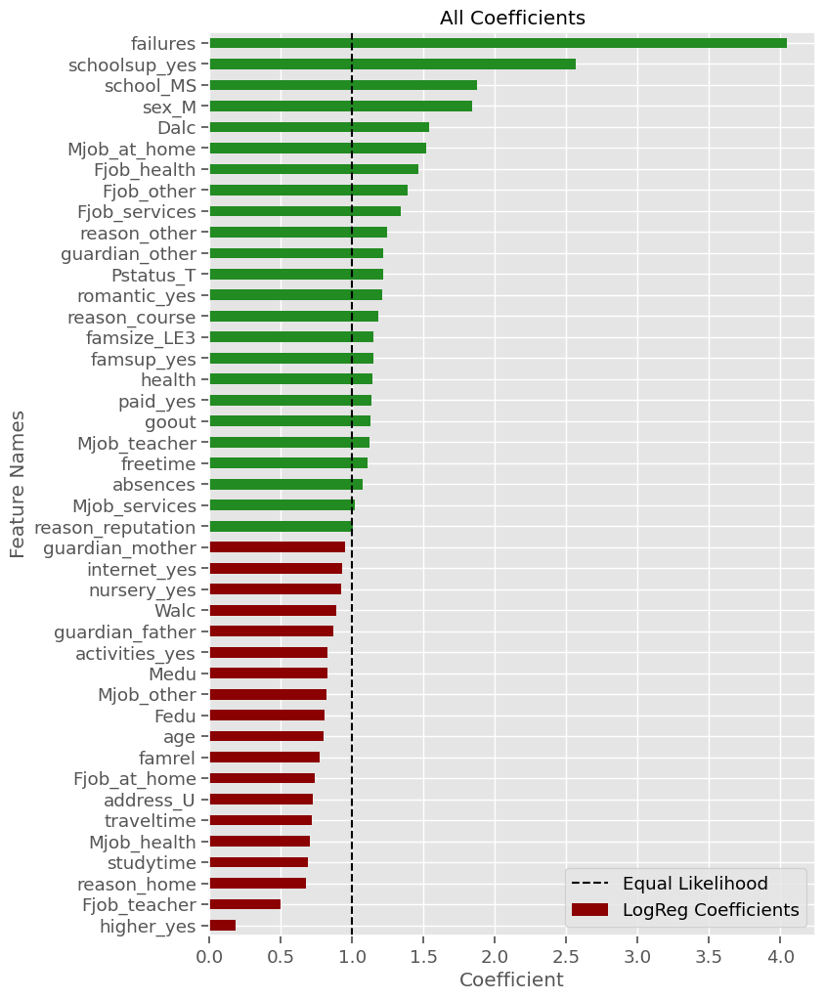

In [208]:
colors_odds = get_colors_gt_lt(coeffs_odds,threshold=1)
ax = plot_coeffs_color(coeffs_odds,color_dict=colors_odds,figsize=(8,12))
ax.axvline(1, ls='--',label='Equal Likelihood',color='k',
          zorder=1)
ax.legend();



### Manually Constructing Our Own Legend

- In the example above, we can see that in our legend, we only have the dark red color and it does not indicate the meaning of the color.
- In order to include these, we will have to make our own legend instead of the automatically determined one.
- To make this easier on ourselves, let's save the color_lt and color_gt we will use to get our color dict as separate variables.
    - This will allow us to easily add this functionality to our function.


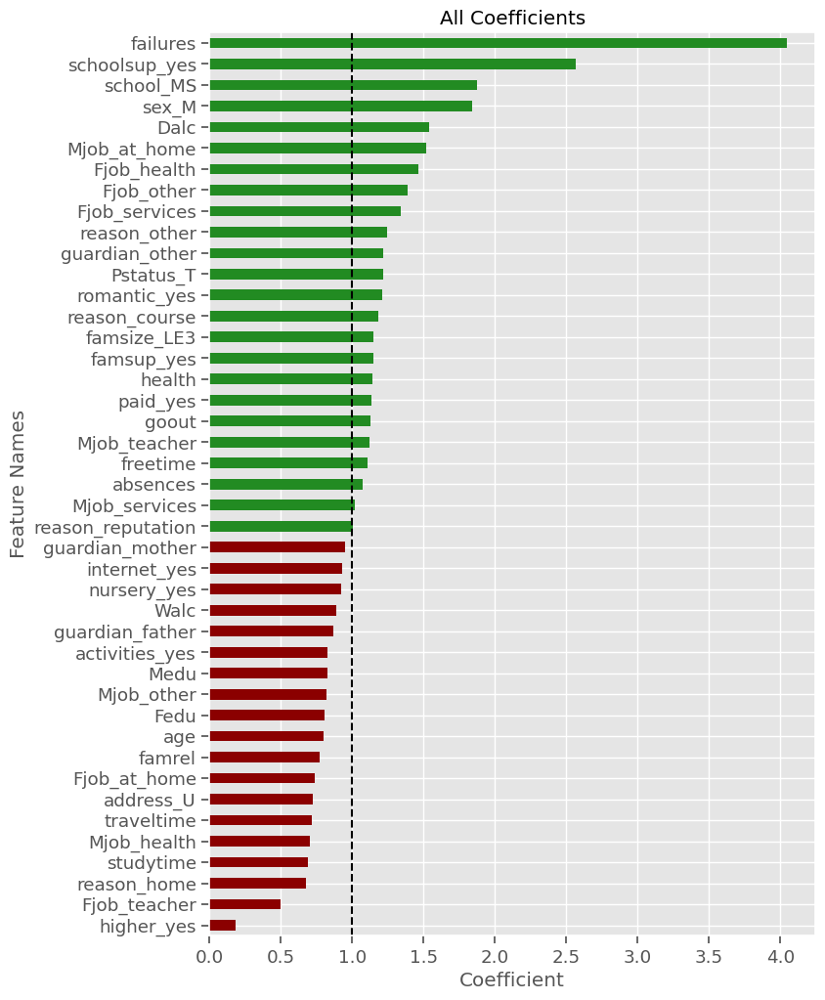

In [209]:
color_lt = 'darkred'
color_gt = 'forestgreen'
colors_odds = get_colors_gt_lt(coeffs_odds,threshold=1,color_lt=color_lt,
                              color_gt=color_gt)
ax = plot_coeffs_color(coeffs_odds,color_dict=colors_odds,figsize=(8,12))
axline = ax.axvline(1, ls='--',label='Equal Likelihood',color='k',
          zorder=1);



In [210]:
from matplotlib.patches import Patch
box_lt = Patch(color=color_lt)
box_gt = Patch(color=color_gt)



- Now that we have these objects created, we will need to use ax.legend(), but we will provide it a list of the objects to include (the "handles") and the name of each object (the "labels")

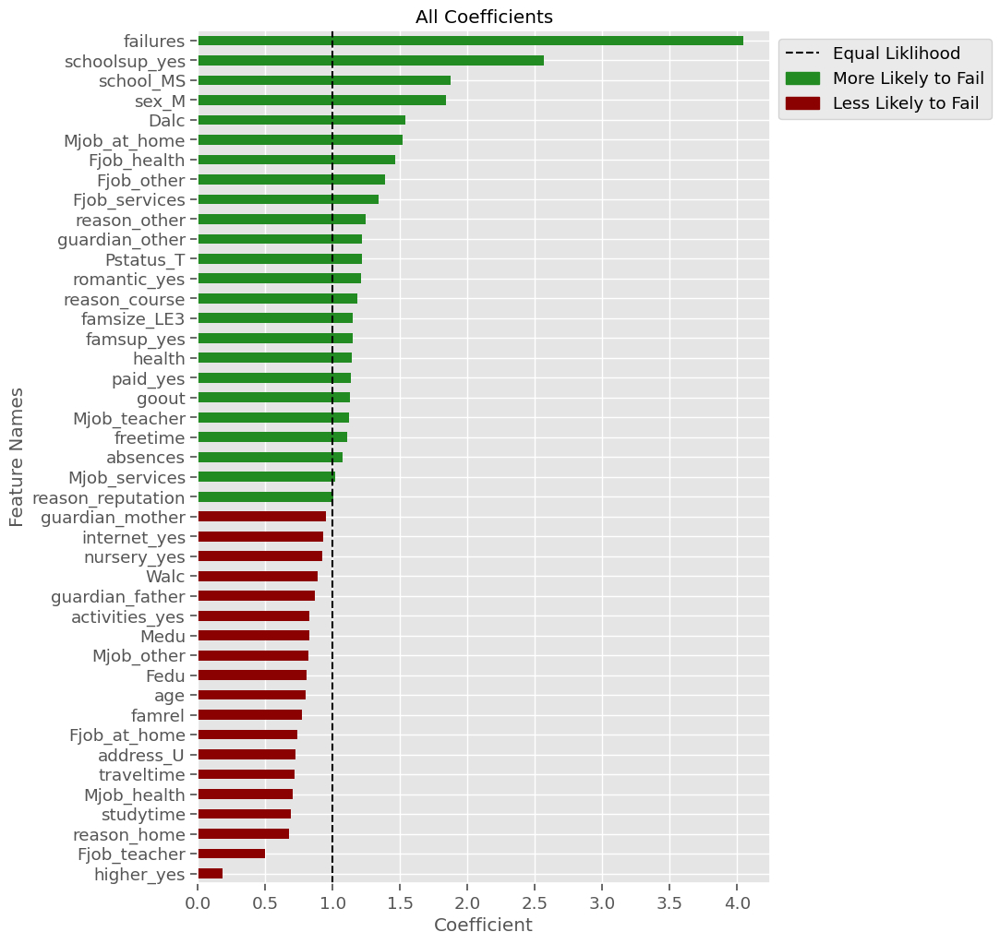

In [211]:
## make list of handles and associated labels
handles = [axline,box_gt,box_lt]
labels = ['Equal Liklihood','More Likely to Fail', "Less Likely to Fail"]
ax.legend(handles,labels,bbox_to_anchor=[1,1])
## remember - we can't see the ax on its own, so we nee the figure!
ax.get_figure()



#### Adding Custom Legends to our function

- To allow for the greatest flexibility, let's make the labels we used for our legend additional arguments for our function.
- Since we are using our color dict to color code by value, instead of coordinating across figures, we can build getting the color dict into our plot_coeffs function.
    - We will just need to make sure we add every argument that our get_colors_gt_lt function takes to our plot_coeffs_colorfunction.
- To control whether we want to use our function to color code our coefficients, we can either add a boolean argument for color_bars=True/False.
    - We could also set the default value for our threshold to None and then only if threshold is not None, will it get and use the color dictionary.


In [212]:
def plot_coeffs_color(coeffs, top_n=None,  figsize=(8,6), legend_loc='best',
                      threshold=None, color_lt='darkred', color_gt='forestgreen',
                      color_else='gray', label_thresh='Equally Likely',
                      label_gt='More Likely', label_lt='Less Likely',
                   plot_kws = {}):
    """Plots series of coefficients
        Args:
        ceoffs (pands Series): importance values to plot
        top_n (int): The # of features to display (Default=None).
                         If None, display all.
                        otherwise display top_n most important
                        
        figsize (tuple): figsize tuple for .plot
        color_dict (dict): dict with index values as keys with color to use as vals
                            Uses series.index.map(color_dict).
        plot_kws (dict): additional keyword args accepted by panda's .plot
        
         
         Returns:
        Axis: matplotlib axis
    """
    # sorting with asc=false for correct order of bars
    if top_n is None:
        ## sort all features and set title
        plot_vals = coeffs.sort_values()
        title = "All Coefficients"
    else:
        ## rank the coeffs and select the top_n
        coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
        top_n_features = coeff_rank.head(top_n)
        plot_vals = coeffs.loc[top_n_features.index].sort_values()
        ## sort features and keep top_n and set title
        title = f"Top {top_n} Largest Coefficients"
        ## plotting top N importances
    if threshold is not None:
        color_dict = get_colors_gt_lt(plot_vals, threshold=threshold,
                                      color_gt=color_gt,color_lt=color_lt,
                                      color_else=color_else)
        ## Getting color list and saving to plot_kws
        colors = plot_vals.index.map(color_dict)
        plot_kws.update({'color':colors})
    
    
    ax = plot_vals.plot(kind='barh', figsize=figsize,**plot_kws)
    ax.set(xlabel='Coefficient',
            ylabel='Feature Names',
            title=title)
    
    if threshold is not None:
        ln1 = ax.axvline(threshold,ls=':',color='black')
        from matplotlib.patches import Patch
        box_lt = Patch(color=color_lt)
        box_gt = Patch(color=color_gt)
        handles = [ln1,box_gt,box_lt]
        labels = [label_thresh,label_gt,label_lt]
        ax.legend(handles,labels, loc=legend_loc)
    ## return ax in case want to continue to update/modify figure
    return ax


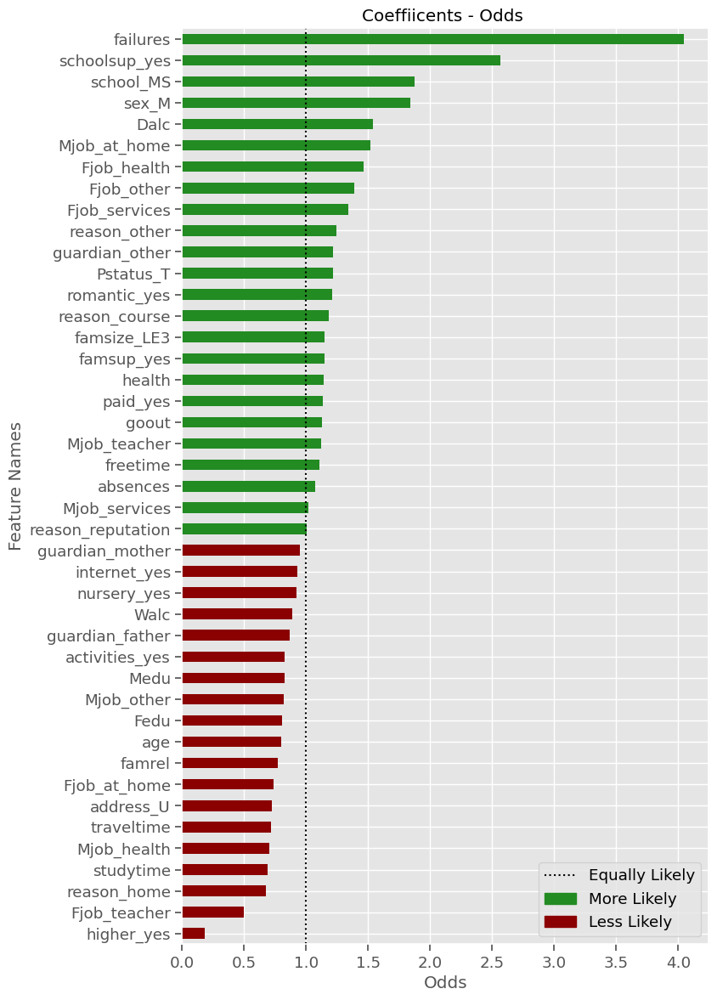

In [213]:
ax = plot_coeffs_color(coeffs_odds,threshold=1,figsize=(8,14));
ax.set(xlabel='Odds', title='Coeffiicents - Odds ')
fig = ax.get_figure()



# SHAP Model Explainers - Global

**Learning Objectives:**

- Use SHAP to produce global explanations of a model
- Visualize and interpret SHAP summary plots

## What is SHAP?

SHAP is a tool used to aid in model interpretations. SHAP deconstructs the model, and tells us why the model made each prediction.

- SHAP (SHapley Additive exPlanations))
    - Repository
    - Documentation
- SHAP is a package that leverages game theory and the idea of marginal contributions to determine how each feature affects the model's predictions. You can think of this as how different players impact the success of a team (or how features impact the prediction of the model).
- The SHAP package will use your model to iteratively remove features from the data set and evaluate the change in the model's predictions.
- The result of this process is a set of Shapley values (or SHAP values).
- The SHAP value is a calculation of the relative contribution of each feature toward the prediction.
- SHAP will produce what is called a global explanation. In other words, it will explain how the model made its predictions for the entire dataset. (In an upcoming lesson, we will explore local explanations, which are explanations about a single row/observation).
- For more details about the inner workings of the SHAP package, see the white papers and articles linked at the bottom of this page. 

## Explaining Our Model

- We will be using our random forest model from the lesson "From Regression to Classification." Let's remind ourselves of its performance and feature importances.

--------------------------------------------------------------------------------
	CLASSIFICATION REPORT
--------------------------------------------------------------------------------
[i] Training Data:
              precision    recall  f1-score   support

       False       1.00      1.00      1.00       205
        True       1.00      1.00      1.00       281

    accuracy                           1.00       486
   macro avg       1.00      1.00      1.00       486
weighted avg       1.00      1.00      1.00       486



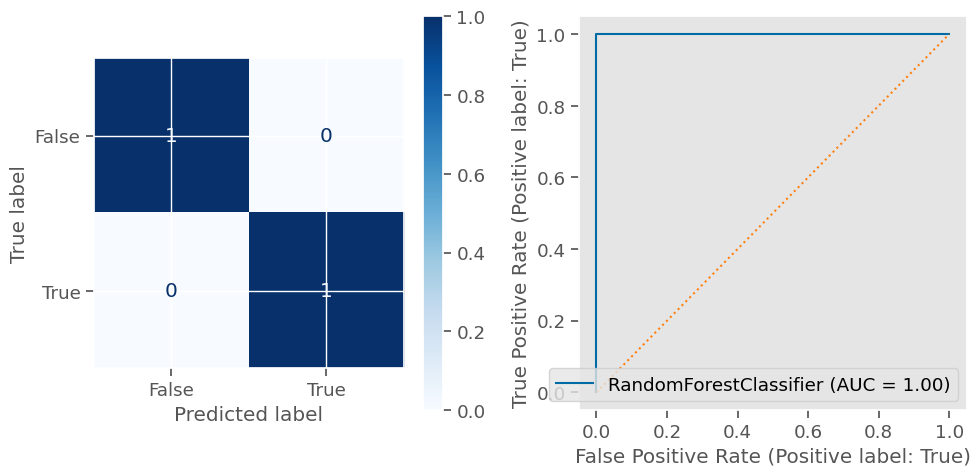

--------------------------------------------------------------------------------
[i] Test Data:
              precision    recall  f1-score   support

       False       0.81      0.70      0.75        71
        True       0.79      0.87      0.83        92

    accuracy                           0.80       163
   macro avg       0.80      0.79      0.79       163
weighted avg       0.80      0.80      0.80       163



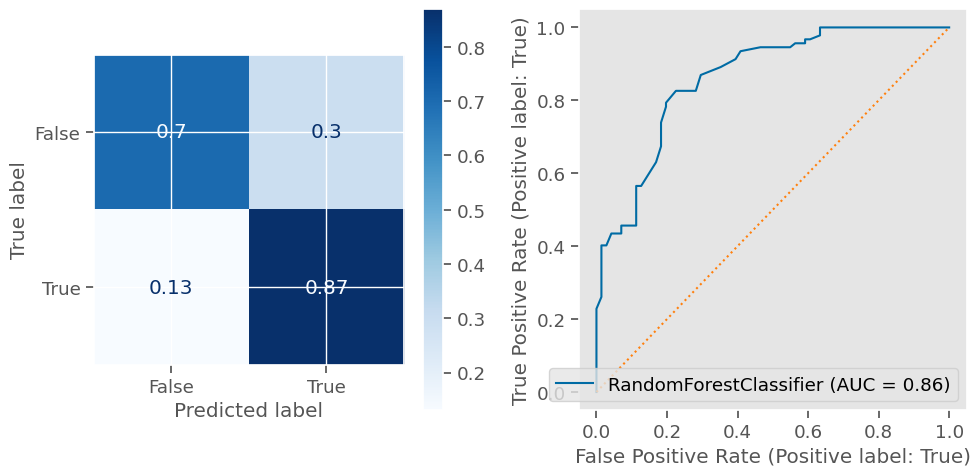

In [214]:
evaluate_classification(rf_clf,X_train_df,y_train, X_test_df,y_test)


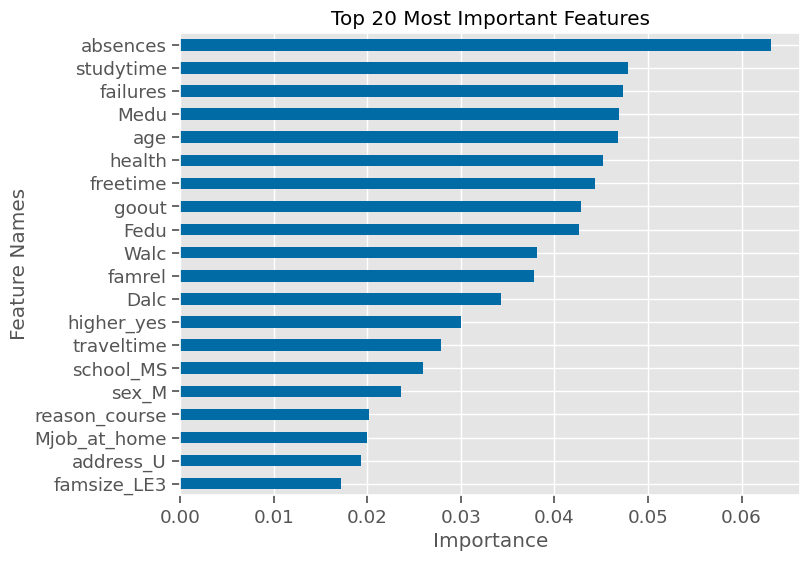

In [215]:
rf_importances = get_importances(rf_clf)
plot_importance(rf_importances,top_n=20);



## How To Use Shap

- There are several SHAP plots that are interactive and require javascript to be loaded. We can do this via the initjs() function in SHAP.

In [216]:
# Import shap and initialize javascript:
import shap
shap.initjs()



### SHAP Explainers

- In order to calculate our SHAP values for our model & features, we will need to create an instance of a Model Explainer.
- Explainer objects will need the model and some X and y data.

### Preparing Data for Shap

- Shap's approach to explaining models can be very resource-intensive for complex models such as our RandomForest.
- To get around this issue, shap includes a convenient sampling function to save a small sample from X_train.
- If we check the length of our X data, we can see how many rows we have.

In [217]:
len(X_train_df)



486

- 486 may be fine, or it could be a bit much for your local machine.
- Whenever the dataset is too large for your machine to process in a timely manner, we can use SHAP's utility for sampling a subset of our data (shap.sample).
- Let's take just 400 observations from our X_train_df and save it as X_shap.

In [218]:
X_shap = shap.sample(X_train_df,nsamples=400,random_state=321)
X_shap.head()


,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
473,16.00,2.00,1.00,2.00,1.00,0.00,2.00,4.00,3.00,2.00,3.00,4.00,4.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
340,17.00,3.00,3.00,1.00,1.00,0.00,4.00,4.00,3.00,1.00,3.00,5.00,0.00,0.00,1.00,1.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00
452,16.00,2.00,2.00,3.00,2.00,0.00,4.00,4.00,5.00,1.00,1.00,4.00,4.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00
555,16.00,1.00,2.00,1.00,3.00,0.00,4.00,3.00,4.00,1.00,1.00,3.00,5.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00
70,16.00,3.00,1.00,2.00,4.00,0.00,4.00,3.00,2.00,1.00,1.00,5.00,2.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00


- Since we made our X_train_df using the index from the original X, we can use the index of X_shap to slice out the y-data that corresponds to our randomly selected X samples.

In [219]:
## get the corresponding y-values
y_shap = y_train.loc[X_shap.index]
y_shap 


473     True
340    False
452     True
555    False
70      True
       ...  
485     True
329    False
251     True
434     True
568     True
Name: target_F, Length: 400, dtype: bool

### Explaining Our RandomForest

    SHAP has several types of model explainers that are optimized for different types of models.

#### Explainers and their use cases:

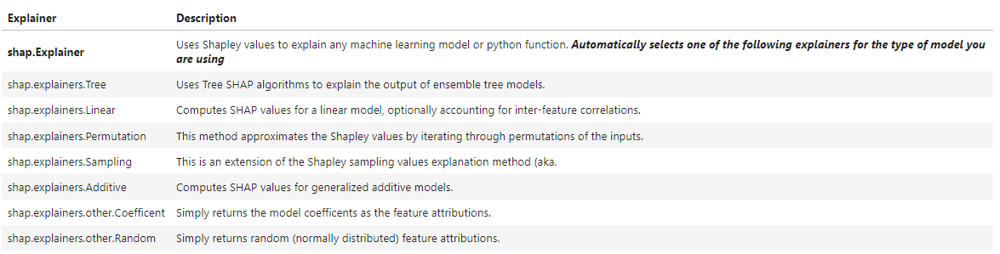

#### 1. Create a SHAP explainer using your fit model

In [220]:
explainer = shap.Explainer(rf_clf)
explainer



- As we can see above, shap.Explainer recognized that we are using a tree based model, so it created a TreeExplainer.
- Now that we have the explainer, we need to provide then X and y data.
- The explainer will use a copy of our model to iterate through all of the features to calculate the marginal contribution of each feature to the model's predictions.
- These contributions will be represented as SHAP values, which we will interpret to explain our model.

#### 2. Get SHAP values from explainer for your training data

In [221]:
## Getting the shap values
shap_values = explainer(X_shap,y_shap)
type(shap_values)


shap._explanation.Explanation

### Important Note about SHAP Changes

- Recently, SHAP updated its functions to return a special class for SHAP values called Explanations as you can see when we checked the type above.
- Many of the examples in articles and tutorials on the internet are examples of the old way of using SHAP.
    - These approaches will still work, but they return simple NumPy arrays instead of the special Explanations class.
    - See the Examples in the Appendix for examples of the older approach.

First, let's remember the shape of the sample of X values we provided to our explainer.

In [222]:
X_shap.shape



(400, 43)

As indicated by the output above, we have 400 samples (rows) and 43 features (columns).

Now let's investigate the shape of our shap_values:

In [223]:
shap_values.shape



(400, 43, 2)

- We can see that SHAP calculated values for all 400 rows and 43 columns in our X_shap dataset.
- **The SHAP values also have a third dimension.**
- Notice that the 3rd dimension is 2.
    - **This is because our classification task has 2 classes. If we had more classes, we would have the same number in our third dimension as we have classes.**
    - We actually have two SHAP values for every sample and feature (one for each target class)

Let's take a look at the first entry for SHAP values:


### Exploring SHAP Explanation Values

- What does the first row of SHAP values look like?
- This is the result for just one sample (in our case, one student) from our dataset. 

In [224]:
shap_values[0]


.values =
array([[-1.15165368e-02,  1.15165368e-02],
       [-2.00970183e-02,  2.00970183e-02],
       [-3.73278511e-02,  3.73278511e-02],
       [-1.30577180e-02,  1.30577180e-02],
       [-6.02032650e-02,  6.02032650e-02],
       [ 1.82659012e-02, -1.82659012e-02],
       [-2.60672307e-02,  2.60672307e-02],
       [-5.23592261e-03,  5.23592261e-03],
       [-1.03872516e-02,  1.03872516e-02],
       [-2.83196172e-02,  2.83196172e-02],
       [-2.07484363e-02,  2.07484363e-02],
       [-5.73616057e-03,  5.73616057e-03],
       [-1.13086674e-02,  1.13086674e-02],
       [-4.39675434e-02,  4.39675434e-02],
       [-3.55386270e-02,  3.55386270e-02],
       [ 1.27171520e-03, -1.27171520e-03],
       [-5.32930678e-03,  5.32930678e-03],
       [-2.30715695e-03,  2.30715695e-03],
       [-4.69512766e-02,  4.69512766e-02],
       [-1.45327285e-03,  1.45327285e-03],
       [-5.67660591e-03,  5.67660591e-03],
       [-3.72593331e-04,  3.72593331e-04],
       [-2.87157566e-03,  2.87157566e-03],
 

- Each entry in the shap_values array is a new type of object called an Explanation.
    - Each Explanation has:
        - values:
            - the SHAP values calculated for this observation/row.
                - for classification models, there is a column with values for each target.
        - base_values:
            - the baseline SHAP value without features, (you can think of this similar to an intercept).
            - For regression, it is the mean of all the y values in the training set and can be found with y_train.mean()
            - For classification, it is the mean of the predicted probability (.predict_proba) of the original X_train. There will be 1 probability for each class.
        - data:
            - the original input features

### Limiting our SHAP Values to one class

We have a set of SHAP values for each of our 2 target classes, so we need to decide which class we want to explain. Since our stakeholders have been interested in predicting and understanding students who fail, we can simplify our third dimension to just include the SHAP values for 1 (failing).

- Since the 3rd dimension of our SHAP explanations is the target class (Failing is index 1), we will want to slice out all rows, all columns, and index=1 for the final dimension.
    - shap_values[:,:,1]

In [225]:
# slicing for failing values 
shap_vals_1 = shap_values[:,:,1]
shap_vals_1.shape


(400, 43)

This greatly simplifies our outcome because now we only have two dimensions: our familiar rows and columns.

We now have only one SHAP value for every sample for each feature.

We can clearly view all of the values in a DataFrame:

In [226]:
pd.DataFrame(shap_vals_1.values, columns = X_shap.columns)



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
0,0.01,0.02,0.04,0.01,0.06,-0.02,0.03,0.01,0.01,0.03,0.02,0.01,0.01,0.04,0.04,-0.00,0.01,0.00,0.05,0.00,0.01,0.00,0.00,-0.00,0.00,-0.00,0.00,0.01,0.02,0.00,-0.00,0.01,0.00,0.00,0.00,-0.00,0.01,-0.00,0.00,-0.00,-0.01,-0.00,-0.00
1,-0.03,-0.01,-0.03,-0.01,0.05,-0.03,-0.01,-0.00,0.00,-0.03,0.00,0.02,-0.05,-0.04,0.03,-0.01,-0.00,0.00,-0.02,-0.04,-0.00,-0.00,-0.01,-0.00,-0.00,-0.01,-0.01,0.00,-0.02,-0.03,-0.00,0.00,-0.00,-0.01,0.00,-0.01,0.01,-0.00,-0.00,-0.01,-0.02,-0.00,-0.00
2,0.02,0.03,0.02,-0.02,0.01,-0.03,-0.01,0.03,0.04,-0.02,0.00,0.00,0.03,0.08,-0.01,0.04,0.01,0.00,-0.01,0.00,-0.01,0.00,0.00,-0.00,-0.00,0.02,0.01,0.00,0.03,0.00,-0.00,0.01,0.00,0.01,-0.00,-0.00,0.01,-0.00,0.01,0.00,-0.01,0.00,-0.01
3,0.00,-0.00,-0.00,0.01,-0.10,-0.03,-0.01,-0.00,-0.01,-0.02,-0.01,-0.01,0.01,0.01,-0.02,-0.00,-0.00,0.00,-0.01,0.00,-0.01,-0.00,-0.00,-0.00,-0.00,0.01,0.00,0.00,-0.02,-0.03,-0.00,-0.01,-0.01,-0.01,-0.00,0.01,-0.00,-0.00,0.00,-0.01,-0.02,-0.02,0.01
4,0.02,0.04,0.04,0.00,-0.01,-0.03,0.00,0.03,-0.01,-0.01,-0.00,0.04,0.01,-0.00,0.05,-0.00,-0.00,0.00,-0.00,0.00,0.01,0.00,0.00,0.00,-0.00,0.01,0.00,0.00,-0.01,0.01,-0.00,-0.01,0.01,0.02,-0.00,-0.01,0.01,-0.00,0.02,-0.00,-0.01,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,-0.01,0.03,0.01,0.02,0.02,-0.03,-0.01,0.00,0.03,-0.01,-0.00,0.00,-0.03,0.08,-0.02,0.04,0.00,0.00,0.05,0.00,0.01,0.01,0.00,-0.00,0.00,0.01,0.00,0.00,0.03,0.01,-0.00,0.00,0.00,0.00,-0.00,-0.00,0.01,-0.00,-0.00,0.00,-0.02,-0.00,-0.01
396,-0.03,0.01,-0.01,-0.00,-0.03,-0.04,-0.02,0.00,-0.01,-0.03,-0.02,0.01,0.04,-0.04,-0.03,-0.02,-0.00,0.00,-0.01,0.00,-0.02,-0.01,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,0.01,-0.00,-0.00,-0.00,-0.01,-0.00,-0.00,-0.00,-0.01,-0.02,-0.01,-0.02
397,0.02,0.04,0.05,0.01,0.07,-0.02,-0.01,0.06,-0.02,-0.01,0.01,0.05,0.01,-0.02,0.00,0.00,0.00,-0.00,-0.01,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.01,0.00,0.00,-0.01,-0.00,0.01,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.01,-0.00,-0.02,0.00,0.01
398,0.01,0.01,0.02,-0.00,-0.05,-0.02,0.07,-0.02,0.00,-0.01,-0.00,-0.02,0.00,0.03,-0.01,-0.00,0.00,0.00,0.04,0.00,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.01,0.00,0.00,-0.02,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.02,0.17,0.01,0.01


### SHAP Summary Plots for Global Explanations

Now that we have our SHAP values, we are ready to start exploring SHAP visualizations! The first type of plot we will explore is the summary plot. We will look at two versions: bar and dot.
Summary Plot - Bar

- First, let's examine a simple version of our SHAP values.
    - By using the plot_type="bar" version of the summary plot, we get something that looks very similar to the feature importances we discussed previously.
    - The bar plot summary shows the average of the SHAP value for each feature across all samples.

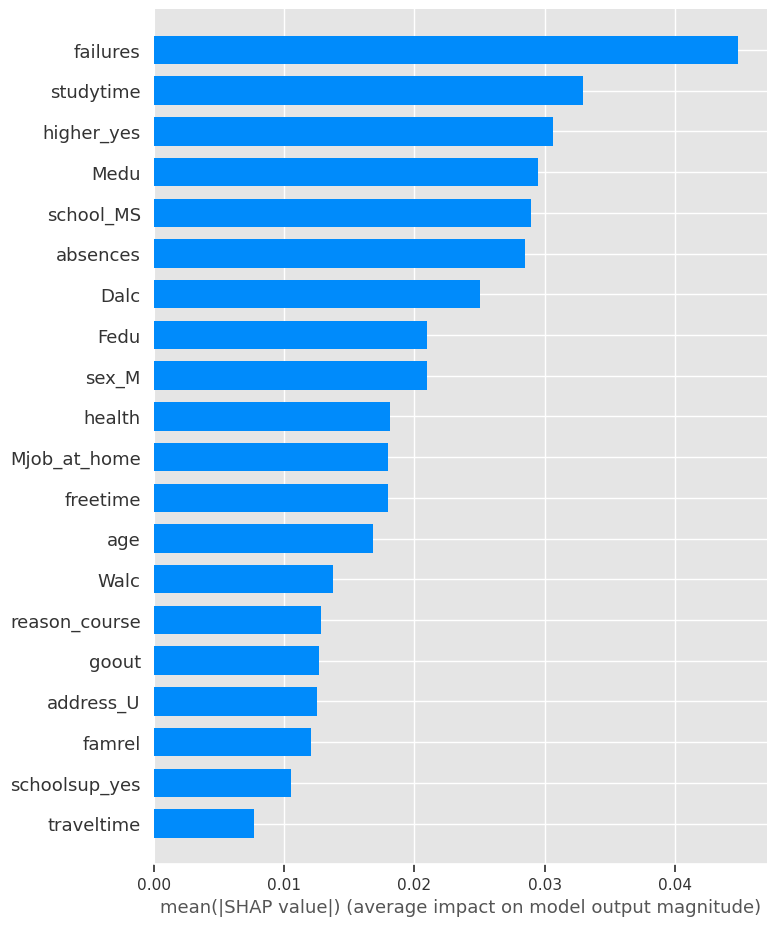

In [227]:
shap.summary_plot(shap_vals_1,features= X_shap, plot_type='bar')



- In this case, it is using the magnitude of the average SHAP values to to show which features had the biggest impact on the model's predictions.
- Based on the summary plot above, failures in other courses was the most important feature for predicting failing in Portuguese. Next was study time, and higher_yes.
- Let's remind ourselves what our random forest calculated as the feature importances, and compare the results. 

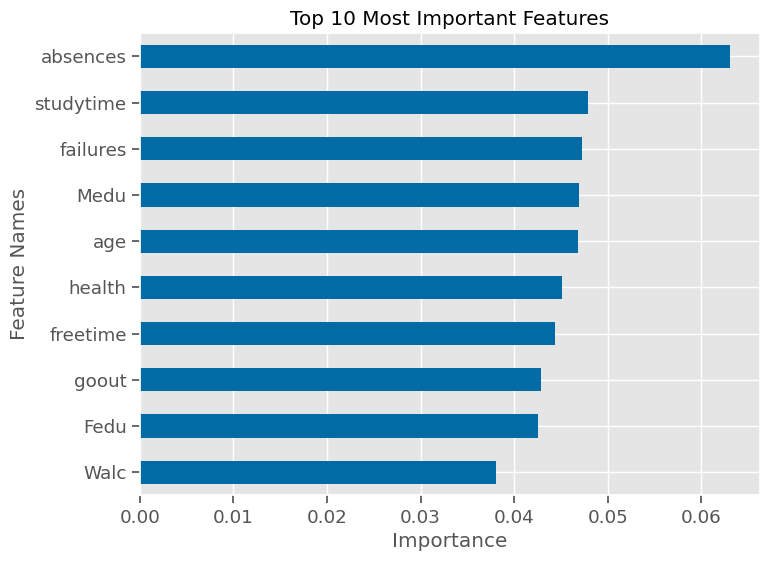

In [228]:
plot_importance(rf_importances,top_n=10);



Let's also remind ourselves of the permutation importances we calculated for the model. 

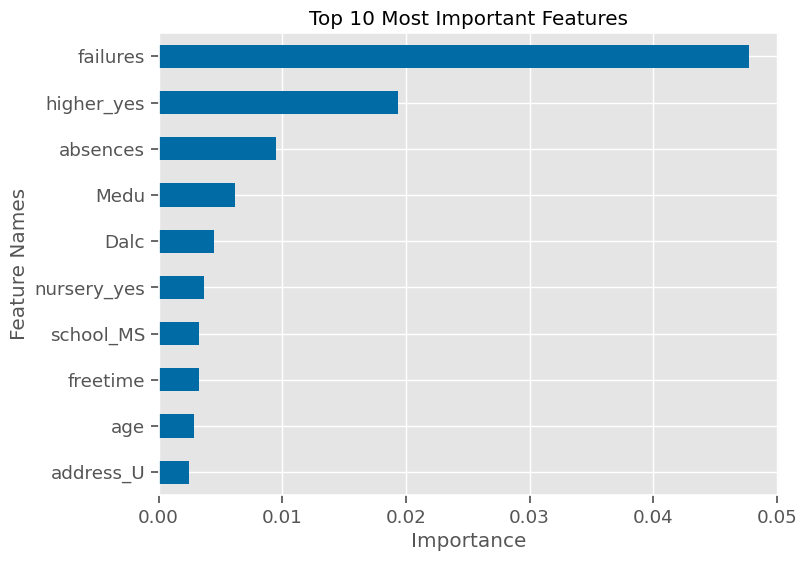

In [229]:
plot_importance(rf_perm_importances,top_n=10);



- As we can see above, SHAP's importances differ from the built-in random forest importances.
- It is also different from the permutation importances. However, the permutation importances and SHAP importances shared similar important features that were undervalued by the random forest (e.g. higher_yes).
- Like feature importance and permutation importance, this visualization is not indicating which direction the features push the prediction.
- Let's remove the plot_type='bar' argument and examine the default plot type that will provide this information.

### Summary Plot - dot (default)

- Now, let's examine the "dot" version of the summary plot.
- By removing the plot_type argument, we are using the default, which is "dot".
    - Alternately, we could explicitly specify plot_type="dot".
        - There are also additional plot types that we will not be discussing in this lesson (e.g. "violin","compact_dot")

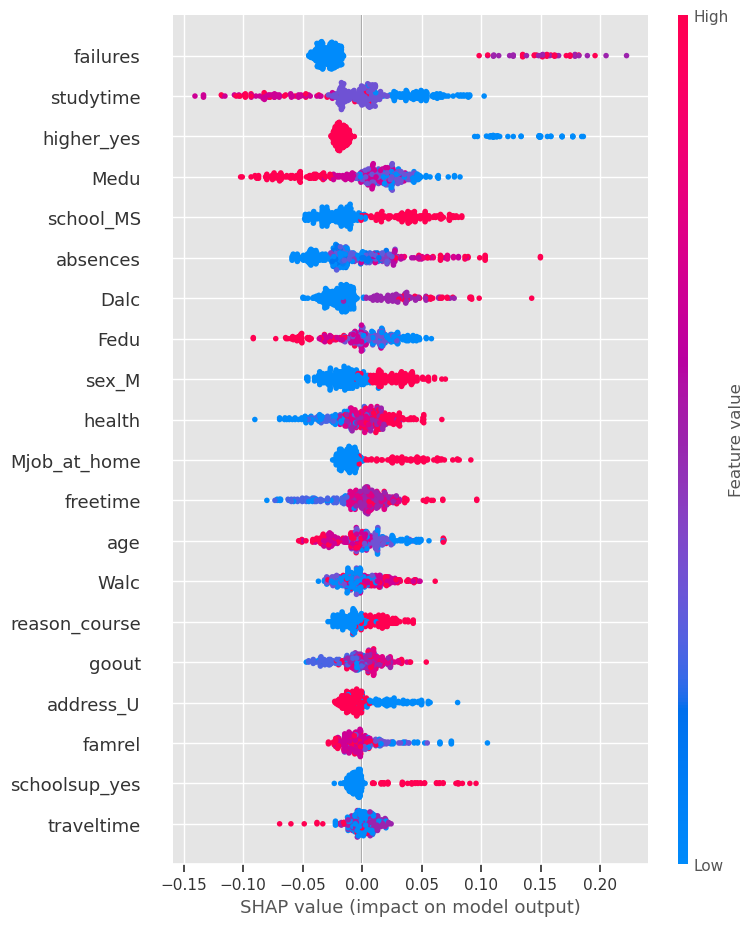

In [230]:
shap.summary_plot(shap_vals_1,X_shap)



Now THAT is a lot more nuanced of a visualization! Let's break down how to interpret the visual above.

### Reading SHAP Summary Plots

- In the summary plot above:
    - Each dot represents an observation/row (in this case, a student).
    - The features are plotted on the y-axis and are sorted from the most impactful features to the least (from top to bottom).
    - The calculated Shapley values for each observation are plotted on the x-axis. The more positive the value, the more the feature pushed the model's prediction towards predicting the current class (failing).
    - For each feature, the original values of that feature are represented with color.
        - Using the default colormap, blue represents the lowest value in the column and red represents the highest.
            - For one hot encoded categories, blue=0, red = 1.
            - For numeric features: the shade of the color indicates where it falls in the feature's distribution.

- Let's just follow the red dots for each feature. Red means the feature value is higher.
    - If the red is on the right (positive), higher values of this feature increase the chance the prediction will be fail.
    - If the red is on the left (negative), higher values of this feature decrease the chances the prediction will be fail. 

A quick glance above shows that failures and higher_yes are both very important, but they have opposite impacts. According to our model, higher values for failures increases the chance of failing Portuguese, whereas, higher values for higher_yes (1 since it is categorical) decreases the chance of failing.

It can take a bit of time to acclimate to this graph. Let's talk through some examples in detail.

### Interpreting the SHAP values for our model:

#### failures

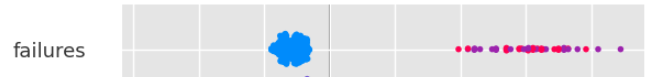

Failures had the largest effect on the model's predictions (since it was the first bar at the top of the graph).

- Because red values are on the right (positive), we can see that the greater the number of failures a student had, the more likely the model would predict the student will Fail.
- We can see that having a high number of failures pushed the model's prediction heavily towards being a failure (as judged by how far to the right of the yaxis/0-line the red samples are located).
    - Notice that the blue dots (fewer failures) are only slightly to the left of the 0-line, indicating that the model is only slightly less likely to predict a failure, compared to the big impact of having a large number of failures.

#### studytime

Because the red dots are on the left (negative) we can see that the higher the study time, the less likely the model will predict the student will fail. 

#### higher_yes

higher_yes is our first One-Hot-Encoded feature to interpret with SHAP. Since it is OHE, the values in this feature are either 0 or 1, which translates to blue=0 and red=1.

- The red values are on the left (negative) so that if higher_yes==1 (meaning the student wants to pursue higher education), then the model is much LESS likely to predict failure.
- If higher_yes==0 (the blue dots), the model is more likely to predict the student will fail.


### Important Note

- Remember, our SHAP explanations and visualizations are explaining how our model was using the features and how they influenced the model's prediction.
- It is not explaining the real-world situation. So always keep that in mind when interpreting SHAP visualizations.


## Summary
This lesson showed you how to obtain, visualize, and interpret SHAP values. SHAP's explanations provide a much more detailed and nuanced perspective on how our model is making its predictions. While the summary plots can be a little tricky to read at first, with just a little practice, you should find it much easier. 


https://www.youtube.com/watch?v=C80SQe16Rao

https://www.youtube.com/watch?v=Tg8aPwPPJ9c

# Saving SHAP plots

**Learning Objectives:**

- Save SHAP plots.
- Insert plots into a README.

## Saving Summary Plots

- Exporting images of our figures can be tricky with SHAP. It does not return an axis or a figure, so there is no variable we can use to represent the figure.

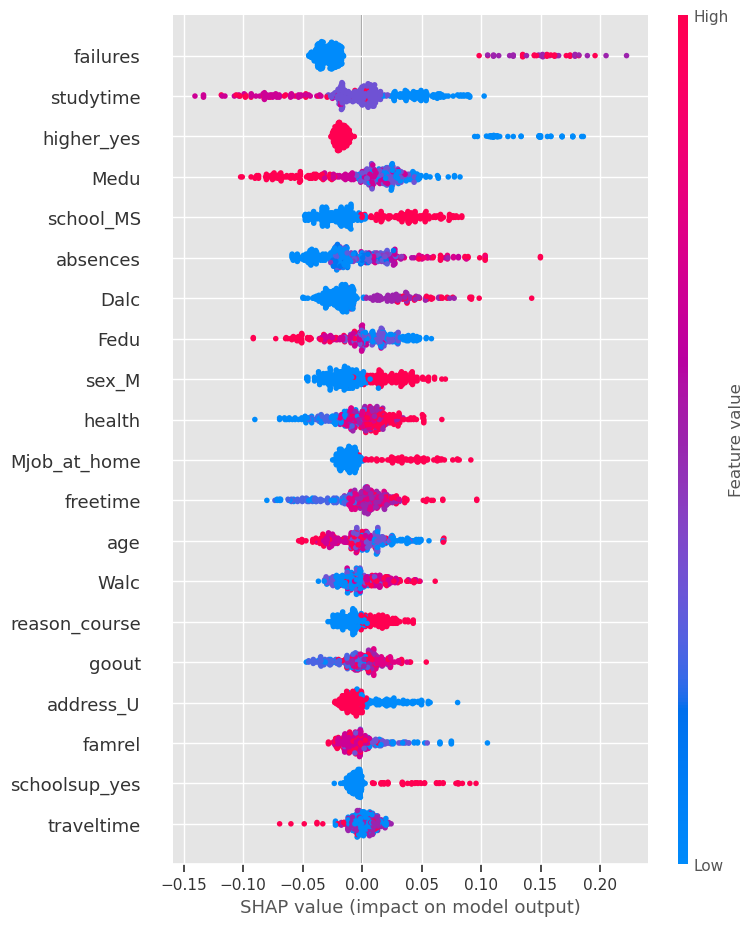

In [231]:
fig = shap.summary_plot(shap_vals_1,X_shap,)



In [232]:
print(type(fig))
fig



<class 'NoneType'>


- The solution is to create a figure immediately before using the summary plot function (in the same cell).
- We can use fig=plt.figure(), fig, ax = plt.subplots(), fig = plt.gcf()
    - We will use the plt.subplots approach in this lesson, since it will create both the fig and axis.
- Note: if we do not add show=False to the summary_plot function, then the figure we will see will not represent the final up-to-date figure.
    - notice what happens if we try to set the title below:

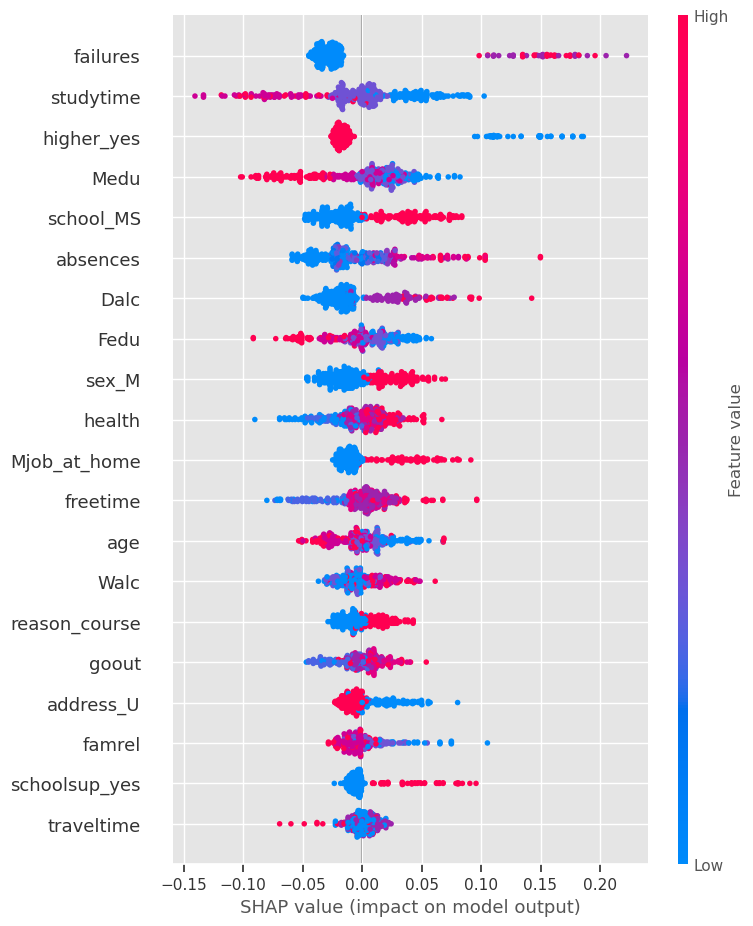

In [233]:
fig, ax = plt.subplots()
shap.summary_plot(shap_vals_1,X_shap)
ax.set_title('Summary Plot - Class=Fail');



- If we display the fig again, we will see the current final version (notice our title now appears)

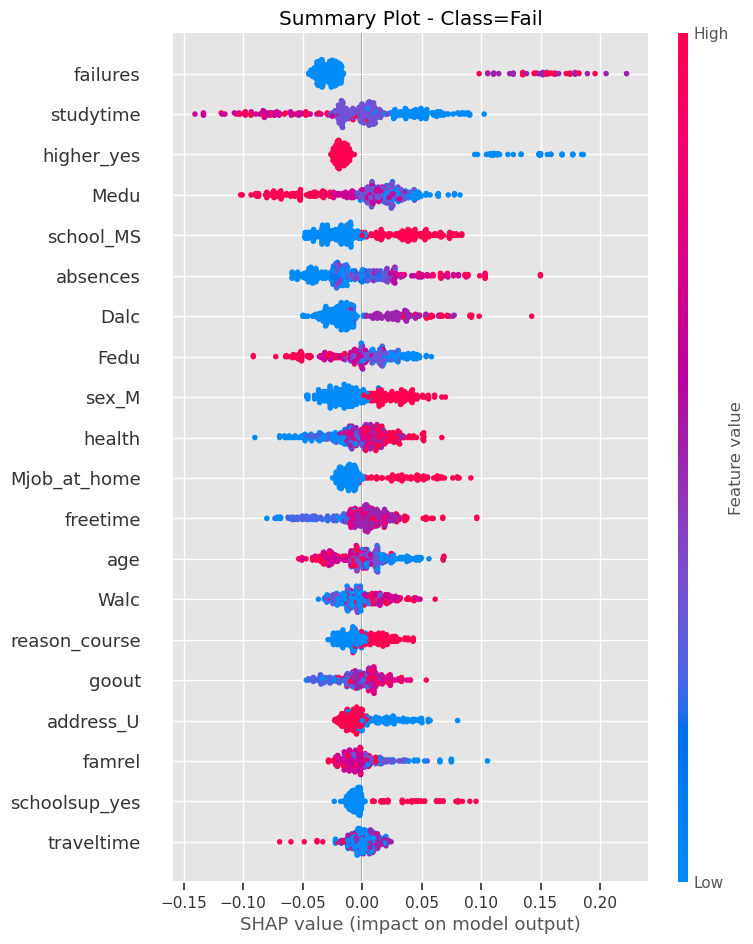

In [234]:
fig



## Using fig.savefig

- We will want to create an images folder in our repo for storing our exported images before we export our shap plots.

In [235]:
import os
os.makedirs("images/", exist_ok=True)


- Now that we have created our images folder, we will include it in our file path for our saved image.

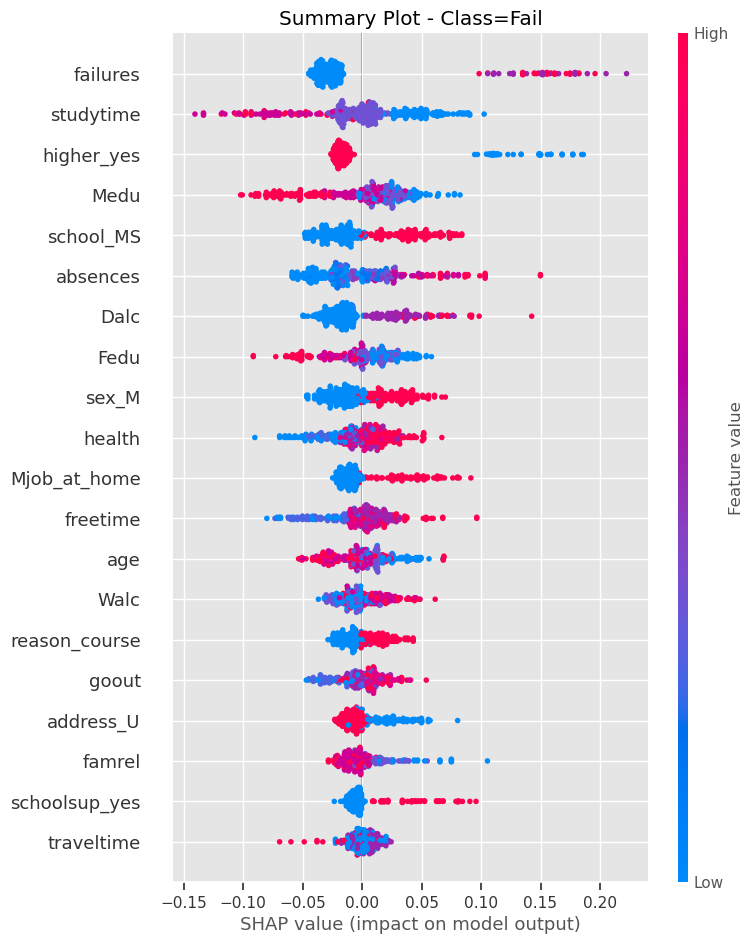

In [236]:
fig, ax = plt.subplots()
shap.summary_plot(shap_vals_1, X_shap, show=False)
ax.set_title('Summary Plot - Class=Fail');
fig.savefig('images/summary_plot_1.png')



- Now, let's insert this image into a markdown cell.
    - The most flexible way to insert an image is to use an html img tag.
    - Image tags need the filepath as the "src" argument.
    - We can also add additional style arguments to do things like resize our figure with the width argument. Below we are resizing to 60% of its original size.

<img src="images/summary_plot_1.png" width=60%>

- We could also use exact pixel values. We would use the letters "px" to indicate the units.

<img src="images/summary_plot_1.png" width=400px>

- We can also control the plot alignment. We are centering the visualization below:

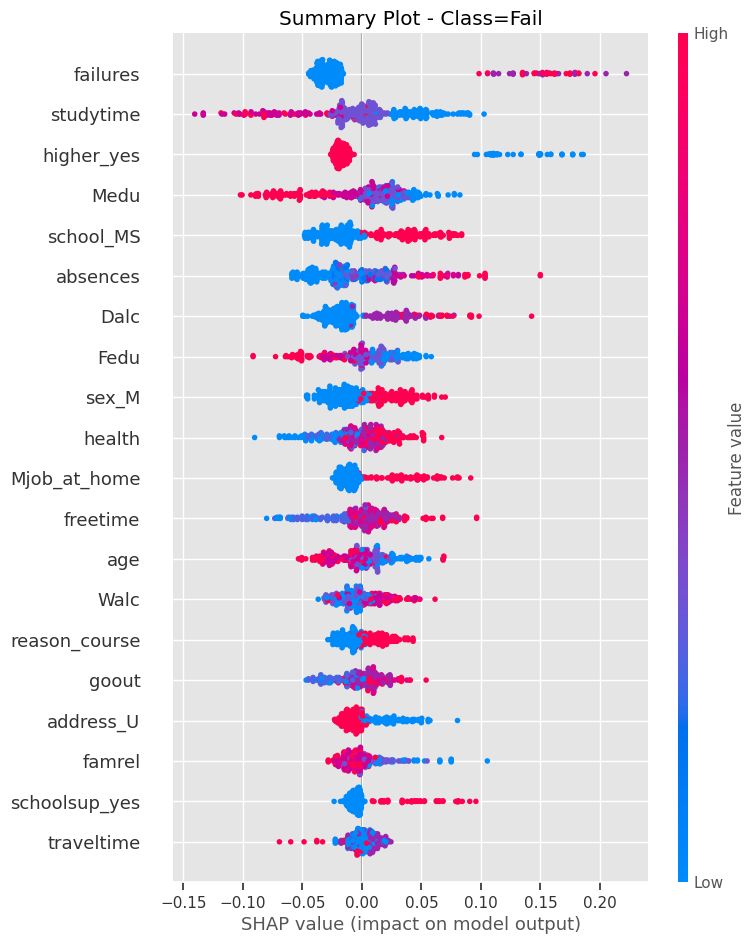

**Summary**

This lesson showed you how to save your SHAP visualizations as image files. It then showed you how to insert the image into your README using the HTML img tag to control the size/alignment of the image.

# SHAP Force Plots

## Force Plots

- Now that you've had some practice interpreting the meaning of SHAP values, let's explore SHAP's force_plot, which is an interactive function that will provide a global summary.

Intro to Force Plots - Single Observation

- Before we dive into the global version of shap's force plot, we will explore a simpler version first. We will plot the force plot for a single observation to acclimate to this new visualization before we move on to the global versions.
- Let's select a row (single student) to use for our force_plot.
    - In an upcoming lesson, we will discuss tactical selection of examples for stakeholders.
    - For now, we are selecting an arbitrary row.


In [237]:
# arbitrarily choosing a row to use
i = 100
single_row_X = X_shap.iloc[i]
single_row_y = y_shap.iloc[i]
single_shap_vals = shap_vals_1[i]
single_row_X.head(10)



age          17.00
Medu          4.00
Fedu          3.00
traveltime    2.00
studytime     2.00
failures      0.00
famrel        4.00
freetime      4.00
goout         4.00
Dalc          4.00
Name: 189, dtype: float64

In [238]:
## true class of selected row
single_row_y



True



    - Note: Because force_plot is interactive, it requires javascript (shap.initjs()) and that you must Trust your Jupyter notebook in order to display it. - In the top right corner of Jupyter notebook, next the kernel name (Python (dojo-env)), click the Not Trusted button to trust the notebook.

- To create a force plot, the function requires:
    - the expected_value (base value) for the class of interest - which we can find in our explainer.
    - The SHAP values for just that row and the features for just that row.
    - The features (X data) for just the 1 row.


In [239]:
## Individual forceplot (with the complex shap vals)
shap.force_plot(explainer.expected_value[1],shap_values=single_shap_vals.values,
               features=single_row_X)



##Interpreting an individual Force Plot (Example 1)

**In the visual above, we can see:**

- A number line at the top of the visual (with the base value labeled).
    - Here the base value is 0.5764.
- A bold value at the intersection of the red and blue is the final SHAP value for the observation.
    - Here the SHAP value is .81
- The red and blue segments with arrows towards the middle are "pushing" against each other.
    - Visually, the color with the wider bar "wins", and this decides the prediction. In this case, the contributions of the red features are greater than the blue which means a greater "push" towards failing, so the final prediction is class 1: failing.
    - The red features push the prediction to a greater value (towards class 1: failing), while the blue features push the prediction to a lower value (towards class 0: passing).
    - The wider the segment is for the feature, the greater its contribution to the prediction is.
- As you can see, Dalc (workday alcohol consumption) is the most important feature for this student. Further, the actual value for each feature is listed. For this student, Dalc = 4 (on an ordinal scale from 1-5).

Many of the feature names are displayed, but the features that had smaller contributions do not display their name by default. If you hover your mouse over the features in your Jupyter notebook, you can see their names and values.

### Another Example of a Single Observation

Let's select another observation at random:

In [240]:
# arbitrarily choosing a row to use
i = 200
single_row_X = X_shap.iloc[i]
single_row_y = y_shap.iloc[i]
single_shap_vals = shap_vals_1[i]
single_row_X.head(10)



age          18.00
Medu          2.00
Fedu          2.00
traveltime    2.00
studytime     4.00
failures      0.00
famrel        4.00
freetime      4.00
goout         4.00
Dalc          1.00
Name: 390, dtype: float64

Let's see whether this student passed or failed:

In [241]:
## true class of selected row
single_row_y


False

In [242]:
shap.force_plot(explainer.expected_value[1],shap_values=single_shap_vals.values,
               features=single_row_X)



### Interpreting an individual Force Plot (Example 2)

**In the visual above, we can see:**

- A number line at the top of the visual (with the base value labeled)
    - Here the base value is 0.5764
    - Note, this value is the same for every observation
- A bold value at the intersection of the red and blue is the final SHAP value for the observation.
    - Here the SHAP value is .15 (Note: this is much lower than our first example)
- The red and blue segments with arrows towards the middle are "pushing" against each other.
    - The red features push the prediction to a greater value (towards class 1: failing), while the blue features push the prediction to a lower value (towards class 0: passing).
    - The wider the segment is for the feature, the greater its contribution to the prediction is.
        - As you can see, studytime is the most important feature for this student. Further, the actual value for each feature is listed. For this student, studytime = 4 (which corresponds to >10 hours per week).
    - Visually, the color with the wider bar "wins", and this decides the prediction. In this case, the contributions of the blue features are much greater than the red which means a greater "push" towards passing, so the final prediction is class 0: passing.

### Global shap.force_plot

To show a global force plot, we will use the entire set of SHAP values and our X_shap variable, instead of a single observation.

In [243]:
## Global Forceplot
shap.force_plot(explainer.expected_value[1],shap_vals_1.values,features=X_shap)



- Now, the above visualization may look a little overwhelming at first, but it isn't as bad as it seems if we remember how to read our individual force plot.
- In the individual example, we had the effect of the features on 1 row's prediction displayed horizontally, with the features color-coded based on their influence on the final prediction.
- The global force plot is essentially individual force plots (but for each row) rotated 90 degrees.
    - Additionally, the force plot rearranged the rows in the data to sort them by similar values.
    - This is why we see such a strong pattern in the example above.


## Using the Interactive Features of the Force Plot

- Hovering over the figure will display the feature names and values.
- There are 2 drop down boxes (one on each axis) that control the values being displayed.


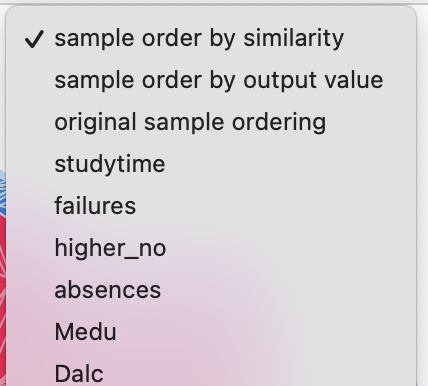


- The top drop-down menu along the x-axis controls the sorting of the rows.
- The default sorting based on similarity is generally going to be the cleanest sorting to interpret.
    - As we can see below, sorting by the original order makes it very difficult to read the visual.



- The left dropdown menu along the y-axis controls what values are being plotted.
- By default, its plotting the overall output SHAP values, like in our individual force plot.
    - We can select an individual feature from this drop down to visualize only the effects of the one feature.

Here we take a closer look at studytime:

**Summary**

In this lesson, we learned how to produce and interpret SHAP's force plots that provide additional insights and explanations for how our model determines its predictions. Force plots can be examined for each observation, or a global force plot can take into account all of the samples. While there are even more visualizations you can explore, these are the most important for deriving global explanations. 

# Comparing SHAP Usage - by Model

**Learning Objectives:**

    - Compare nuances in code to implement SHAP with different model types (Random Forest, Logistic Regression, and KNN)

## Introduction

SHAP is a powerful package, but with its power comes complexity and nuance. In the previous lesson, we introduced SHAP with a Random Forest Classifier. The exact code needed to create an explainer for different model types is not the same.

    - The models we will compare:
        - RandomForestClassifier
        - LogisticRegression
        - KNeighborsClassifier

## Fit Each Model

First, we will fit each of our model types:

### RandomForestClassifier

In [244]:
from sklearn.ensemble import RandomForestClassifier
## fit random fores
rf_clf = RandomForestClassifier()
rf_clf.fit(X_train_df,y_train)


RandomForestClassifier()

### LogisticRegression

In [245]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(max_iter=1000)
logreg.fit(X_train_df, y_train)


LogisticRegression(max_iter=1000)

### KNN

In [246]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train_df, y_train)


KNeighborsClassifier(n_neighbors=3)

## Reduce Sample Size

Here we will limit our sample size to 200 observations. 

In [247]:
X_shap = shap.sample(X_train_df,nsamples=200,random_state=321)
X_shap.head()



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
473,16.00,2.00,1.00,2.00,1.00,0.00,2.00,4.00,3.00,2.00,3.00,4.00,4.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,0.00
340,17.00,3.00,3.00,1.00,1.00,0.00,4.00,4.00,3.00,1.00,3.00,5.00,0.00,0.00,1.00,1.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00
452,16.00,2.00,2.00,3.00,2.00,0.00,4.00,4.00,5.00,1.00,1.00,4.00,4.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00
555,16.00,1.00,2.00,1.00,3.00,0.00,4.00,3.00,4.00,1.00,1.00,3.00,5.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00
70,16.00,3.00,1.00,2.00,4.00,0.00,4.00,3.00,2.00,1.00,1.00,5.00,2.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,1.00,0.00


### Match X and y for sample

 - Since we made our X_train_df using the index from the original X, we can use the index of X_shap to slice out the y-data that corresponds to our samples.

In [248]:
## get the corresponding y-values
y_shap = y_train.loc[X_shap.index]
y_shap.head()



473     True
340    False
452     True
555    False
70      True
Name: target_F, dtype: bool

## Comparing Explainers

We will now instantiate an explainer and visualize our SHAP values for each of our three model types. Specifically, pay attention to the differences in:

- The arguments included when instantiating the model
- The shape of the output

### Random Forest

We have already used Random Forest to introduce SHAP, so we will use this as our baseline for comparison.

In the code below, we instantiate an explainer for our Random Forest model:

In [249]:
## tree
explainer = shap.Explainer(rf_clf)
explainer



**For Random Forest:**

- We only need to provide the model itself when instantiating the explainer
- That the explainer itself is a explainer.Tree

Now we will examine the shape of the output:

In [250]:
## Getting the shap values
shap_values = explainer(X_shap,y_shap)
print(type(shap_values))
shap_values.shape



<class 'shap._explanation.Explanation'>


(200, 43, 2)

**For Random Forest:**

- We get 3 dimensional SHAP values, where the 3rd dimension is the number of classes in our target.
- For our visualization, we must slice out the desired class (in this case, failing = class 1) using shap_values[:,:,1].

The code below will produce a summary plot for our Random Forest model:

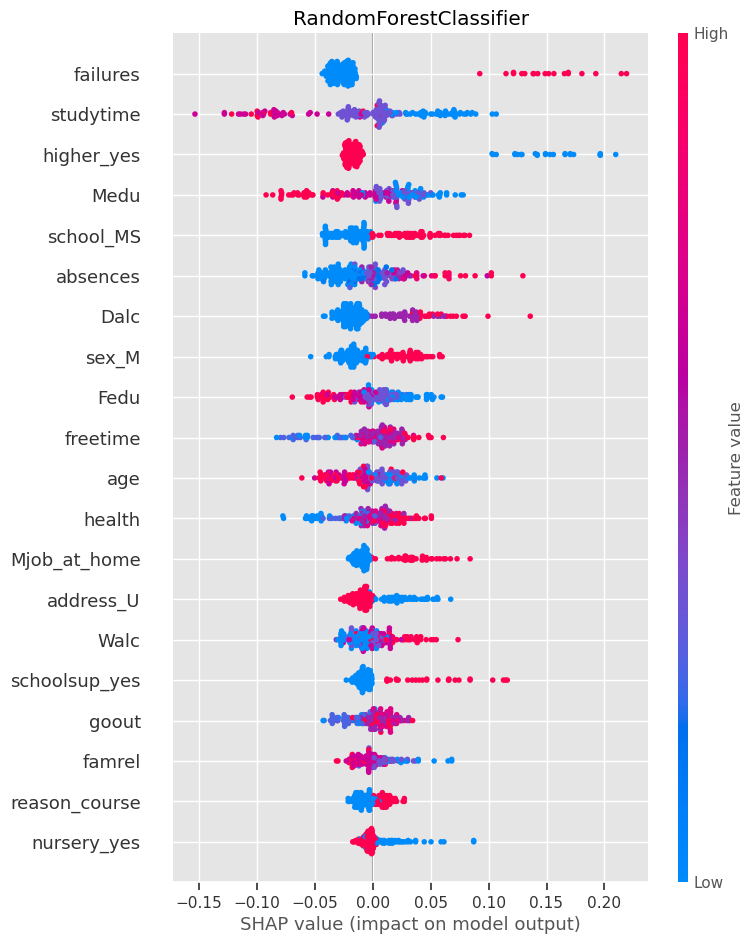

In [251]:
## option B: saving class as separate var first
shap_vals_1 = shap_values[:,:,1]
fig, ax = plt.subplots()
shap.summary_plot(shap_vals_1,features= X_shap,show=False)
ax.set_title('RandomForestClassifier');



### LogisticRegression

Now, we will instantiate an explainer for our Logistic Regression Model. Can you notice the difference when instantiating?

In [252]:
## logreg
explainer_logreg = shap.Explainer(logreg,X_shap)
explainer_logreg



**For Logistic Regression:**

- We MUST provide the X data in addition to our model when instantiating our explainer. (If not, you will receive a cryptic error message!)
- We created an explainer.Linear

Now we will examine the shape of our output for a Logistic Regression model:

In [253]:
## Getting the shap values
shap_values_logreg = explainer_logreg(X_shap)
print(type(shap_values_logreg))
shap_values_logreg.shape



<class 'shap._explanation.Explanation'>


(200, 43)

**For Logistic Regression:**

- We only get a 2-dimensional output (Remember with Random Forest, the output was 3d).
- We only get 1 set of values for the 1 class.
- Therefore do NOT need to slice out anything from our shap_values before visualizing them.

The code below will produce a summary plot for our logistic regression model:

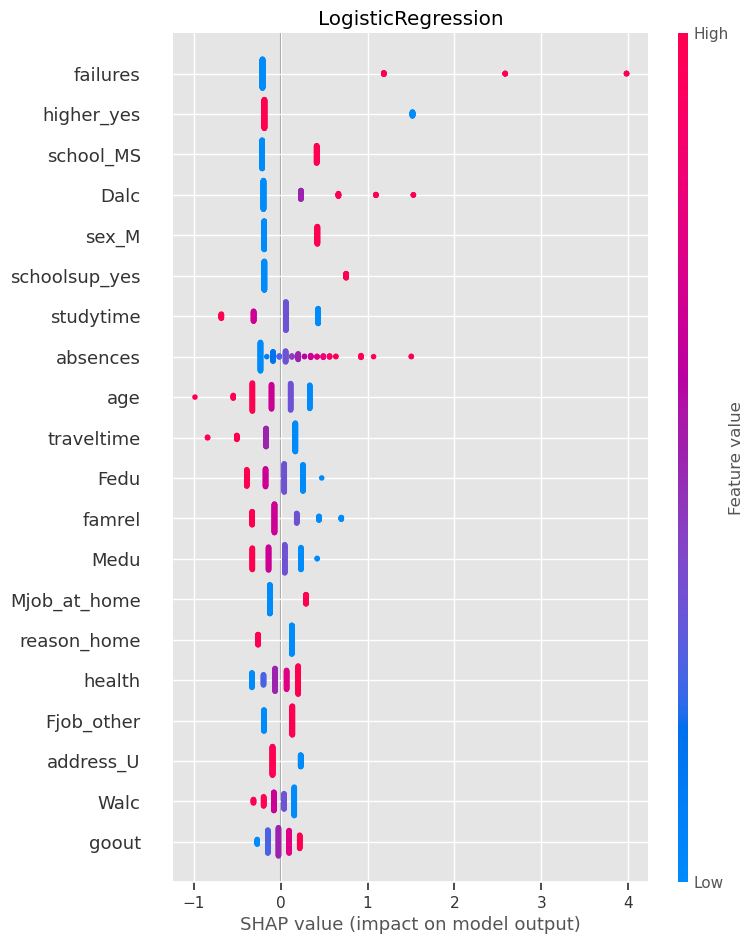

In [254]:
## logreg
fig, ax = plt.subplots()
shap.summary_plot(shap_values_logreg,features= X_shap, show=False)
ax.set_title('LogisticRegression');



- Notice that the summary plot looks very different and isn't as interesting and informative as our random forest's summary plot.

### KNN

Finally, we will instantiate an explainer for our KNN model. Can you notice another difference when instantiating the model?

In [255]:
explainer_knn = shap.Explainer(knn.predict, X_shap)
explainer_knn



For KNN:

- We MUST provide the X data as well (as we did with Logistic Regression).
- We also must pass our KNN's .predict method as the first argument, instead of the model itself (or we will receive a cryptic error message!)
- Note: Due to the fact that KNN models do all of their learning during when using .predict, calculating the SHAP values takes much longer.
- We created an explainer.Permutation.

We will examine the shape of the output as we did with our other models:

In [256]:
shap_vals_knn = explainer_knn(X_shap)
print(type(shap_vals_knn))
shap_vals_knn.shape



Permutation explainer: 201it [05:25,  1.65s/it]                                                                        

<class 'shap._explanation.Explanation'>


(200, 43)

**For KNN:**

- We only get a 2 dimensional output (Remember with Random Forest, the output was 3d).
- We only get 1 set of values for the 1 class.
- Therefore do NOT need to slice out anything from our shap_values before visualizing them.

The code below will produce a summary plot for our KNN model:

Text(0.5, 1.0, 'KNN')

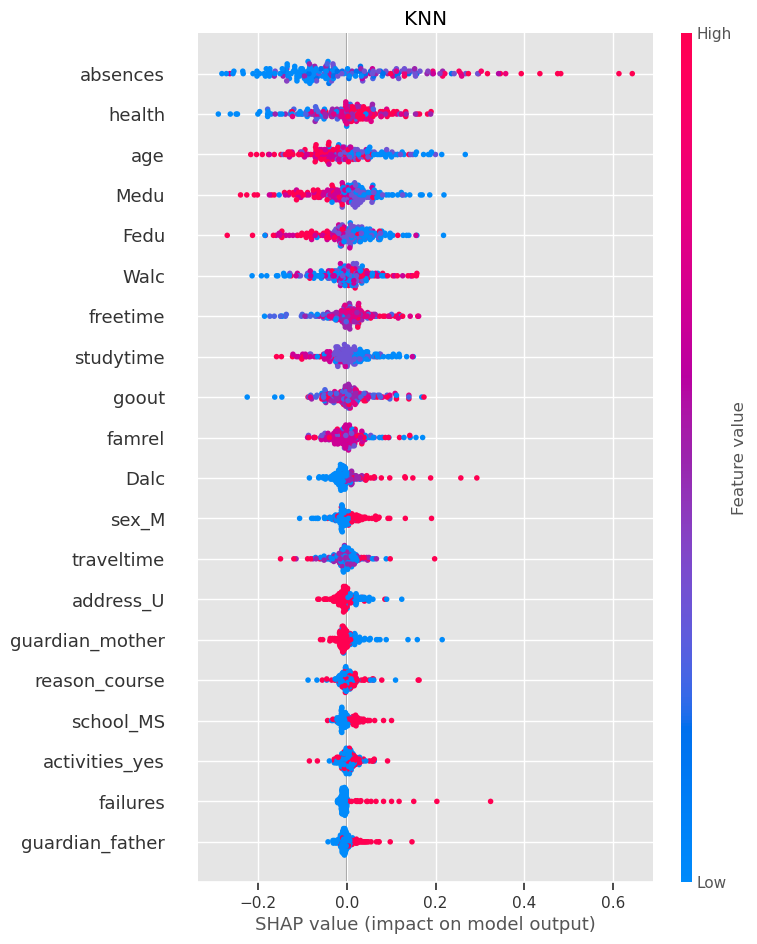

In [257]:
fig, ax = plt.subplots()
shap.summary_plot(shap_vals_knn,features= X_shap, show=False)
ax.set_title('KNN')



- Notice that the KNN summary plot looks more like our original RandomForest than the logistic regression.

**Summary**

Depending on which model you are using, your code to apply SHAP will change. The two main changes are in the arguments that must be included when instantiating the explainer and the shape of the output. The table below highlights these differences:

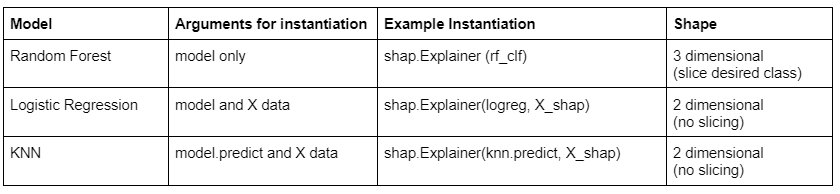

## SHAP Local Explanations

- Select representative example observations to explain.
- Use local explanation tools to convey findings to stakeholders.

### Our Model 

--------------------------------------------------------------------------------
	CLASSIFICATION REPORT
--------------------------------------------------------------------------------
[i] Training Data:
              precision    recall  f1-score   support

       False       1.00      1.00      1.00       205
        True       1.00      1.00      1.00       281

    accuracy                           1.00       486
   macro avg       1.00      1.00      1.00       486
weighted avg       1.00      1.00      1.00       486



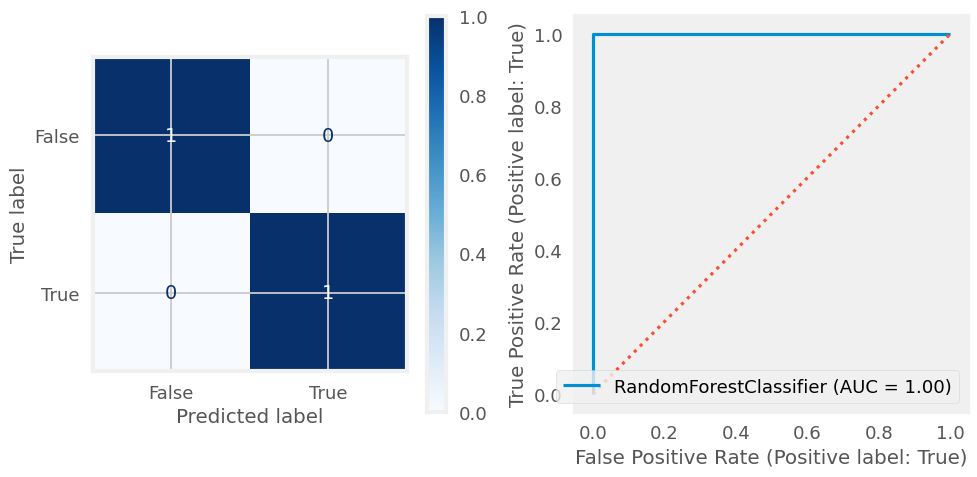

--------------------------------------------------------------------------------
[i] Test Data:
              precision    recall  f1-score   support

       False       0.81      0.70      0.75        71
        True       0.79      0.87      0.83        92

    accuracy                           0.80       163
   macro avg       0.80      0.79      0.79       163
weighted avg       0.80      0.80      0.80       163



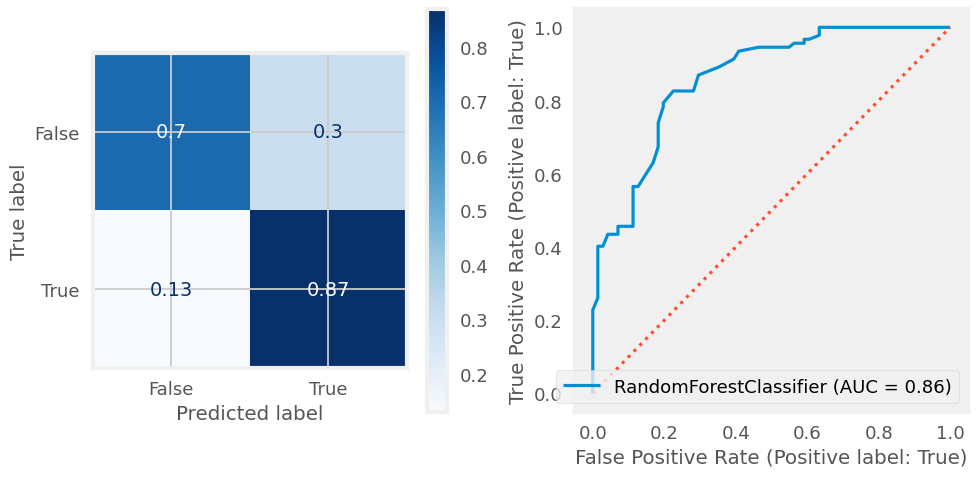

In [260]:
## fit random forest
from sklearn.ensemble import RandomForestClassifier
rf_clf = RandomForestClassifier()
rf_clf.fit(X_train_df,y_train)
evaluate_classification(rf_clf,X_train_df,y_train, X_test_df,y_test)



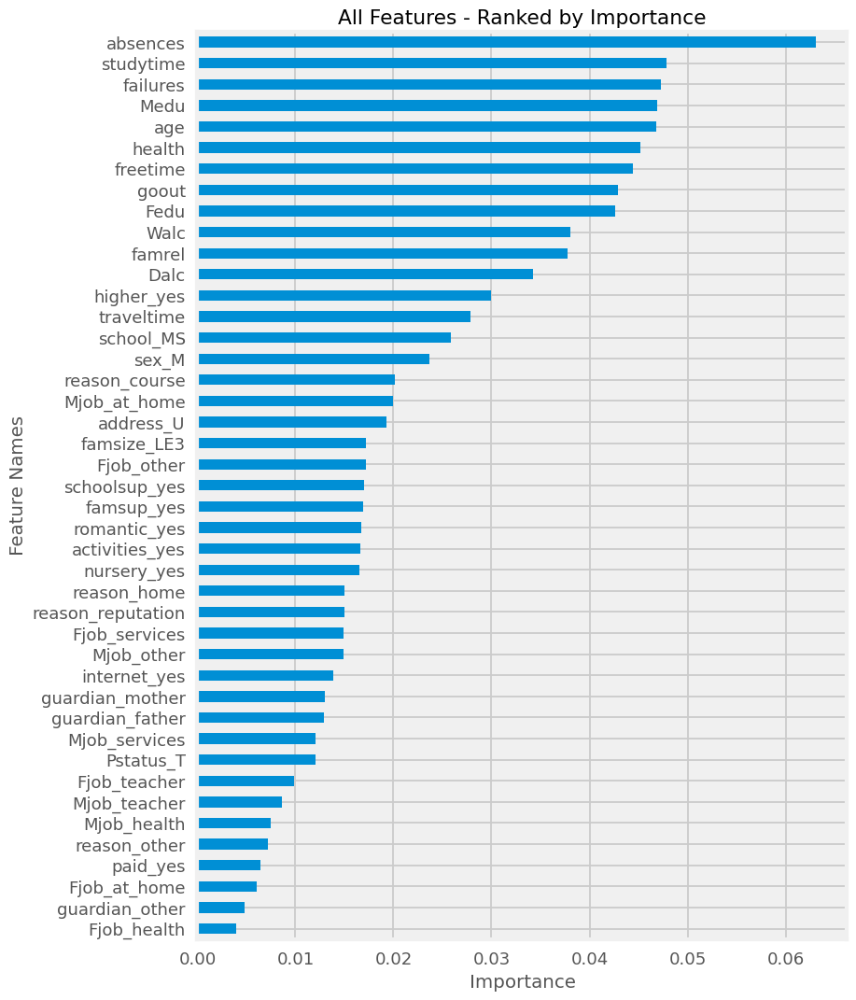

In [261]:
rf_importances = get_importances(rf_clf)
ax = plot_importance(rf_importances, figsize=(8,12))



In [262]:
# Import shap and initialize javascript:
import shap
shap.initjs()



In [263]:
len(X_train_df)



486

Here is where we could reduce our sample size, but 486 is relatively small, so we will keep the entire data set. In fact, we will include ALL of our data here by recombining our train and test sets. 

In [264]:
## Using the entire dataset (still relatively small)
X_shap = pd.concat([X_train_df, X_test_df])


In [265]:
y_shap = pd.concat([y_train,y_test])
y_shap



54     False
208     True
23      True
547     True
604     True
       ...  
333    False
454     True
56     False
203     True
182    False
Name: target_F, Length: 649, dtype: bool

- In order to slice out the correct shap values later on, we are going to sort the X and y data by their index. This way, the same integer index would work for X_shap, y_shap, and shap_values. 

In [266]:
X_shap = X_shap.sort_index()
y_shap = y_shap.sort_index()
display(X_shap.head(),y_shap.head())



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
0,18.00,4.00,4.00,2.00,2.00,0.00,4.00,3.00,4.00,1.00,1.00,3.00,4.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00
1,17.00,1.00,1.00,1.00,2.00,0.00,5.00,3.00,3.00,1.00,1.00,3.00,2.00,0.00,0.00,1.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,1.00,0.00
2,15.00,1.00,1.00,1.00,2.00,0.00,4.00,3.00,2.00,2.00,3.00,3.00,6.00,0.00,0.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00
3,15.00,4.00,2.00,1.00,3.00,0.00,3.00,2.00,2.00,1.00,1.00,5.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00
4,16.00,3.00,3.00,1.00,2.00,0.00,4.00,3.00,2.00,1.00,2.00,5.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,0.00


0     True
1     True
2     True
3    False
4    False
Name: target_F, dtype: bool

In [267]:
explainer = shap.Explainer(rf_clf)
explainer



In [268]:
## Getting the shap values
shap_values = explainer(X_shap,y_shap)


In [269]:
shap_vals_1 = shap_values[:,:,1]
shap_vals_1.shape



(649, 43)

### Note about Creating X_shap & y_shap with large datasets

In the current example, we have a very small number of rows and can afford to use the entire dataset. This will not be case in most situations.

- Remember that with larger datasets, we would want to use shap.sample to take a subset of our X data. Since we used the original index when creating our X_train_df and y_train, we can create y_shap by slicing out the index of X_shap with .loc

In [270]:
X_shap = shap.sample(X_train_df, nsamples=400,random_state=321)
y_shap = y_train.loc[X_shap.index]


- In order to make sure our integer indices for our calculate shap_values will match the index of our X_shap and y_shap variables, we will use .reset_index(drop=True) instead of .sort_index(). This way the indices for X_shap and y_shap are the same as their position.

In [271]:
X_shap_local = X_shap.reset_index(drop=True)
y_shap_local = y_shap.reset_index(drop=True)


- Note: while the result will look the same, the indices of our X_shap and y_shap variables no longer match the indices from the original dataset, so we will not be able to identify the original row if we wanted to.

In [272]:
## Getting the shap values wth the local X_shap 
shap_values = explainer(X_shap_local,y_shap_local)
shap_vals_1 = shap_values[:,:,1]


### Getting Final Predictions

- We will want to know what our model would predict for any of our examples. To this end, we will want to get the predictions from our model for our X_shap.
- Additionally, it may be helpful to extract the predicted probabilities as well, instead of just the final class.

In [273]:
y_pred = rf_clf.predict(X_shap_local)
y_pred = pd.Series(y_pred, index=X_shap_local.index, name='Predicted')
y_pred



0       True
1      False
2       True
3      False
4       True
       ...  
395     True
396    False
397     True
398     True
399     True
Name: Predicted, Length: 400, dtype: bool

In [274]:
y_proba = rf_clf.predict_proba(X_shap_local)
y_proba



array([[0.02, 0.98],
       [0.77, 0.23],
       [0.12, 0.88],
       [0.74, 0.26],
       [0.18, 0.82],
       [0.03, 0.97],
       [0.07, 0.93],
       [0.09, 0.91],
       [0.89, 0.11],
       [0.8 , 0.2 ],
       [0.15, 0.85],
       [0.87, 0.13],
       [0.83, 0.17],
       [0.15, 0.85],
       [0.85, 0.15],
       [0.24, 0.76],
       [0.02, 0.98],
       [0.01, 0.99],
       [0.14, 0.86],
       [0.15, 0.85],
       [0.87, 0.13],
       [0.08, 0.92],
       [0.79, 0.21],
       [0.8 , 0.2 ],
       [0.79, 0.21],
       [0.1 , 0.9 ],
       [0.02, 0.98],
       [0.08, 0.92],
       [0.1 , 0.9 ],
       [0.74, 0.26],
       [0.91, 0.09],
       [0.81, 0.19],
       [0.11, 0.89],
       [0.02, 0.98],
       [0.02, 0.98],
       [0.87, 0.13],
       [0.86, 0.14],
       [0.07, 0.93],
       [0.1 , 0.9 ],
       [0.15, 0.85],
       [0.02, 0.98],
       [0.28, 0.72],
       [0.23, 0.77],
       [0.89, 0.11],
       [0.8 , 0.2 ],
       [0.1 , 0.9 ],
       [0.81, 0.19],
       [0.08,

In [275]:
y_proba.shape



(400, 2)

In [276]:
y_proba = pd.Series(y_proba[:,1], index=X_shap_local.index, name='Predicted Prob')
y_proba



0     0.98
1     0.23
2     0.88
3     0.26
4     0.82
      ... 
395   0.83
396   0.27
397   0.84
398   0.85
399   0.93
Name: Predicted Prob, Length: 400, dtype: float64

### Selecting Examples - Based on Important Features

To give our stakeholder more of a story associated with the findings, it can be useful to select some representative examples from our data set. The exact samples chosen will vary, but you should be purposeful about which samples you select to highlight.

First, we will revisit our summary plot to help us select features of interest: 

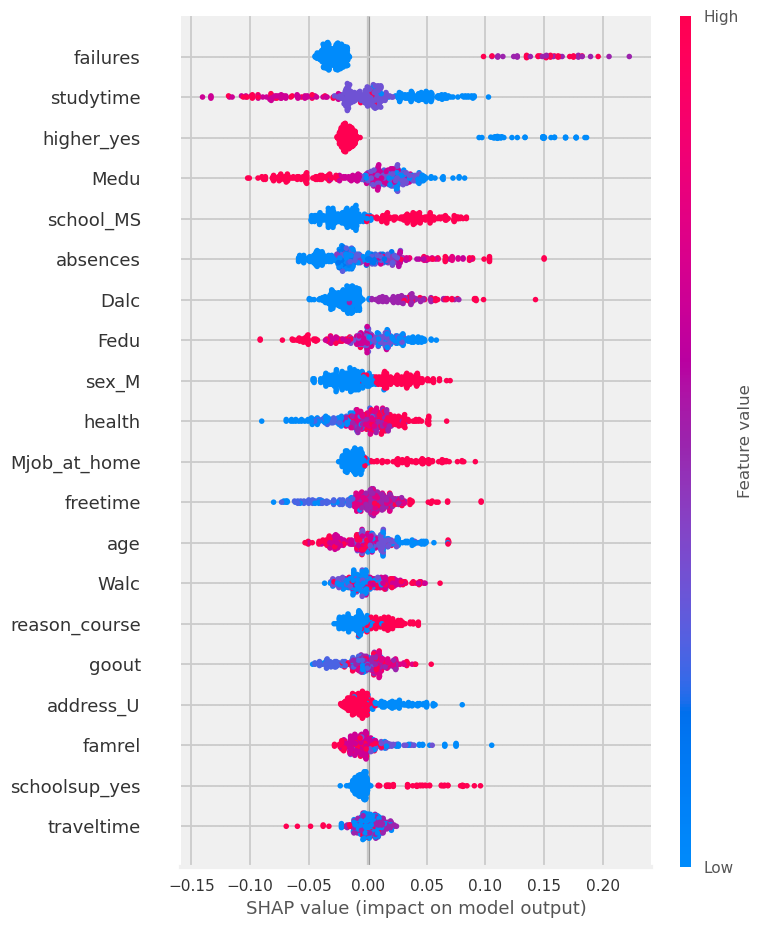

In [277]:
shap.summary_plot(shap_vals_1,X_shap_local)



- We noticed several important/impactful features over the last several lessons.
- It would be very helpful to find some observations that will demonstrate some of our interesting findings.
- Some interesting features/examples to explore:
    - Students with mean/median study time
    - Students with mean/median Dalc

### Students with Mean/Median Study Time

<Axes: xlabel='studytime', ylabel='Count'>

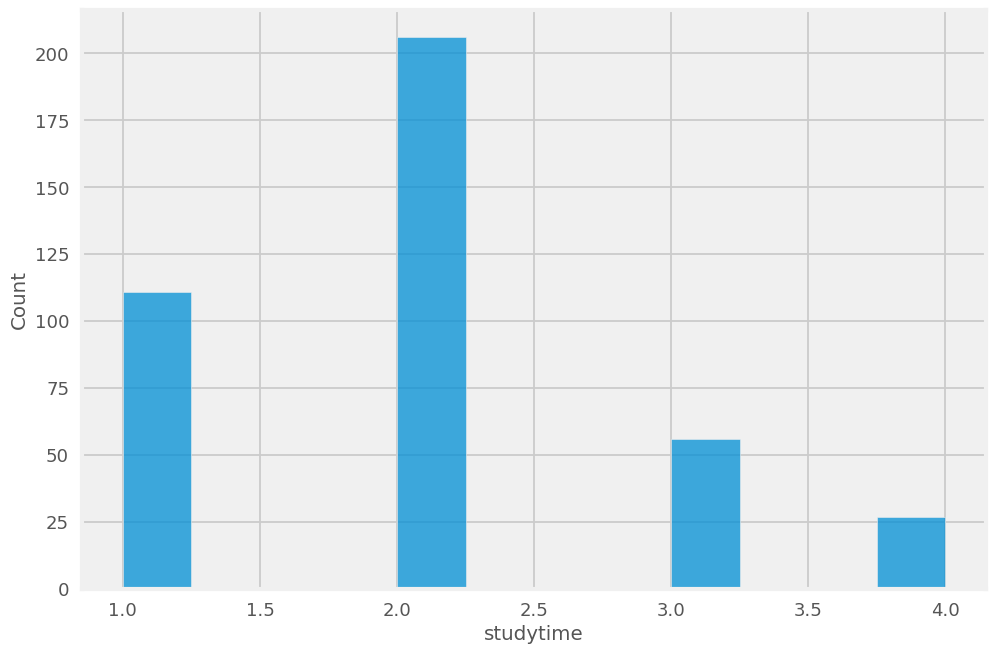

In [278]:
sns.histplot(X_shap_local['studytime'])



- According to the data dictionary, "studytime":

    - weekly study time (numeric: 1 - <2 hours, 2 - 2 to 5 hours, 3 - 5 to 10 hours, or 4 - >10 hours)

In [279]:
X_shap_local['studytime'].agg(['mean','median'])



mean     2.00
median   2.00
Name: studytime, dtype: float64

In [280]:
## Finding number of students with studytime==2.
filt_med_study = X_shap_local['studytime'] == 2.0
len(X_shap_local[filt_med_study])



206

- As we can see, many students fall into this category (305).
- Let's further filter out for important features. Higher_yes may be a good feature to use.

### Students Intent to Pursue Higher Education

- We will be filtering out students who intend to pursue higher education, but who only put in the average amount of study time.

In [281]:
filt_higher_yes = X_shap_local['higher_yes']==True
len(X_shap_local[ filt_med_study & filt_higher_yes])



193

Removing students who do not plan to attend higher education, brings our number of students down to 286.

### Students - Weekday Alcohol Consumption

- Let's also filter based on Dalc, weekday alcohol consumption.

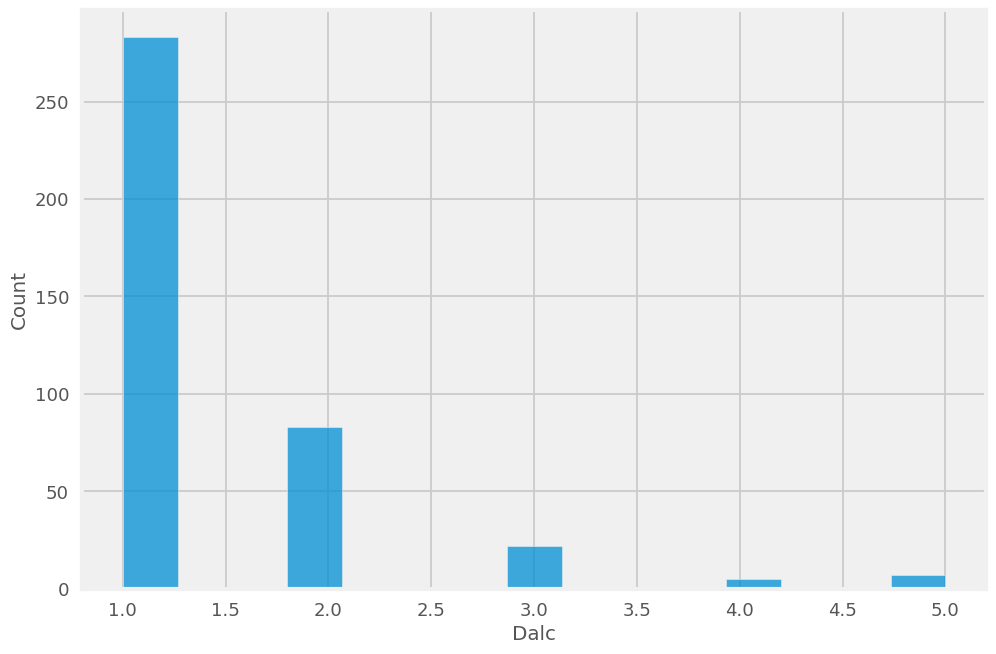

In [282]:
sns.histplot(X_shap_local['Dalc']);


- According to the data dictionary:
    - Dalc: workday alcohol consumption (numeric: from 1 - very low to 5 - very high)
- **Let's create 2 separate groups with our filters.**
    - Students with **low** Dalc (weekday alcohol consumption)
    - Students with **high** Dalc (weekday alcohol consumption)

In [283]:
filt_low_drinkers = X_shap_local['Dalc']==1
filt_low_drinkers



0      False
1       True
2       True
3       True
4       True
       ...  
395     True
396     True
397     True
398     True
399     True
Name: Dalc, Length: 400, dtype: bool

In [284]:
len(X_shap_local[ filt_med_study & filt_higher_yes & filt_low_drinkers])



143

- We have 143 students who had average study time, want to attend higher education, and who are LOW drinkers. 

In [285]:
filt_hi_drinkers = X_shap_local['Dalc']>3
len(X_shap_local[ filt_med_study & filt_higher_yes & filt_hi_drinkers])



4

- We have 4 students who had average time, want to attend higher education, and who are HIGH drinkers.

## Defining Our Example Groups

- To make it easier to work with our complex slicing. Let's define group names for each set of criteria.

    - Both Groups:
        - Have average study time
        - Intend to continue higher education
    - Group High:
        - High Weekday Drinkers
    - Group Low:
        - Low Weekday Drinkers

### Filtering Based on Final Class

- For both Group High and Group Low, let's consider an example of a student who Failed and one who Passed.

In [286]:
filt_fail = y_shap_local==True
filt_pass = y_shap_local==False



In [287]:
## Get filter for all group High that passed
filt_grp_high_pass = filt_med_study & filt_higher_yes &filt_hi_drinkers & filt_pass
filt_grp_high_pass.sum()



1

In [288]:
## Get filter for all group High that failed
filt_grp_high_fail = filt_med_study & filt_higher_yes &filt_hi_drinkers & filt_fail
filt_grp_high_fail.sum()



3

- As we can see above, in Group High (high drinkers) we have:

    - 1 student that passed
    - 3 students that failed.

In [289]:
## Get filter for all group Low that passed
filt_grp_low_pass = filt_med_study & filt_higher_yes &filt_low_drinkers & filt_pass
filt_grp_low_pass.sum()



71

In [290]:
## Get filter for all group Low that failed
filt_grp_low_fail = filt_med_study & filt_higher_yes &filt_low_drinkers & filt_fail
filt_grp_low_fail.sum()



72

- As we can see above, in Group Low (low drinkers) we have:
    - 71 student that passed
    - 72 students that failed.

## Select one example of each for further exploration

We will now select an individual sample to explore with each of these conditions:

- High drinker who passed
- High drinker who failed
- Low drinker who passed
- Low drinker who failed

Also recall that all four of our samples had average study time and want to attend higher education.

### Group High: Passed

Obtain the index value of high drinkers who passed:

In [291]:
## Selecting indices of Group High students who passed
idx_examples_grp_high_Pass = X_shap_local[filt_grp_high_pass].index
idx_examples_grp_high_Pass



Index([287], dtype='int64')

Recall that we only had one student in the high drinking group who passed. They were the student at index position 287.

If you had more students, you could randomly select one with np.random.choice().

In [292]:
## selecting index of final example
i_grp_high_pass = 287  
# or use np.random.choice(idx_examples_grp_high_Pass)
example_grp_high_pass = X_shap_local.loc[i_grp_high_pass]
example_grp_high_pass



age                 17.00
Medu                 2.00
Fedu                 2.00
traveltime           1.00
studytime            2.00
failures             0.00
famrel               4.00
freetime             4.00
goout                2.00
Dalc                 5.00
Walc                 5.00
health               4.00
absences             0.00
school_MS            0.00
sex_M                1.00
address_U            1.00
famsize_LE3          1.00
Pstatus_T            1.00
Mjob_at_home         0.00
Mjob_health          0.00
Mjob_other           1.00
Mjob_services        0.00
Mjob_teacher         0.00
Fjob_at_home         0.00
Fjob_health          0.00
Fjob_other           1.00
Fjob_services        0.00
Fjob_teacher         0.00
reason_course        0.00
reason_home          1.00
reason_other         0.00
reason_reputation    0.00
guardian_father      1.00
guardian_mother      0.00
guardian_other       0.00
schoolsup_yes        0.00
famsup_yes           0.00
paid_yes             0.00
activities_y

#### Group High: Failed

Obtain the index values for high drinkers who failed:

In [293]:
## Selecting indices of Group A students who failed
idx_examples_grp_high_Fail = X_shap_local[filt_grp_high_fail].index
idx_examples_grp_high_Fail



Index([57, 100, 118], dtype='int64')

Recall that we had 3 students in the high-drinking group who failed.  Once again, if we had a larger number of observations to sift through, we could use the random method to select one of these 3 for further exploration. Since we only have 3, we will manually select an index.

In [294]:
## Select a random index from the list.
i_grp_high_fail = np.random.choice(idx_examples_grp_high_Fail)
i_grp_high_fail = 57
example_grp_high_fail = X_shap_local.loc[i_grp_high_fail]
example_grp_high_fail.head()



age          18.00
Medu          2.00
Fedu          2.00
traveltime    2.00
studytime     2.00
Name: 57, dtype: float64

#### Group Low: Passed

We will repeat the process to select a student from the low-drinking group who passed:

In [295]:
## Selecting indices of Group A students who passed
idx_examples_grp_low_Pass = X_shap_local[filt_grp_low_pass].index
## selecting index of final example
i_grp_low_pass = np.random.choice(idx_examples_grp_low_Pass)
example_grp_low_pass = X_shap_local.loc[i_grp_low_pass]
example_grp_low_pass.head()



age          17.00
Medu          3.00
Fedu          2.00
traveltime    1.00
studytime     2.00
Name: 268, dtype: float64

- Note: since np.random.choice is a random selection, your example may not match the one seen in this lesson. That's ok! Just follow along with the logic, as applied to the example selected here.

#### Group Low: Failed

And finally, we will repeat the process to identify a low drinker who failed:

In [296]:
## Selecting indices of Group A students who failed
idx_examples_grp_low_Fail = X_shap_local[filt_grp_low_fail].index
## Select an example index from the list.
i_grp_low_fail = 331
example_grp_low_fail = X_shap_local.loc[i_grp_low_fail]
example_grp_low_fail.head()



age          16.00
Medu          2.00
Fedu          1.00
traveltime    2.00
studytime     2.00
Name: 331, dtype: float64

## Visualizing Individual Shap for Selected Examples

Now we have four individual samples to explore

    - High drinker who passed
    - High drinker who failed
    - Low drinker who passed
    - Low drinker who failed

Since we sorted the index of our X_shap before calculating shap values, we can use the index name that we'd use with .loc to slice out from the X_shap with .iloc and to slice from our shap_values using the same index.

### Group High (High Drinkers)

#### Group High: Passed

Now we will look at the true and predicted class for our example:

In [297]:
print(f"Example of a High Drinker that Passed:")
print(f"True Class: Fail = {y_shap_local.loc[i_grp_high_pass]}")
print(f"Predicted Class: Fail = {y_pred.loc[i_grp_high_pass]}")



Example of a High Drinker that Passed:
True Class: Fail = False
Predicted Class: Fail = False


The model got this one correct. Both the true outcome and the prediction were Passing (Fail == False).

**Force Plot**

Recall that we first introduced individual force plots when learning how to read global force plots.

Now we will examine the force plot for this student:

In [298]:
## Individual forceplot of example high drinker 
shap.force_plot(explainer.expected_value[1],
                shap_values=shap_vals_1[i_grp_high_pass].values,
               features=X_shap_local.iloc[i_grp_high_pass])



- As we can see in the force plot above for the example student that is a high drinker who passed:
    - We can see that while having high weekend alcohol consumption(Walc), and being Male were both pushing the prediction towards failing, many features were pushing the prediction in the passing direction: he had 0 absences, 0 failures, goes out with friends only 2 out of 5 ordinal scale, and the reason the student is attending the school is it is close to home.

#### Group High: Failed

Let's see how our model performed for our example of a high drinker who failed:

In [299]:
print(f"Example of High Drinker that Failed:")
print(f"True Class: Fail = {y_shap_local.loc[i_grp_high_fail]}")
print(f"Predicted Class: Fail = {y_pred.loc[i_grp_high_fail]}")



Example of High Drinker that Failed:
True Class: Fail = True
Predicted Class: Fail = True


The model got this prediction correct also.

Let's take a look at the force plot:

In [300]:
## Individual forceplot of example low drinker
shap.force_plot(explainer.expected_value[1],shap_values=shap_vals_1[i_grp_high_fail].values,
               features=X_shap_local.iloc[i_grp_high_fail])



- As we can see in the force plot above for the example student that is a high drinker who failed:
    - In addition to high weekday alcohol consumption (5 out of 5), a whopping 9 absences, and being male, the student ALSO had high weekend alcohol consumption (5 out of 5). 
    - A few small "pushes" towards predicting passing included the student had such a small effect that we do not even see their feature names.

### Comparing High Drinkers: Pass vs Fail

- We can see that both students had high weekday alcohol consumption and were male. However, the major differences were that the student who failed had a high number of absences AND high weekend alcohol consumption.

#### Group Low (Low Drinkers)
Now let's explore our low drinkers:
Group Low: Passed

In [301]:
print(f"Example of a Low Drinker that Passed:")
print(f"True Class: Fail = {y_shap_local.loc[i_grp_low_pass]}")
print(f"Predicted Class: Fail = {y_pred.loc[i_grp_low_pass]}")



Example of a Low Drinker that Passed:
True Class: Fail = False
Predicted Class: Fail = False


The prediction was correct for this low drinker who passed.

Examine the force plot:

In [302]:
## Individual forceplot of example high drinker 
shap.force_plot(explainer.expected_value[1],shap_values=shap_vals_1[i_grp_low_pass].values,
               features=X_shap_local.iloc[i_grp_low_pass])



- As we can see in the force plot above for the example student that is a low drinker who passed:
    - while there were some features that were pushing the prediction towards failing, their effect was very small.
- Many more features were pushing in the opposite direction towards passing:
    - Attends GP
    - age is 17
    - No failures
    - Goes out only sometimes (only 2 out of 5)
    - plans to pursue higher education.

#### Group Low: Failed

In [303]:
print(f"Example of a Low Drinker that Failed:")
print(f"True Class: Fail = {y_shap_local.loc[i_grp_low_fail]}")
print(f"Predicted Class: Fail = {y_pred.loc[i_grp_low_fail]}")



Example of a Low Drinker that Failed:
True Class: Fail = True
Predicted Class: Fail = True


This prediction was also correct.

Now let's see what contributed to this prediction by examining our force plot:

In [304]:
## Individual forceplot of example low drinker 
shap.force_plot(explainer.expected_value[1],shap_values=shap_vals_1[i_grp_low_fail].values,
               features=X_shap_local.iloc[i_grp_low_fail])



- As we can see in the force plot above for the example student that is a low drinker who failed:

    - there were many features pushing the prediction towards failing:
        - low study time (2 out of 5)
        - Father's education level is low (1 out of 5)
        - being male
        - Mother's education level is low (2 out of 5)
        - Attends MS
        - and more.
        - There were a few features pushing in the opposite direction, toward passing:
            - 0 failures
            - 0 absences

**Summary**

This lesson is just an example of the process to get you started on your dig into the data to find the story you want to share with your stakeholders. Note that we have only examined one example of each case. Also, we could certainly filter for more features to keep additional features more consistent. For example, we might want to look separately at males and females or separately at students at each of the schools. Alternatively, you might want to look at the cases where your model predictions were wrong to understand why it made the prediction it did. There are many ways to filter and choose examples. Now that you see the process keep on exploring!

# (Optional) More Local SHAP Plots


**Learning Objectives:**

By the end of this lesson students will be able to:

- Create and interpret alternative plots to tools to convey findings to stakeholders.

This lesson picks up after the lesson SHAP -individual explainers


## Additional Shap Visualizations for Local Explainers

- As an alternative to force plots, you may also want to try producing alternative plots like the ones featured below.

### Additional Plots - Waterfall

- The waterfall plot will show the top features that influenced the prediction for this observtion.
- It is showing the same information as our individual force plot, though in a simpler form.
    - The effect of each feature is on a separate line with the final shap value annotated above the plot.
    - Each feature is shown as an arrow pointing left or right.
    - The end of each arrow shows the cumulative shap value from summing the features below it.
    - Only the top features are shown individually with the remaining features are lumped together in 1 final arrow at the bottom of the plot.

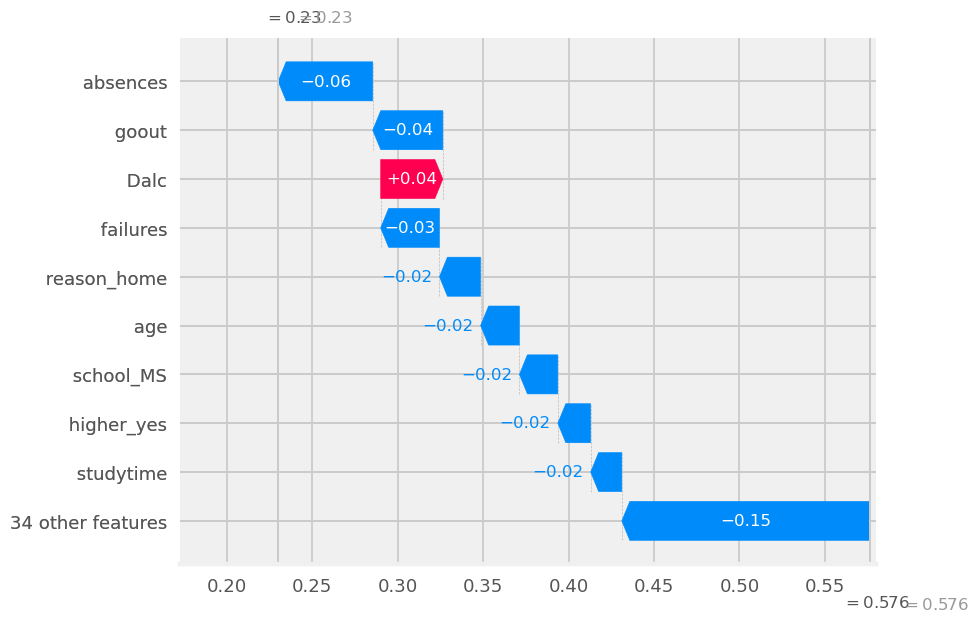

In [305]:
#source: https://towardsdatascience.com/explainable-ai-xai-a-guide-to-7-packages-in-python-to-explain-your-models-932967f0634b
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1],
                                       shap_values=shap_vals_1[i_grp_high_pass].values,
                                      features=X_shap_local.loc[i_grp_high_pass],
                                       show=True)



#### Additional Plots - Decision Plot

- Another visualization to consider is a Decision Plot, which is very similar to a Waterfall plot, but instead of using the ends of block arrows to show the effect of each feature, the cumulative shap value (from bottom to top) are shown as a continuous line.
- The values for each feature are shown in parentheses.
- Unlike the waterfall chart, each features effect is not shown in color. Color reflects the overall shap value.
- Instead, the effect of each feature can be seen in the movement of the line towards the left/right vs the previous feature.

In [306]:
filt_grp_high_all = filt_med_study & filt_higher_yes &filt_hi_drinkers
X_shap_local.loc[filt_grp_high_all]



,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,school_MS,sex_M,address_U,famsize_LE3,Pstatus_T,Mjob_at_home,Mjob_health,Mjob_other,Mjob_services,Mjob_teacher,Fjob_at_home,Fjob_health,Fjob_other,Fjob_services,Fjob_teacher,reason_course,reason_home,reason_other,reason_reputation,guardian_father,guardian_mother,guardian_other,schoolsup_yes,famsup_yes,paid_yes,activities_yes,nursery_yes,higher_yes,internet_yes,romantic_yes
57,18.00,2.00,2.00,2.00,2.00,3.00,3.00,3.00,3.00,5.00,5.00,4.00,9.00,0.00,1.00,1.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,1.00,0.00,1.00,1.00,1.00,0.00
100,17.00,4.00,3.00,2.00,2.00,0.00,4.00,4.00,4.00,4.00,4.00,4.00,0.00,0.00,1.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,0.00
118,16.00,1.00,1.00,2.00,2.00,0.00,5.00,4.00,5.00,4.00,5.00,3.00,0.00,1.00,1.00,1.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00,0.00,1.00
287,17.00,2.00,2.00,1.00,2.00,0.00,4.00,4.00,2.00,5.00,5.00,4.00,0.00,0.00,1.00,1.00,1.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,1.00,1.00


In [307]:
idx_examples_grp_high_Fail



Index([57, 100, 118], dtype='int64')

In [308]:
X_shap_sm = X_shap_local.loc[filt_grp_high_all]
y_shap_sm = y_shap_local.loc[filt_grp_high_all]



In [309]:
## getting ALL group A row #'s'
idx_grp_high= list(filt_grp_high_all[filt_grp_high_all].index)
idx_grp_high



[57, 100, 118, 287]

In [310]:
shap_vals_1_sm = shap_vals_1[idx_grp_high]
shap_vals_1_sm.shape



(4, 43)

In [311]:
idx_examples_grp_high_Pass



Index([287], dtype='int64')

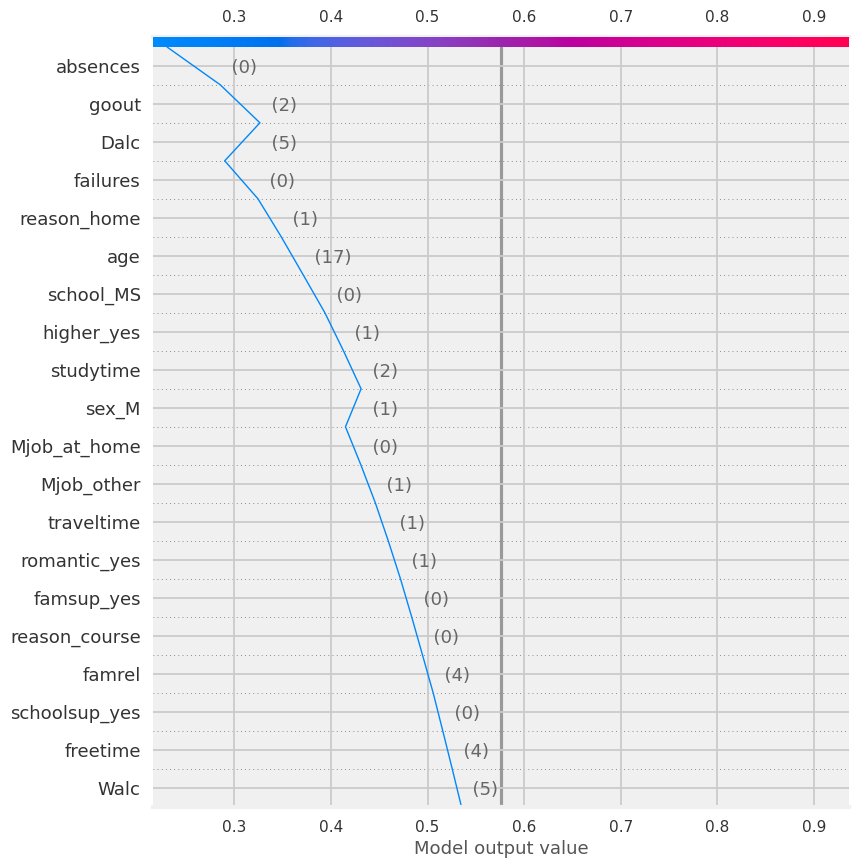

In [312]:
shap.decision_plot(explainer.expected_value[1],
                                       shap_values=shap_vals_1[i_grp_high_pass].values,
                                       features=X_shap_local.loc[i_grp_high_pass])



- For more information on creating the customizing the decision plot, see the following official example

    https://slundberg.github.io/shap/notebooks/plots/decision_plot.html
    
    
**Summary**

In this lesson, we gave a brief introduction to additional plot types included in the shap package. While we will not be using these in your assignments, they are additional options for displaying shap results to stakeholders.

# LIME: Local Explanations


By the end of this lesson students will be able to:

- Explore and explain incorrect predictions from the model
- Select representative example observations to explain.
- Use local explanation tools to convey findings to stakeholders.

## Introducing LIME

LIME (Local Interpretable Model-agnostic Explanations) is another model explanation package. Unlike SHAP, lime is dedicated to local explanations, meaning explaining a single observation.

It has explainers for tabular data, image classification, and text classification.
### How LIME Works

- LIME will explain complex models by calculating small linear models that are built around a specific explanation.
- In their example diagram below:
    - the Pink/Blue shading represents the complex algorithm determined by the machine learning model.
    - The large red plus represents the example it is trying to explain.
    - The dashed line represents a simple linear equation that can be used to explain why the example was classified as red vs blue.
    
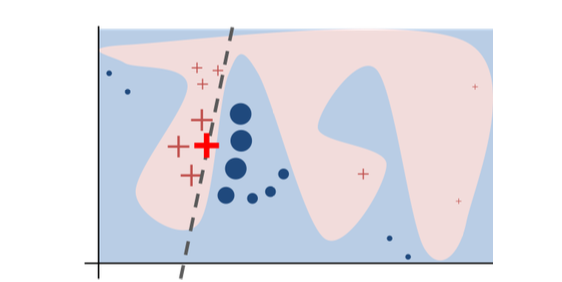

### Using the LimeTabularExplainer

- For our type of data, we will be using the LimeTabularExplainer class.
- Like SHAP, we must first create an instance of an Explainer class.
- Unlike SHAP, the LimeTablulaerExplainer does not require the model itself but does require the following:
    - training_data: the training data as an array (we will use our X_shap dataframe and take the .values to get the array).
    - feature_names: the feature names, which we can take from the columns of our X_shap variable.
    - class_names: the names of our classes (Pass/Fail).
    - mode: which type of model is being explained classification or regression? The default is "classification."
    
    

In [313]:
from lime.lime_tabular import LimeTabularExplainer
lime_explainer =LimeTabularExplainer(
    training_data=X_shap_local.values,  
    feature_names=X_shap_local.columns,
    class_names=['Pass', 'Fail'], 
   mode='classification'
)
lime_explainer



- Then, we will use the explainer's explain_instance method to produce an explanation.
- The explain_instance method requires the following arguments:
    - data_row: The values for a single observation.
    - predict_fn: The predict_proba method from our model.
- We can then use the explanation's show_in_notebook method to display the result.

#### Group high - Failed

In [314]:
example_grp_high_fail.head()



age          18.00
Medu          2.00
Fedu          2.00
traveltime    2.00
studytime     2.00
Name: 57, dtype: float64

In [315]:
exp = lime_explainer.explain_instance(example_grp_high_fail, rf_clf.predict_proba)
exp.show_in_notebook()



- Note that the displayed result is actually HTML and not an image.
- The explanation can also export a list of the values used above using .as_list(), as well as the bar graph using .as_pyplot_figure().
    - However, neither of these will look nearly as good as the HTML version above.

In [316]:
## getting the explanation values as a list
exp_df = pd.DataFrame(exp.as_list(),columns=['Effect','Value'])
exp_df



,Effect,Value
0,failures > 0.00,0.18
1,absences > 6.00,0.07
2,Dalc > 2.00,0.07
3,school_MS <= 0.00,-0.06
4,Fjob_teacher <= 0.00,0.05
5,Mjob_at_home <= 0.00,-0.05
6,Medu <= 2.00,0.04
7,schoolsup_yes <= 0.00,-0.04
8,0.00 < sex_M <= 1.00,0.03
9,reason_course <= 0.00,-0.03


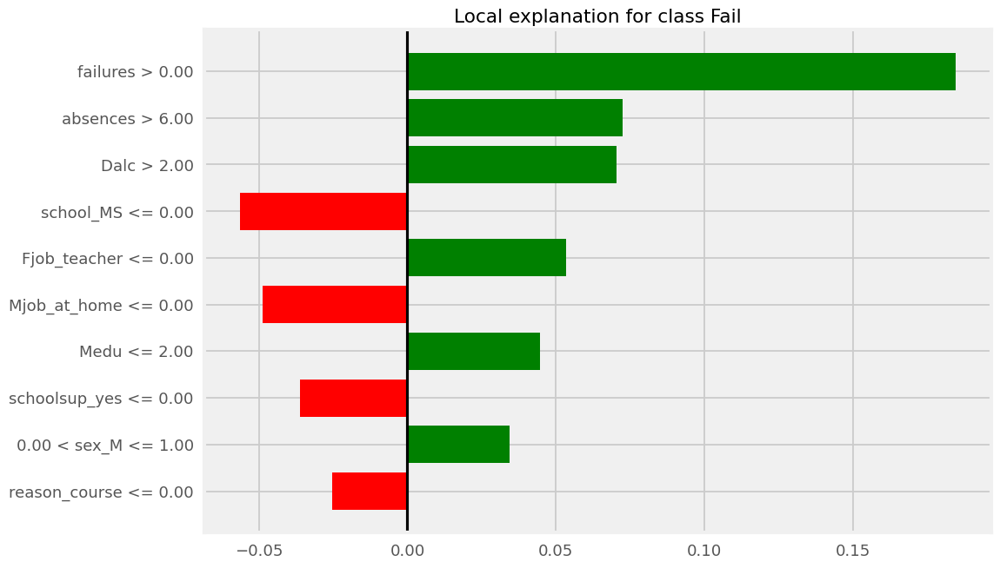

In [317]:
## getting the explanation barplot as a matplotlib figure
fig =exp.as_pyplot_figure();
axes = fig.get_axes()
axes[0].axvline(0,color='k');


Interpreting a Lime Tabular Explanation

- Let's give an example a lime explanation and discuss its three components.

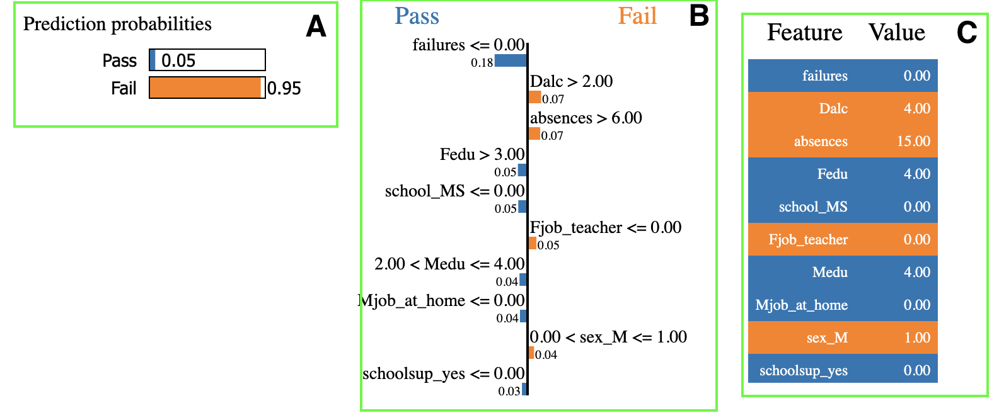

- A (left):
    Probability values for each class from the model's predict_proba.
- B (middle):
    - Bar graph of the contributions for each feature towards the final probability, with the most impactful feature at the top.
    - Each feature is labeled with the probability values used to separate the feature into sub-groups.
    - Features shown in blue are those that negatively influenced predicting the 1 class. These values should will all be to the left of the center line.
    - Features shown in orange are those that positively influenced predicting the 1 class. These values should all be to the right of the center line.
- C (right):
    - The actual original values for each feature for this particular observation.

#### Group high: Failed

In [318]:
exp = lime_explainer.explain_instance(example_grp_high_fail, rf_clf.predict_proba)
exp.show_in_notebook()


- As we can see above, this student from our high-drinkers group had a very high probability of failing.
- While the student several features that were associated with Passing:
    - Mjob_at_home=0
    - school_MS =0
    - Address_U =1
- Three the top 5 most impactful features were associated with Failing:
    - more than 0 failures (they had 3)
    - more than 6 absences (actually had 9 absences),
    - and the fact that they have high weekday alcohol consumption.

#### Group High: Passed

In [319]:
exp = lime_explainer.explain_instance(example_grp_high_pass, rf_clf.predict_proba)
exp.show_in_notebook()


- As we can see above, this student from our high-drinkers group had a high probability of passing.
- While the student several features that were associated with Failing:
    - Dalc >2 (was 5)
    - Medu <=2
    - 0<sex_M<=1 (meaning they were male).

- 4 out of out of the top 5 features were associated with passing:
    - failures<=0
    - absences<=0
    - school_MS<=0 (meaning school=GP)
    - Mjob_at_home <=0
    
    
#### Your Turn

Now that we've walked through the first 2 examples together, take a few minutes to interpret the final 2 examples on your own.

**Group Low: Failed**


In [320]:
exp = lime_explainer.explain_instance(example_grp_low_fail, rf_clf.predict_proba)
exp.show_in_notebook()


- Which features were associated with Failing?
- Which features were associated with Passing?

**Group Low: Passed**

In [321]:
exp = lime_explainer.explain_instance(example_grp_low_pass, rf_clf.predict_proba)
exp.show_in_notebook()


- Which features were associated with Failing?
- Which features were associated with Passing?


**Summary**

In this lesson, we learned how to apply LIME's tabular explainer to explain our machine learning model's predictions for single observations. We walked through an example of carefully selecting observations that allowed us to explore pertinent examples for our stakeholder's business problem. 